In [3]:
!pip install ngram

In [1]:
import numpy as np 
import pandas as pd 
import json
import os

from top2vec.Top2Vec.top2vec import Top2Vec

/home/keen/.pyenv/versions/3.9.13/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2025-10-13 16:13:20.943584: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1760361200.956254 1097715 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1760361200.960058 1097715 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1760361200.970048 1097715 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than o

In [2]:
import torch
import evaluate
from transformers import AutoModelForSequenceClassification, TrainingArguments, Trainer
from nltk.tokenize import sent_tokenize
from tqdm import tqdm, trange
from transformers import AutoTokenizer
from transformers import DataCollatorWithPadding
import tarfile
import ngram

device = "cpu"

accuracy = evaluate.load("accuracy")

model = AutoModelForSequenceClassification.from_pretrained(
    "segm_model/my_model", num_labels=4)

import numpy as np

def compute_metrics(eval_pred):
    predictions, labels = eval_pred
    predictions = np.argmax(predictions, axis=1)
#    return accuracy.compute(predictions=predictions, references=labels)
    return f1.compute(predictions=predictions, references=labels, average='macro')


tokenizer = AutoTokenizer.from_pretrained("xlm-roberta-large")
data_collator = DataCollatorWithPadding(tokenizer=tokenizer, return_tensors = 'pt')

training_args = TrainingArguments(
    output_dir="segm_model/my_model",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=8,
    weight_decay=0.01,
    no_cuda=True
)

trainer = Trainer(
    model=model,
    args=training_args,
    #train_dataset=tokenized_ds["train"],
    #eval_dataset=tokenized_ds["test"],
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)


def remove_trash(txt_):
    txts = []
    texts = sent_tokenize(txt_)
    for txt in texts:
        tokens = tokenizer(txt, truncation=True)
        predictions = trainer.predict([tokens])
        lbl = np.argmax(predictions.predictions, axis=-1)
        if lbl != 1:
            txts.append(txt)
    return " ".join(txts)        
            
def grab_arxiv_txt(titles):
    titles = {t[:t.find("|")].lower().strip() for t in titles}
    G = ngram.NGram(titles)

    arx_dir = "/data2/arxiv"
    arh = "2030_arxiv_json_dump.tar.gz"

    to_extract = {}
    datas = {}
    cntr202 = 0
    try:
        with tarfile.open(os.path.join(arx_dir, arh), 'r:gz') as tar:
            for member in tqdm(tar):
                if member.isfile():
                    if member.name.endswith(".json"):
                        file_obj = tar.extractfile(member)
                        meta_str = file_obj.read().decode("utf-8")
                        meta = json.loads(meta_str)["meta"]
                        name = member.name[member.name.rfind("/")+1:member.name.rfind(".json")]
                        if "202" in meta:
                            cntr202 += 1
                            title_res = G.search(meta["202"].lower().strip(), threshold=0.7)
                            if len(title_res) > 0:
                                to_extract[name] = title_res[0][0]    
        print(len(to_extract), cntr202)                        
        with tarfile.open(os.path.join(arx_dir, arh), 'r:gz') as tar:
            for member in tqdm(tar):
                if member.isfile():
                    if member.name.endswith(".txt"):     
                        name = member.name[member.name.rfind("/")+1:member.name.rfind(".txt")]
                        if name in to_extract:
                            file_obj = tar.extractfile(member)
                            if file_obj:
                                content = file_obj.read().decode("utf-8")    
                                datas[to_extract[name]] = content
                                        
    except Exception as e:
        print(e)
    return datas

def preprocess_reviews(fname): 
    df = pd.read_excel(fname)
    dat = []
    j = 0
    titles = df["title"].to_list()
    content = grab_arxiv_txt(titles)
    for i, row in tqdm(df.iterrows()):
        text = content.get(row["title"][:row["title"].find("|")].lower().strip(),"")
        text = text.replace("Published as a conference paper at ICLR "," ")    
        text = text.replace("Under review as a conference paper at ICLR "," ").replace("\n"," ")    
        if len(text) < 1:
            text = row["title"][:row["title"].find("|")]
        dat.append([i,row['rate'],row["title"][:row["title"].find("|")],row["title"][:row["title"].find("|")] + " " + remove_trash(row["review"]),text])
        # if j > 100:
        #     break
        j += 1
    return pd.DataFrame(dat,columns=("id","score","title","review","text"))

def getTexts(cell):
    res = []
    for i in range(len(cell)):
        c = cell[i]['content']
        res.append(c[c.find("Summary") + 7:])
    return res    

def preprocess_westlake():
    df = pd.read_json(path_or_buf="train.jsonl", lines=True)
    for i, row in df.iterrows():
        texts = getTexts(row["review_contexts"])
        for t in texts:
            dat.append([i,row["title"] + " " + remove_trash(t)])    

    return pd.DataFrame(dat,columns=("id","text"))    
    

/home/keen/.pyenv/versions/3.9.13/lib/python3.9/site-packages/transformers/training_args.py:1604: FutureWarning: using `no_cuda` is deprecated and will be removed in version 5.0 of 🤗 Transformers. Use `use_cpu` instead
  warnings.warn(
/tmp/ipykernel_1097715/1811670562.py:40: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


# ICLR 2019

In [3]:
rews = preprocess_reviews("tp_2019conference.xlsx")

4019617it [2:38:16, 423.27it/s]


890 2009790


4019617it [10:21, 6465.85it/s] 
0it [00:00, ?it/s]

1it [00:20, 20.13s/it]

2it [00:22,  9.49s/it]

3it [00:25,  6.63s/it]

4it [00:28,  5.16s/it]

5it [00:28,  3.52s/it]

6it [00:30,  2.99s/it]

7it [00:34,  3.22s/it]

8it [00:37,  3.14s/it]

9it [00:37,  2.26s/it]

10it [00:40,  2.51s/it]

11it [00:41,  2.00s/it]

12it [00:47,  3.22s/it]

13it [00:51,  3.34s/it]

14it [00:52,  2.71s/it]

15it [00:55,  2.80s/it]

16it [01:03,  4.23s/it]

17it [01:06,  4.04s/it]

18it [01:09,  3.65s/it]

19it [01:12,  3.30s/it]

20it [01:15,  3.32s/it]

21it [01:17,  2.99s/it]

22it [01:23,  3.75s/it]

23it [01:29,  4.50s/it]

24it [01:30,  3.36s/it]

25it [01:30,  2.56s/it]

26it [01:42,  5.18s/it]

27it [01:44,  4.35s/it]

28it [01:45,  3.31s/it]

29it [01:47,  2.98s/it]

30it [01:48,  2.42s/it]

31it [01:50,  2.37s/it]

32it [01:53,  2.52s/it]

33it [01:56,  2.55s/it]

34it [02:01,  3.19s/it]

35it [02:03,  2.87s/it]

36it [02:08,  3.66s/it]

37it [02:15,  4.68s/it]

38it [02:17,  3.70s/it]

39it [02:19,  3.17s/it]

40it [02:22,  3.26s/it]

41it [02:25,  3.06s/it]

42it [02:27,  2.92s/it]

43it [02:29,  2.50s/it]

44it [02:33,  3.04s/it]

45it [02:35,  2.62s/it]

46it [02:37,  2.53s/it]

47it [02:39,  2.46s/it]

48it [02:41,  2.18s/it]

49it [02:43,  2.14s/it]

50it [02:45,  2.23s/it]

51it [02:49,  2.55s/it]

52it [02:52,  2.63s/it]

53it [02:53,  2.31s/it]

54it [02:57,  2.75s/it]

55it [03:06,  4.56s/it]

56it [03:09,  4.28s/it]

57it [03:11,  3.57s/it]

58it [03:12,  2.74s/it]

59it [03:16,  3.11s/it]

60it [03:18,  2.69s/it]

61it [03:21,  2.82s/it]

62it [03:26,  3.45s/it]

63it [03:27,  2.83s/it]

64it [03:29,  2.58s/it]

65it [03:36,  3.85s/it]

66it [03:38,  3.32s/it]

67it [03:39,  2.75s/it]

68it [03:41,  2.27s/it]

69it [03:44,  2.65s/it]

70it [03:50,  3.68s/it]

71it [03:51,  2.76s/it]

72it [03:53,  2.57s/it]

73it [03:55,  2.56s/it]

74it [03:56,  2.02s/it]

75it [03:57,  1.60s/it]

76it [03:59,  1.91s/it]

77it [04:04,  2.77s/it]

78it [04:09,  3.28s/it]

79it [04:12,  3.37s/it]

80it [04:13,  2.63s/it]

81it [04:17,  2.88s/it]

82it [04:18,  2.44s/it]

83it [04:19,  1.99s/it]

84it [04:22,  2.32s/it]

85it [04:25,  2.62s/it]

86it [04:31,  3.64s/it]

87it [04:35,  3.63s/it]

88it [04:44,  5.37s/it]

89it [04:46,  4.25s/it]

90it [04:47,  3.18s/it]

91it [04:51,  3.51s/it]

92it [04:57,  4.08s/it]

93it [04:59,  3.57s/it]

94it [05:01,  3.23s/it]

95it [05:04,  3.18s/it]

96it [05:06,  2.81s/it]

97it [05:08,  2.43s/it]

98it [05:09,  2.11s/it]

99it [05:11,  1.99s/it]

100it [05:16,  2.89s/it]

101it [05:18,  2.76s/it]

102it [05:20,  2.30s/it]

103it [05:21,  2.17s/it]

104it [05:26,  2.86s/it]

105it [05:28,  2.73s/it]

106it [05:35,  3.87s/it]

107it [05:40,  4.23s/it]

108it [05:43,  3.76s/it]

109it [05:44,  3.19s/it]

110it [05:50,  3.74s/it]

111it [05:51,  2.94s/it]

112it [05:51,  2.28s/it]

113it [05:53,  2.01s/it]

114it [05:54,  1.82s/it]

115it [05:55,  1.66s/it]

116it [05:58,  2.08s/it]

117it [06:05,  3.40s/it]

118it [06:07,  3.01s/it]

119it [06:10,  3.09s/it]

120it [06:11,  2.42s/it]

121it [06:13,  2.12s/it]

122it [06:15,  2.14s/it]

123it [06:17,  2.07s/it]

124it [06:20,  2.56s/it]

125it [06:21,  2.02s/it]

126it [06:24,  2.18s/it]

127it [06:24,  1.71s/it]

128it [06:27,  2.11s/it]

129it [06:30,  2.24s/it]

130it [06:32,  2.34s/it]

131it [06:36,  2.58s/it]

132it [06:40,  3.06s/it]

133it [06:42,  2.70s/it]

134it [06:42,  2.09s/it]

135it [06:52,  4.25s/it]

136it [06:55,  3.93s/it]

137it [06:56,  3.19s/it]

138it [06:59,  2.96s/it]

139it [07:01,  2.84s/it]

140it [07:04,  2.89s/it]

141it [07:06,  2.68s/it]

142it [07:10,  2.82s/it]

143it [07:11,  2.54s/it]

144it [07:12,  1.95s/it]

145it [07:14,  1.93s/it]

146it [07:18,  2.67s/it]

147it [07:21,  2.63s/it]

148it [07:21,  1.91s/it]

149it [07:27,  2.99s/it]

150it [07:28,  2.63s/it]

151it [07:31,  2.49s/it]

152it [07:35,  3.22s/it]

153it [07:40,  3.65s/it]

154it [07:42,  3.14s/it]

155it [07:45,  3.00s/it]

156it [07:50,  3.52s/it]

157it [07:54,  3.87s/it]

158it [07:56,  3.37s/it]

159it [07:58,  2.86s/it]

160it [08:02,  3.23s/it]

161it [08:04,  2.78s/it]

162it [08:07,  2.88s/it]

163it [08:09,  2.49s/it]

164it [08:11,  2.34s/it]

165it [08:12,  1.94s/it]

166it [08:13,  1.87s/it]

167it [08:14,  1.65s/it]

168it [08:18,  2.26s/it]

169it [08:21,  2.37s/it]

170it [08:23,  2.21s/it]

171it [08:26,  2.44s/it]

172it [08:28,  2.51s/it]

173it [08:30,  2.17s/it]

174it [08:31,  2.09s/it]

175it [08:34,  2.35s/it]

176it [08:37,  2.26s/it]

177it [08:39,  2.39s/it]

178it [08:43,  2.79s/it]

179it [08:45,  2.49s/it]

180it [08:47,  2.45s/it]

181it [08:49,  2.33s/it]

182it [08:53,  2.92s/it]

183it [08:58,  3.43s/it]

184it [09:01,  3.15s/it]

185it [09:03,  2.82s/it]

186it [09:05,  2.62s/it]

187it [09:07,  2.50s/it]

188it [09:08,  2.04s/it]

189it [09:11,  2.21s/it]

190it [09:12,  2.11s/it]

191it [09:14,  1.89s/it]

192it [09:16,  1.98s/it]

193it [09:22,  3.17s/it]

194it [09:24,  2.70s/it]

195it [09:29,  3.51s/it]

196it [09:32,  3.26s/it]

197it [09:35,  3.20s/it]

198it [09:41,  4.00s/it]

199it [09:43,  3.60s/it]

200it [09:45,  3.05s/it]

201it [09:47,  2.71s/it]

202it [09:51,  3.26s/it]

203it [09:53,  2.73s/it]

204it [09:57,  3.15s/it]

205it [10:07,  5.30s/it]

206it [10:09,  4.32s/it]

207it [10:10,  3.36s/it]

208it [10:14,  3.49s/it]

209it [10:16,  2.92s/it]

210it [10:22,  3.83s/it]

211it [10:32,  5.64s/it]

212it [10:33,  4.39s/it]

213it [10:36,  3.89s/it]

214it [10:38,  3.22s/it]

215it [10:38,  2.51s/it]

216it [10:41,  2.41s/it]

217it [10:43,  2.45s/it]

218it [10:44,  1.95s/it]

219it [10:46,  1.97s/it]

220it [10:50,  2.48s/it]

221it [10:50,  1.91s/it]

222it [10:56,  2.95s/it]

223it [11:02,  3.96s/it]

224it [11:04,  3.27s/it]

225it [11:05,  2.84s/it]

226it [11:09,  3.20s/it]

227it [11:11,  2.62s/it]

228it [11:12,  2.23s/it]

229it [11:17,  2.97s/it]

230it [11:18,  2.60s/it]

231it [11:21,  2.50s/it]

232it [11:23,  2.44s/it]

233it [11:24,  2.16s/it]

234it [11:29,  2.93s/it]

235it [11:30,  2.32s/it]

236it [11:38,  4.05s/it]

237it [11:40,  3.27s/it]

238it [11:41,  2.72s/it]

239it [11:43,  2.56s/it]

240it [11:44,  2.08s/it]

241it [11:54,  4.42s/it]

242it [11:58,  4.26s/it]

243it [12:02,  4.29s/it]

244it [12:12,  6.01s/it]

245it [12:15,  5.01s/it]

246it [12:18,  4.34s/it]

247it [12:19,  3.52s/it]

248it [12:21,  2.87s/it]

249it [12:25,  3.39s/it]

250it [12:28,  3.01s/it]

251it [12:30,  2.80s/it]

252it [12:32,  2.63s/it]

253it [12:34,  2.40s/it]

254it [12:35,  2.11s/it]

255it [12:37,  2.00s/it]

256it [12:38,  1.58s/it]

257it [12:40,  1.94s/it]

258it [12:42,  1.76s/it]

259it [12:45,  2.04s/it]

260it [12:46,  1.74s/it]

261it [12:48,  1.92s/it]

262it [12:50,  1.91s/it]

263it [12:51,  1.63s/it]

264it [12:52,  1.66s/it]

265it [12:56,  2.10s/it]

266it [12:56,  1.71s/it]

267it [12:58,  1.70s/it]

268it [13:00,  1.80s/it]

269it [13:02,  1.89s/it]

270it [13:04,  2.00s/it]

271it [13:06,  1.74s/it]

272it [13:06,  1.36s/it]

273it [13:10,  2.22s/it]

274it [13:12,  2.09s/it]

275it [13:14,  1.94s/it]

276it [13:16,  1.91s/it]

277it [13:19,  2.50s/it]

278it [13:21,  2.30s/it]

279it [13:25,  2.75s/it]

280it [13:26,  2.33s/it]

281it [13:29,  2.49s/it]

282it [13:31,  2.23s/it]

283it [13:34,  2.47s/it]

284it [13:37,  2.75s/it]

285it [13:38,  2.13s/it]

286it [13:41,  2.29s/it]

287it [13:41,  1.77s/it]

288it [13:43,  1.67s/it]

289it [13:48,  2.75s/it]

290it [13:50,  2.55s/it]

291it [13:52,  2.23s/it]

292it [13:55,  2.52s/it]

293it [13:58,  2.83s/it]

294it [14:00,  2.53s/it]

295it [14:03,  2.73s/it]

296it [14:06,  2.63s/it]

297it [14:11,  3.46s/it]

298it [14:14,  3.23s/it]

299it [14:17,  3.21s/it]

300it [14:18,  2.46s/it]

301it [14:25,  3.97s/it]

302it [14:30,  4.30s/it]

303it [14:34,  4.21s/it]

304it [14:37,  3.83s/it]

305it [14:41,  3.85s/it]

306it [14:42,  2.99s/it]

307it [14:44,  2.74s/it]

308it [14:46,  2.51s/it]

309it [14:47,  2.01s/it]

310it [14:52,  3.03s/it]

311it [14:56,  3.19s/it]

312it [15:00,  3.44s/it]

313it [15:02,  2.96s/it]

314it [15:04,  2.82s/it]

315it [15:06,  2.45s/it]

316it [15:07,  2.07s/it]

317it [15:13,  3.19s/it]

318it [15:15,  3.01s/it]

319it [15:20,  3.59s/it]

320it [15:22,  2.91s/it]

321it [15:24,  2.76s/it]

322it [15:26,  2.37s/it]

323it [15:29,  2.81s/it]

324it [15:33,  2.93s/it]

325it [15:35,  2.62s/it]

326it [15:37,  2.56s/it]

327it [15:40,  2.76s/it]

328it [15:43,  2.80s/it]

329it [15:47,  3.27s/it]

330it [15:50,  3.20s/it]

331it [15:52,  2.61s/it]

332it [15:57,  3.48s/it]

333it [15:59,  2.97s/it]

334it [16:00,  2.42s/it]

335it [16:04,  2.77s/it]

336it [16:05,  2.29s/it]

337it [16:08,  2.66s/it]

338it [16:11,  2.58s/it]

339it [16:16,  3.31s/it]

340it [16:18,  3.06s/it]

341it [16:21,  2.85s/it]

342it [16:21,  2.24s/it]

343it [16:23,  1.88s/it]

344it [16:25,  2.14s/it]

345it [16:29,  2.56s/it]

346it [16:31,  2.56s/it]

347it [16:36,  3.04s/it]

348it [16:39,  3.15s/it]

349it [16:42,  3.27s/it]

350it [16:45,  3.06s/it]

351it [16:48,  2.90s/it]

352it [16:50,  2.83s/it]

353it [16:55,  3.30s/it]

354it [16:58,  3.17s/it]

355it [17:02,  3.56s/it]

356it [17:03,  2.68s/it]

357it [17:04,  2.28s/it]

358it [17:07,  2.49s/it]

359it [17:08,  1.99s/it]

360it [17:09,  1.81s/it]

361it [17:12,  2.00s/it]

362it [17:13,  1.68s/it]

363it [17:13,  1.39s/it]

364it [17:18,  2.40s/it]

365it [17:24,  3.57s/it]

366it [17:25,  2.82s/it]

367it [17:28,  2.72s/it]

368it [17:33,  3.40s/it]

369it [17:35,  3.04s/it]

370it [17:38,  2.93s/it]

371it [17:42,  3.44s/it]

372it [17:44,  2.79s/it]

373it [17:46,  2.65s/it]

374it [17:50,  3.10s/it]

375it [17:57,  4.15s/it]

376it [17:59,  3.59s/it]

377it [18:02,  3.33s/it]

378it [18:05,  3.20s/it]

379it [18:05,  2.45s/it]

380it [18:08,  2.58s/it]

381it [18:10,  2.50s/it]

382it [18:12,  2.29s/it]

383it [18:13,  1.91s/it]

384it [18:16,  2.02s/it]

385it [18:17,  1.78s/it]

386it [18:19,  1.76s/it]

387it [18:22,  2.28s/it]

388it [18:24,  2.17s/it]

389it [18:26,  2.18s/it]

390it [18:29,  2.50s/it]

391it [18:35,  3.37s/it]

392it [18:35,  2.47s/it]

393it [18:39,  2.74s/it]

394it [18:41,  2.74s/it]

395it [18:44,  2.67s/it]

396it [18:45,  2.38s/it]

397it [18:50,  2.89s/it]

398it [18:53,  2.95s/it]

399it [18:55,  2.90s/it]

400it [19:00,  3.55s/it]

401it [19:04,  3.69s/it]

402it [19:07,  3.19s/it]

403it [19:10,  3.15s/it]

404it [19:15,  3.69s/it]

405it [19:17,  3.41s/it]

406it [19:19,  2.96s/it]

407it [19:21,  2.55s/it]

408it [19:23,  2.45s/it]

409it [19:27,  3.06s/it]

410it [19:29,  2.56s/it]

411it [19:32,  2.60s/it]

412it [19:33,  2.32s/it]

413it [19:35,  2.26s/it]

414it [19:39,  2.63s/it]

415it [19:40,  2.05s/it]

416it [19:41,  1.83s/it]

417it [19:44,  2.21s/it]

418it [19:45,  1.87s/it]

419it [19:50,  2.80s/it]

420it [19:51,  2.21s/it]

421it [19:56,  3.15s/it]

422it [20:00,  3.46s/it]

423it [20:05,  3.91s/it]

424it [20:06,  2.89s/it]

425it [20:07,  2.25s/it]

426it [20:13,  3.53s/it]

427it [20:14,  2.61s/it]

428it [20:16,  2.40s/it]

429it [20:19,  2.65s/it]

430it [20:25,  3.61s/it]

431it [20:28,  3.69s/it]

432it [20:31,  3.44s/it]

433it [20:32,  2.57s/it]

434it [20:34,  2.49s/it]

435it [20:36,  2.25s/it]

436it [20:42,  3.32s/it]

437it [20:46,  3.55s/it]

438it [20:51,  4.04s/it]

439it [20:54,  3.68s/it]

440it [20:57,  3.43s/it]

441it [20:58,  2.89s/it]

442it [21:00,  2.58s/it]

443it [21:06,  3.69s/it]

444it [21:09,  3.49s/it]

445it [21:12,  3.33s/it]

446it [21:18,  3.87s/it]

447it [21:19,  3.27s/it]

448it [21:24,  3.55s/it]

449it [21:28,  3.84s/it]

450it [21:31,  3.52s/it]

451it [21:33,  3.07s/it]

452it [21:38,  3.56s/it]

453it [21:42,  3.96s/it]

454it [21:46,  3.87s/it]

455it [21:47,  3.05s/it]

456it [21:53,  3.92s/it]

457it [21:56,  3.45s/it]

458it [22:00,  3.68s/it]

459it [22:02,  3.29s/it]

460it [22:05,  3.13s/it]

461it [22:08,  3.12s/it]

462it [22:10,  2.83s/it]

463it [22:13,  2.88s/it]

464it [22:17,  3.06s/it]

465it [22:20,  3.15s/it]

466it [22:22,  2.85s/it]

467it [22:23,  2.15s/it]

468it [22:26,  2.62s/it]

469it [22:29,  2.47s/it]

470it [22:32,  2.64s/it]

471it [22:36,  3.04s/it]

472it [22:37,  2.64s/it]

473it [22:41,  2.91s/it]

474it [22:45,  3.39s/it]

475it [22:51,  4.04s/it]

476it [22:56,  4.35s/it]

477it [22:59,  3.81s/it]

478it [23:01,  3.41s/it]

479it [23:03,  2.99s/it]

480it [23:05,  2.76s/it]

481it [23:10,  3.25s/it]

482it [23:15,  3.77s/it]

483it [23:18,  3.63s/it]

484it [23:19,  2.80s/it]

485it [23:21,  2.55s/it]

486it [23:21,  1.98s/it]

487it [23:28,  3.38s/it]

488it [23:30,  3.03s/it]

489it [23:32,  2.65s/it]

490it [23:38,  3.57s/it]

491it [23:39,  2.85s/it]

492it [23:40,  2.38s/it]

493it [23:42,  2.35s/it]

494it [23:44,  2.26s/it]

495it [23:51,  3.44s/it]

496it [23:52,  2.90s/it]

497it [23:54,  2.65s/it]

498it [23:57,  2.71s/it]

499it [24:00,  2.62s/it]

500it [24:00,  2.08s/it]

501it [24:02,  1.99s/it]

502it [24:04,  1.84s/it]

503it [24:06,  1.84s/it]

504it [24:09,  2.23s/it]

505it [24:10,  1.81s/it]

506it [24:12,  2.10s/it]

507it [24:18,  3.28s/it]

508it [24:22,  3.30s/it]

509it [24:23,  2.55s/it]

510it [24:24,  2.29s/it]

511it [24:28,  2.74s/it]

512it [24:29,  2.37s/it]

513it [24:33,  2.80s/it]

514it [24:36,  2.81s/it]

515it [24:37,  2.20s/it]

516it [24:40,  2.32s/it]

517it [24:42,  2.37s/it]

518it [24:47,  3.12s/it]

519it [24:47,  2.34s/it]

520it [24:49,  2.03s/it]

521it [24:51,  2.00s/it]

522it [24:54,  2.47s/it]

523it [24:58,  2.92s/it]

524it [25:02,  3.06s/it]

525it [25:06,  3.49s/it]

526it [25:10,  3.67s/it]

527it [25:11,  2.94s/it]

528it [25:12,  2.26s/it]

529it [25:15,  2.57s/it]

530it [25:16,  1.98s/it]

531it [25:19,  2.27s/it]

532it [25:22,  2.49s/it]

533it [25:23,  2.05s/it]

534it [25:26,  2.38s/it]

535it [25:28,  2.30s/it]

536it [25:29,  2.00s/it]

537it [25:36,  3.28s/it]

538it [25:40,  3.58s/it]

539it [25:42,  3.17s/it]

540it [25:44,  2.85s/it]

541it [25:46,  2.57s/it]

542it [25:48,  2.26s/it]

543it [25:49,  1.91s/it]

544it [25:55,  3.24s/it]

545it [25:58,  3.02s/it]

546it [25:59,  2.60s/it]

547it [26:04,  3.25s/it]

548it [26:07,  3.03s/it]

549it [26:08,  2.62s/it]

550it [26:12,  2.84s/it]

551it [26:15,  2.96s/it]

552it [26:18,  2.93s/it]

553it [26:22,  3.26s/it]

554it [26:25,  3.26s/it]

555it [26:30,  3.78s/it]

556it [26:32,  3.36s/it]

557it [26:34,  2.85s/it]

558it [26:35,  2.42s/it]

559it [26:40,  3.08s/it]

560it [26:44,  3.20s/it]

561it [26:47,  3.35s/it]

562it [26:50,  3.09s/it]

563it [26:55,  3.82s/it]

564it [26:59,  3.72s/it]

565it [27:02,  3.68s/it]

566it [27:04,  3.11s/it]

567it [27:08,  3.27s/it]

568it [27:10,  2.95s/it]

569it [27:13,  2.95s/it]

570it [27:15,  2.68s/it]

571it [27:20,  3.24s/it]

572it [27:21,  2.63s/it]

573it [27:23,  2.42s/it]

574it [27:25,  2.45s/it]

575it [27:28,  2.43s/it]

576it [27:32,  3.02s/it]

577it [27:36,  3.27s/it]

578it [27:37,  2.75s/it]

579it [27:41,  3.08s/it]

580it [27:43,  2.82s/it]

581it [27:47,  3.05s/it]

582it [27:49,  2.69s/it]

583it [27:49,  2.06s/it]

584it [27:52,  2.20s/it]

585it [27:55,  2.56s/it]

586it [27:59,  2.96s/it]

587it [28:02,  2.73s/it]

588it [28:03,  2.34s/it]

589it [28:04,  1.98s/it]

590it [28:06,  1.98s/it]

591it [28:08,  1.92s/it]

592it [28:12,  2.46s/it]

593it [28:14,  2.33s/it]

594it [28:17,  2.72s/it]

595it [28:22,  3.23s/it]

596it [28:25,  3.40s/it]

597it [28:27,  2.97s/it]

598it [28:33,  3.73s/it]

599it [28:39,  4.38s/it]

600it [28:41,  3.70s/it]

601it [28:43,  3.32s/it]

602it [28:47,  3.28s/it]

603it [28:49,  2.97s/it]

604it [28:53,  3.43s/it]

605it [29:00,  4.27s/it]

606it [29:02,  3.83s/it]

607it [29:08,  4.53s/it]

608it [29:12,  4.12s/it]

609it [29:17,  4.47s/it]

610it [29:20,  4.20s/it]

611it [29:22,  3.54s/it]

612it [29:24,  2.84s/it]

613it [29:31,  4.16s/it]

614it [29:33,  3.63s/it]

615it [29:35,  2.90s/it]

616it [29:36,  2.43s/it]

617it [29:36,  1.86s/it]

618it [29:40,  2.44s/it]

619it [29:43,  2.46s/it]

620it [29:47,  2.94s/it]

621it [29:52,  3.54s/it]

622it [29:55,  3.52s/it]

623it [29:56,  2.86s/it]

624it [30:00,  2.94s/it]

625it [30:01,  2.39s/it]

626it [30:06,  3.22s/it]

627it [30:08,  2.99s/it]

628it [30:14,  3.72s/it]

629it [30:16,  3.29s/it]

630it [30:19,  3.22s/it]

631it [30:22,  3.20s/it]

632it [30:23,  2.53s/it]

633it [30:25,  2.44s/it]

634it [30:28,  2.44s/it]

635it [30:30,  2.20s/it]

636it [30:31,  1.89s/it]

637it [30:33,  2.17s/it]

638it [30:35,  2.10s/it]

639it [30:38,  2.37s/it]

640it [30:43,  3.00s/it]

641it [30:47,  3.44s/it]

642it [30:50,  3.16s/it]

643it [30:51,  2.64s/it]

644it [30:53,  2.41s/it]

645it [30:55,  2.16s/it]

646it [30:59,  2.93s/it]

647it [31:03,  3.13s/it]

648it [31:05,  2.76s/it]

649it [31:08,  2.89s/it]

650it [31:10,  2.52s/it]

651it [31:12,  2.49s/it]

652it [31:13,  2.04s/it]

653it [31:15,  2.08s/it]

654it [31:17,  1.89s/it]

655it [31:21,  2.60s/it]

656it [31:23,  2.36s/it]

657it [31:26,  2.47s/it]

658it [31:26,  1.95s/it]

659it [31:29,  2.08s/it]

660it [31:32,  2.49s/it]

661it [31:34,  2.36s/it]

662it [31:37,  2.38s/it]

663it [31:45,  4.11s/it]

664it [31:46,  3.35s/it]

665it [31:48,  2.72s/it]

666it [31:55,  4.10s/it]

667it [32:00,  4.37s/it]

668it [32:05,  4.69s/it]

669it [32:07,  3.85s/it]

670it [32:09,  3.32s/it]

671it [32:11,  2.82s/it]

672it [32:15,  3.17s/it]

673it [32:16,  2.67s/it]

674it [32:18,  2.34s/it]

675it [32:22,  2.80s/it]

676it [32:24,  2.46s/it]

677it [32:28,  2.99s/it]

678it [32:30,  2.60s/it]

679it [32:34,  3.08s/it]

680it [32:35,  2.49s/it]

681it [32:39,  3.11s/it]

682it [32:42,  2.87s/it]

683it [32:45,  2.99s/it]

684it [32:48,  2.98s/it]

685it [32:51,  2.92s/it]

686it [32:53,  2.74s/it]

687it [32:58,  3.47s/it]

688it [33:00,  3.01s/it]

689it [33:02,  2.62s/it]

690it [33:04,  2.41s/it]

691it [33:11,  3.77s/it]

692it [33:15,  3.79s/it]

693it [33:15,  2.92s/it]

694it [33:18,  2.85s/it]

695it [33:20,  2.60s/it]

696it [33:21,  2.10s/it]

697it [33:22,  1.77s/it]

698it [33:24,  1.70s/it]

699it [33:26,  1.86s/it]

700it [33:29,  2.37s/it]

701it [33:34,  2.94s/it]

702it [33:35,  2.57s/it]

703it [33:36,  1.87s/it]

704it [33:38,  2.12s/it]

705it [33:40,  2.09s/it]

706it [33:42,  1.85s/it]

707it [33:43,  1.81s/it]

708it [33:47,  2.30s/it]

709it [33:51,  2.92s/it]

710it [33:53,  2.52s/it]

711it [34:00,  3.97s/it]

712it [34:04,  3.95s/it]

713it [34:08,  4.01s/it]

714it [34:13,  4.21s/it]

715it [34:16,  3.85s/it]

716it [34:18,  3.27s/it]

717it [34:20,  3.01s/it]

718it [34:23,  2.82s/it]

719it [34:25,  2.80s/it]

720it [34:28,  2.73s/it]

721it [34:32,  3.28s/it]

722it [34:37,  3.63s/it]

723it [34:41,  3.88s/it]

724it [34:46,  3.98s/it]

725it [34:48,  3.39s/it]

726it [34:51,  3.41s/it]

727it [34:54,  3.36s/it]

728it [34:58,  3.35s/it]

729it [34:59,  2.87s/it]

730it [35:06,  3.98s/it]

731it [35:08,  3.49s/it]

732it [35:13,  3.91s/it]

733it [35:18,  4.13s/it]

734it [35:19,  3.36s/it]

735it [35:24,  3.87s/it]

736it [35:30,  4.43s/it]

737it [35:32,  3.75s/it]

738it [35:36,  3.77s/it]

739it [35:39,  3.39s/it]

740it [35:48,  5.32s/it]

741it [35:49,  4.03s/it]

742it [35:52,  3.59s/it]

743it [35:54,  3.08s/it]

744it [35:56,  2.75s/it]

745it [35:57,  2.28s/it]

746it [35:59,  2.16s/it]

747it [36:02,  2.34s/it]

748it [36:07,  3.28s/it]

749it [36:10,  3.03s/it]

750it [36:14,  3.42s/it]

751it [36:20,  4.12s/it]

752it [36:26,  4.69s/it]

753it [36:27,  3.75s/it]

754it [36:29,  3.26s/it]

755it [36:33,  3.22s/it]

756it [36:36,  3.45s/it]

757it [36:38,  2.94s/it]

758it [36:40,  2.44s/it]

759it [36:42,  2.30s/it]

760it [36:43,  1.96s/it]

761it [36:45,  1.98s/it]

762it [36:46,  1.80s/it]

763it [36:48,  1.81s/it]

764it [36:52,  2.45s/it]

765it [36:53,  1.95s/it]

766it [36:56,  2.29s/it]

767it [36:58,  2.38s/it]

768it [37:01,  2.59s/it]

769it [37:09,  3.99s/it]

770it [37:09,  2.96s/it]

771it [37:12,  2.79s/it]

772it [37:13,  2.41s/it]

773it [37:15,  2.11s/it]

774it [37:16,  2.03s/it]

775it [37:20,  2.65s/it]

776it [37:26,  3.60s/it]

777it [37:30,  3.49s/it]

778it [37:33,  3.60s/it]

779it [37:35,  2.99s/it]

780it [37:39,  3.21s/it]

781it [37:42,  3.21s/it]

782it [37:46,  3.44s/it]

783it [37:49,  3.27s/it]

784it [37:57,  4.90s/it]

785it [38:00,  4.33s/it]

786it [38:03,  3.77s/it]

787it [38:05,  3.28s/it]

788it [38:12,  4.32s/it]

789it [38:13,  3.33s/it]

790it [38:15,  2.90s/it]

791it [38:18,  2.96s/it]

792it [38:20,  2.74s/it]

793it [38:22,  2.60s/it]

794it [38:26,  3.00s/it]

795it [38:29,  2.83s/it]

796it [38:32,  2.96s/it]

797it [38:38,  3.93s/it]

798it [38:44,  4.45s/it]

799it [38:47,  3.99s/it]

800it [38:49,  3.52s/it]

801it [38:52,  3.46s/it]

802it [38:54,  2.99s/it]

803it [38:56,  2.49s/it]

804it [38:57,  2.02s/it]

805it [39:00,  2.55s/it]

806it [39:02,  2.23s/it]

807it [39:05,  2.45s/it]

808it [39:07,  2.28s/it]

809it [39:09,  2.15s/it]

810it [39:11,  2.35s/it]

811it [39:13,  2.27s/it]

812it [39:15,  1.93s/it]

813it [39:17,  2.04s/it]

814it [39:21,  2.52s/it]

815it [39:23,  2.44s/it]

816it [39:24,  1.93s/it]

817it [39:25,  1.83s/it]

818it [39:28,  2.03s/it]

819it [39:31,  2.35s/it]

820it [39:33,  2.30s/it]

821it [39:36,  2.66s/it]

822it [39:40,  2.97s/it]

823it [39:46,  3.97s/it]

824it [39:49,  3.57s/it]

825it [39:52,  3.26s/it]

826it [39:56,  3.55s/it]

827it [39:59,  3.36s/it]

828it [40:01,  3.16s/it]

829it [40:03,  2.74s/it]

830it [40:05,  2.45s/it]

831it [40:09,  2.99s/it]

832it [40:12,  3.06s/it]

833it [40:13,  2.42s/it]

834it [40:16,  2.47s/it]

835it [40:19,  2.65s/it]

836it [40:22,  2.89s/it]

837it [40:26,  2.97s/it]

838it [40:28,  2.72s/it]

839it [40:30,  2.45s/it]

840it [40:31,  2.09s/it]

841it [40:31,  1.63s/it]

842it [40:34,  1.97s/it]

843it [40:37,  2.13s/it]

844it [40:39,  2.23s/it]

845it [40:41,  2.17s/it]

846it [40:42,  1.69s/it]

847it [40:44,  1.94s/it]

848it [40:45,  1.62s/it]

849it [40:47,  1.68s/it]

850it [40:48,  1.59s/it]

851it [40:52,  2.34s/it]

852it [40:55,  2.30s/it]

853it [40:57,  2.23s/it]

854it [40:58,  1.89s/it]

855it [41:00,  2.14s/it]

856it [41:04,  2.57s/it]

857it [41:09,  3.27s/it]

858it [41:10,  2.68s/it]

859it [41:12,  2.45s/it]

860it [41:15,  2.67s/it]

861it [41:18,  2.53s/it]

862it [41:22,  3.03s/it]

863it [41:23,  2.50s/it]

864it [41:26,  2.78s/it]

865it [41:29,  2.57s/it]

866it [41:31,  2.58s/it]

867it [41:37,  3.62s/it]

868it [41:39,  3.15s/it]

869it [41:43,  3.39s/it]

870it [41:47,  3.40s/it]

871it [41:52,  4.03s/it]

872it [41:56,  3.86s/it]

873it [41:57,  3.26s/it]

874it [42:01,  3.33s/it]

875it [42:03,  2.91s/it]

876it [42:07,  3.15s/it]

877it [42:09,  2.80s/it]

878it [42:13,  3.28s/it]

879it [42:19,  4.08s/it]

880it [42:22,  3.67s/it]

881it [42:22,  2.84s/it]

882it [42:27,  3.44s/it]

883it [42:32,  3.89s/it]

884it [42:34,  3.33s/it]

885it [42:37,  3.25s/it]

886it [42:40,  3.13s/it]

887it [42:41,  2.53s/it]

888it [42:42,  2.03s/it]

889it [42:47,  2.83s/it]

890it [42:55,  4.34s/it]

891it [42:56,  3.42s/it]

892it [42:57,  2.81s/it]

893it [42:59,  2.35s/it]

894it [43:01,  2.32s/it]

895it [43:04,  2.64s/it]

896it [43:08,  2.93s/it]

897it [43:09,  2.33s/it]

898it [43:11,  2.16s/it]

899it [43:12,  1.96s/it]

900it [43:14,  2.01s/it]

901it [43:18,  2.63s/it]

902it [43:24,  3.59s/it]

903it [43:27,  3.33s/it]

904it [43:31,  3.69s/it]

905it [43:33,  3.08s/it]

906it [43:35,  2.62s/it]

907it [43:39,  3.08s/it]

908it [43:46,  4.46s/it]

909it [43:49,  3.99s/it]

910it [43:52,  3.61s/it]

911it [43:54,  3.21s/it]

912it [43:59,  3.65s/it]

913it [44:02,  3.52s/it]

914it [44:06,  3.67s/it]

915it [44:11,  4.04s/it]

916it [44:14,  3.62s/it]

917it [44:15,  2.81s/it]

918it [44:16,  2.49s/it]

919it [44:19,  2.61s/it]

920it [44:22,  2.77s/it]

921it [44:25,  2.55s/it]

922it [44:27,  2.41s/it]

923it [44:29,  2.33s/it]

924it [44:30,  1.96s/it]

925it [44:32,  2.04s/it]

926it [44:33,  1.82s/it]

927it [44:36,  2.13s/it]

928it [44:46,  4.42s/it]

929it [44:48,  3.74s/it]

930it [44:50,  3.08s/it]

931it [44:53,  3.22s/it]

932it [44:59,  3.85s/it]

933it [45:00,  3.04s/it]

934it [45:02,  2.86s/it]

935it [45:07,  3.52s/it]

936it [45:09,  2.95s/it]

937it [45:12,  2.96s/it]

938it [45:14,  2.77s/it]

939it [45:18,  3.07s/it]

940it [45:23,  3.54s/it]

941it [45:25,  3.35s/it]

942it [45:26,  2.60s/it]

943it [45:28,  2.25s/it]

944it [45:33,  3.16s/it]

945it [45:35,  2.75s/it]

946it [45:36,  2.36s/it]

947it [45:39,  2.49s/it]

948it [45:43,  2.81s/it]

949it [45:44,  2.52s/it]

950it [45:53,  4.27s/it]

951it [45:55,  3.61s/it]

952it [46:00,  3.99s/it]

953it [46:01,  3.10s/it]

954it [46:05,  3.54s/it]

955it [46:07,  2.85s/it]

956it [46:10,  3.07s/it]

957it [46:12,  2.76s/it]

958it [46:14,  2.57s/it]

959it [46:16,  2.15s/it]

960it [46:19,  2.68s/it]

961it [46:22,  2.62s/it]

962it [46:25,  2.70s/it]

963it [46:27,  2.45s/it]

964it [46:28,  2.16s/it]

965it [46:33,  2.89s/it]

966it [46:36,  3.03s/it]

967it [46:40,  3.34s/it]

968it [46:44,  3.48s/it]

969it [46:47,  3.28s/it]

970it [46:49,  2.83s/it]

971it [46:50,  2.26s/it]

972it [46:54,  3.03s/it]

973it [46:58,  3.08s/it]

974it [46:59,  2.60s/it]

975it [47:02,  2.78s/it]

976it [47:04,  2.54s/it]

977it [47:09,  3.24s/it]

978it [47:13,  3.45s/it]

979it [47:15,  3.04s/it]

980it [47:18,  3.05s/it]

981it [47:20,  2.55s/it]

982it [47:23,  2.80s/it]

983it [47:26,  2.75s/it]

984it [47:27,  2.32s/it]

985it [47:30,  2.48s/it]

986it [47:36,  3.67s/it]

987it [47:37,  2.81s/it]

988it [47:39,  2.54s/it]

989it [47:41,  2.29s/it]

990it [47:42,  1.96s/it]

991it [47:44,  1.99s/it]

992it [47:50,  3.37s/it]

993it [47:52,  2.87s/it]

994it [47:56,  3.04s/it]

995it [47:58,  2.78s/it]

996it [48:01,  3.05s/it]

997it [48:04,  3.04s/it]

998it [48:09,  3.55s/it]

999it [48:12,  3.44s/it]

1000it [48:17,  3.85s/it]

1001it [48:23,  4.42s/it]

1002it [48:25,  3.77s/it]

1003it [48:26,  2.87s/it]

1004it [48:28,  2.56s/it]

1005it [48:30,  2.44s/it]

1006it [48:32,  2.45s/it]

1007it [48:35,  2.44s/it]

1008it [48:36,  1.97s/it]

1009it [48:39,  2.23s/it]

1010it [48:41,  2.30s/it]

1011it [48:43,  2.24s/it]

1012it [48:47,  2.79s/it]

1013it [48:49,  2.48s/it]

1014it [48:53,  2.89s/it]

1015it [48:57,  3.39s/it]

1016it [49:00,  3.19s/it]

1017it [49:03,  3.05s/it]

1018it [49:06,  3.14s/it]

1019it [49:07,  2.55s/it]

1020it [49:12,  3.33s/it]

1021it [49:15,  3.02s/it]

1022it [49:18,  3.18s/it]

1023it [49:19,  2.42s/it]

1024it [49:20,  2.03s/it]

1025it [49:21,  1.68s/it]

1026it [49:22,  1.59s/it]

1027it [49:25,  2.02s/it]

1028it [49:27,  1.89s/it]

1029it [49:32,  2.90s/it]

1030it [49:35,  2.98s/it]

1031it [49:37,  2.64s/it]

1032it [49:40,  2.58s/it]

1033it [49:46,  3.67s/it]

1034it [49:48,  3.30s/it]

1035it [49:54,  4.04s/it]

1036it [49:57,  3.73s/it]

1037it [50:01,  3.66s/it]

1038it [50:02,  3.09s/it]

1039it [50:06,  3.18s/it]

1040it [50:12,  4.09s/it]

1041it [50:15,  3.93s/it]

1042it [50:17,  3.13s/it]

1043it [50:21,  3.59s/it]

1044it [50:28,  4.40s/it]

1045it [50:30,  3.70s/it]

1046it [50:31,  3.10s/it]

1047it [50:36,  3.57s/it]

1048it [50:38,  2.98s/it]

1049it [50:39,  2.58s/it]

1050it [50:42,  2.44s/it]

1051it [50:50,  4.35s/it]

1052it [50:53,  3.94s/it]

1053it [50:58,  4.06s/it]

1054it [51:01,  3.91s/it]

1055it [51:04,  3.46s/it]

1056it [51:11,  4.61s/it]

1057it [51:17,  5.02s/it]

1058it [51:21,  4.67s/it]

1059it [51:23,  3.81s/it]

1060it [51:27,  4.14s/it]

1061it [51:30,  3.69s/it]

1062it [51:33,  3.40s/it]

1063it [51:37,  3.50s/it]

1064it [51:44,  4.78s/it]

1065it [51:47,  4.04s/it]

1066it [51:51,  4.14s/it]

1067it [51:56,  4.44s/it]

1068it [51:58,  3.82s/it]

1069it [52:03,  3.90s/it]

1070it [52:05,  3.52s/it]

1071it [52:09,  3.70s/it]

1072it [52:13,  3.63s/it]

1073it [52:15,  3.30s/it]

1074it [52:16,  2.54s/it]

1075it [52:19,  2.59s/it]

1076it [52:21,  2.50s/it]

1077it [52:24,  2.55s/it]

1078it [52:25,  2.29s/it]

1079it [52:27,  1.99s/it]

1080it [52:29,  2.19s/it]

1081it [52:31,  2.06s/it]

1082it [52:32,  1.56s/it]

1083it [52:34,  1.81s/it]

1084it [52:37,  2.11s/it]

1085it [52:38,  1.98s/it]

1086it [52:40,  1.74s/it]

1087it [52:43,  2.35s/it]

1088it [52:47,  2.72s/it]

1089it [52:53,  3.81s/it]

1090it [52:54,  3.02s/it]

1091it [53:00,  3.64s/it]

1092it [53:01,  2.87s/it]

1093it [53:04,  2.94s/it]

1094it [53:06,  2.64s/it]

1095it [53:08,  2.45s/it]

1096it [53:13,  3.23s/it]

1097it [53:14,  2.80s/it]

1098it [53:18,  2.95s/it]

1099it [53:20,  2.68s/it]

1100it [53:23,  2.92s/it]

1101it [53:28,  3.44s/it]

1102it [53:31,  3.33s/it]

1103it [53:35,  3.38s/it]

1104it [53:39,  3.59s/it]

1105it [53:42,  3.61s/it]

1106it [53:45,  3.31s/it]

1107it [53:49,  3.64s/it]

1108it [53:52,  3.36s/it]

1109it [53:54,  2.88s/it]

1110it [54:00,  3.76s/it]

1111it [54:04,  3.85s/it]

1112it [54:06,  3.51s/it]

1113it [54:09,  3.33s/it]

1114it [54:12,  3.03s/it]

1115it [54:12,  2.30s/it]

1116it [54:15,  2.41s/it]

1117it [54:17,  2.25s/it]

1118it [54:21,  2.73s/it]

1119it [54:22,  2.46s/it]

1120it [54:25,  2.52s/it]

1121it [54:27,  2.23s/it]

1122it [54:28,  2.04s/it]

1123it [54:35,  3.51s/it]

1124it [54:38,  3.33s/it]

1125it [54:39,  2.73s/it]

1126it [54:43,  2.96s/it]

1127it [54:44,  2.48s/it]

1128it [54:47,  2.46s/it]

1129it [54:49,  2.39s/it]

1130it [54:53,  2.80s/it]

1131it [54:56,  2.86s/it]

1132it [55:03,  4.04s/it]

1133it [55:04,  3.31s/it]

1134it [55:09,  3.83s/it]

1135it [55:10,  3.06s/it]

1136it [55:16,  3.91s/it]

1137it [55:19,  3.42s/it]

1138it [55:21,  3.24s/it]

1139it [55:23,  2.84s/it]

1140it [55:25,  2.46s/it]

1141it [55:27,  2.25s/it]

1142it [55:40,  5.64s/it]

1143it [55:44,  5.10s/it]

1144it [55:48,  4.68s/it]

1145it [55:50,  3.81s/it]

1146it [55:53,  3.80s/it]

1147it [55:58,  4.19s/it]

1148it [56:04,  4.49s/it]

1149it [56:05,  3.68s/it]

1150it [56:08,  3.41s/it]

1151it [56:09,  2.50s/it]

1152it [56:13,  3.00s/it]

1153it [56:15,  2.82s/it]

1154it [56:19,  3.17s/it]

1155it [56:22,  3.23s/it]

1156it [56:25,  2.94s/it]

1157it [56:30,  3.71s/it]

1158it [56:32,  3.21s/it]

1159it [56:36,  3.52s/it]

1160it [56:37,  2.67s/it]

1161it [56:39,  2.42s/it]

1162it [56:43,  2.95s/it]

1163it [56:46,  2.95s/it]

1164it [56:48,  2.70s/it]

1165it [56:50,  2.43s/it]

1166it [56:51,  1.86s/it]

1167it [56:53,  1.93s/it]

1168it [56:57,  2.77s/it]

1169it [57:01,  3.06s/it]

1170it [57:03,  2.82s/it]

1171it [57:05,  2.49s/it]

1172it [57:07,  2.31s/it]

1173it [57:08,  1.79s/it]

1174it [57:10,  2.02s/it]

1175it [57:11,  1.80s/it]

1176it [57:18,  3.25s/it]

1177it [57:25,  4.34s/it]

1178it [57:28,  4.07s/it]

1179it [57:30,  3.26s/it]

1180it [57:32,  3.01s/it]

1181it [57:35,  3.05s/it]

1182it [57:41,  3.81s/it]

1183it [57:44,  3.52s/it]

1184it [57:46,  3.25s/it]

1185it [57:51,  3.71s/it]

1186it [57:53,  3.23s/it]

1187it [57:56,  3.19s/it]

1188it [57:59,  2.96s/it]

1189it [58:07,  4.56s/it]

1190it [58:09,  3.68s/it]

1191it [58:09,  2.79s/it]

1192it [58:12,  2.80s/it]

1193it [58:14,  2.35s/it]

1194it [58:16,  2.33s/it]

1195it [58:22,  3.44s/it]

1196it [58:26,  3.77s/it]

1197it [58:29,  3.29s/it]

1198it [58:33,  3.50s/it]

1199it [58:37,  3.83s/it]

1200it [58:40,  3.62s/it]

1201it [58:42,  3.12s/it]

1202it [58:46,  3.20s/it]

1203it [58:51,  3.78s/it]

1204it [58:53,  3.22s/it]

1205it [58:58,  3.76s/it]

1206it [59:00,  3.18s/it]

1207it [59:02,  2.90s/it]

1208it [59:03,  2.54s/it]

1209it [59:07,  2.89s/it]

1210it [59:12,  3.51s/it]

1211it [59:13,  2.84s/it]

1212it [59:18,  3.39s/it]

1213it [59:21,  3.38s/it]

1214it [59:24,  3.14s/it]

1215it [59:28,  3.43s/it]

1216it [59:29,  2.79s/it]

1217it [59:32,  2.60s/it]

1218it [59:35,  2.71s/it]

1219it [59:39,  3.14s/it]

1220it [59:43,  3.44s/it]

1221it [59:47,  3.55s/it]

1222it [59:50,  3.41s/it]

1223it [59:54,  3.58s/it]

1224it [59:55,  3.04s/it]

1225it [1:00:09,  6.25s/it]

1226it [1:00:12,  5.32s/it]

1227it [1:00:16,  4.89s/it]

1228it [1:00:22,  5.17s/it]

1229it [1:00:25,  4.40s/it]

1230it [1:00:30,  4.59s/it]

1231it [1:00:33,  4.12s/it]

1232it [1:00:36,  3.95s/it]

1233it [1:00:45,  5.25s/it]

1234it [1:00:47,  4.29s/it]

1235it [1:00:50,  4.07s/it]

1236it [1:00:51,  3.09s/it]

1237it [1:01:00,  4.95s/it]

1238it [1:01:03,  4.14s/it]

1239it [1:01:03,  3.13s/it]

1240it [1:01:07,  3.33s/it]

1241it [1:01:10,  3.09s/it]

1242it [1:01:15,  3.67s/it]

1243it [1:01:18,  3.69s/it]

1244it [1:01:22,  3.78s/it]

1245it [1:01:26,  3.62s/it]

1246it [1:01:29,  3.51s/it]

1247it [1:01:33,  3.75s/it]

1248it [1:01:34,  2.94s/it]

1249it [1:01:38,  3.14s/it]

1250it [1:01:39,  2.66s/it]

1251it [1:01:40,  2.18s/it]

1252it [1:01:42,  2.04s/it]

1253it [1:01:45,  2.32s/it]

1254it [1:01:51,  3.52s/it]

1255it [1:01:55,  3.66s/it]

1256it [1:01:57,  3.14s/it]

1257it [1:02:01,  3.21s/it]

1258it [1:02:03,  2.92s/it]

1259it [1:02:04,  2.39s/it]

1260it [1:02:05,  1.93s/it]

1261it [1:02:08,  2.36s/it]

1262it [1:02:13,  3.18s/it]

1263it [1:02:15,  2.56s/it]

1264it [1:02:17,  2.39s/it]

1265it [1:02:17,  1.95s/it]

1266it [1:02:20,  2.08s/it]

1267it [1:02:21,  1.75s/it]

1268it [1:02:22,  1.45s/it]

1269it [1:02:24,  1.72s/it]

1270it [1:02:26,  1.72s/it]

1271it [1:02:28,  1.85s/it]

1272it [1:02:32,  2.42s/it]

1273it [1:02:40,  4.18s/it]

1274it [1:02:42,  3.46s/it]

1275it [1:02:44,  2.99s/it]

1276it [1:02:45,  2.40s/it]

1277it [1:02:46,  2.21s/it]

1278it [1:02:50,  2.70s/it]

1279it [1:02:51,  2.12s/it]

1280it [1:02:52,  1.67s/it]

1281it [1:02:53,  1.47s/it]

1282it [1:02:55,  1.72s/it]

1283it [1:02:57,  1.70s/it]

1284it [1:02:59,  1.96s/it]

1285it [1:03:03,  2.47s/it]

1286it [1:03:07,  2.95s/it]

1287it [1:03:14,  4.35s/it]

1288it [1:03:16,  3.44s/it]

1289it [1:03:16,  2.53s/it]

1290it [1:03:19,  2.63s/it]

1291it [1:03:21,  2.40s/it]

1292it [1:03:25,  2.84s/it]

1293it [1:03:29,  3.33s/it]

1294it [1:03:34,  3.66s/it]

1295it [1:03:36,  3.23s/it]

1296it [1:03:38,  2.84s/it]

1297it [1:03:40,  2.69s/it]

1298it [1:03:42,  2.53s/it]

1299it [1:03:44,  2.39s/it]

1300it [1:03:47,  2.49s/it]

1301it [1:03:53,  3.54s/it]

1302it [1:03:54,  2.86s/it]

1303it [1:03:58,  2.97s/it]

1304it [1:03:59,  2.39s/it]

1305it [1:04:02,  2.57s/it]

1306it [1:04:04,  2.64s/it]

1307it [1:04:05,  2.16s/it]

1308it [1:04:07,  1.88s/it]

1309it [1:04:08,  1.83s/it]

1310it [1:04:17,  3.95s/it]

1311it [1:04:19,  3.38s/it]

1312it [1:04:20,  2.58s/it]

1313it [1:04:23,  2.80s/it]

1314it [1:04:28,  3.46s/it]

1315it [1:04:35,  4.48s/it]

1316it [1:04:41,  4.87s/it]

1317it [1:04:43,  4.12s/it]

1318it [1:04:47,  3.98s/it]

1319it [1:04:49,  3.38s/it]

1320it [1:04:55,  4.06s/it]

1321it [1:04:59,  4.16s/it]

1322it [1:05:00,  3.26s/it]

1323it [1:05:03,  3.14s/it]

1324it [1:05:08,  3.57s/it]

1325it [1:05:13,  4.20s/it]

1326it [1:05:16,  3.65s/it]

1327it [1:05:18,  3.16s/it]

1328it [1:05:20,  2.97s/it]

1329it [1:05:24,  3.06s/it]

1330it [1:05:25,  2.53s/it]

1331it [1:05:29,  2.92s/it]

1332it [1:05:31,  2.83s/it]

1333it [1:05:37,  3.82s/it]

1334it [1:05:39,  3.29s/it]

1335it [1:05:40,  2.47s/it]

1336it [1:05:41,  2.08s/it]

1337it [1:05:43,  1.89s/it]

1338it [1:05:44,  1.82s/it]

1339it [1:05:49,  2.78s/it]

1340it [1:05:53,  3.12s/it]

1341it [1:05:56,  3.05s/it]

1342it [1:06:00,  3.35s/it]

1343it [1:06:03,  3.29s/it]

1344it [1:06:06,  3.00s/it]

1345it [1:06:07,  2.55s/it]

1346it [1:06:09,  2.42s/it]

1347it [1:06:11,  2.37s/it]

1348it [1:06:19,  3.96s/it]

1349it [1:06:21,  3.34s/it]

1350it [1:06:24,  3.14s/it]

1351it [1:06:25,  2.60s/it]

1352it [1:06:27,  2.47s/it]

1353it [1:06:29,  2.14s/it]

1354it [1:06:34,  3.07s/it]

1355it [1:06:36,  2.94s/it]

1356it [1:06:41,  3.45s/it]

1357it [1:06:44,  3.38s/it]

1358it [1:06:48,  3.44s/it]

1359it [1:06:52,  3.52s/it]

1360it [1:06:53,  3.01s/it]

1361it [1:06:56,  2.75s/it]

1362it [1:06:59,  2.93s/it]

1363it [1:07:08,  4.90s/it]

1364it [1:07:11,  4.28s/it]

1365it [1:07:15,  4.20s/it]

1366it [1:07:21,  4.66s/it]

1367it [1:07:25,  4.56s/it]

1368it [1:07:27,  3.70s/it]

1369it [1:07:33,  4.26s/it]

1370it [1:07:36,  3.86s/it]

1371it [1:07:38,  3.56s/it]

1372it [1:07:40,  2.99s/it]

1373it [1:07:43,  3.08s/it]

1374it [1:07:46,  3.06s/it]

1375it [1:07:49,  3.05s/it]

1376it [1:07:51,  2.52s/it]

1377it [1:07:52,  2.06s/it]

1378it [1:07:57,  3.14s/it]

1379it [1:07:58,  2.28s/it]

1380it [1:07:59,  2.12s/it]

1381it [1:08:02,  2.35s/it]

1382it [1:08:05,  2.52s/it]

1383it [1:08:07,  2.31s/it]

1384it [1:08:08,  2.05s/it]

1385it [1:08:23,  5.97s/it]

1386it [1:08:29,  5.94s/it]

1387it [1:08:31,  4.52s/it]

1388it [1:08:34,  4.12s/it]

1389it [1:08:37,  3.95s/it]

1390it [1:08:39,  3.40s/it]

1391it [1:08:42,  3.01s/it]

1392it [1:08:47,  3.70s/it]

1393it [1:08:49,  3.18s/it]

1394it [1:08:51,  2.76s/it]

1395it [1:08:53,  2.73s/it]

1396it [1:08:58,  3.35s/it]

1397it [1:09:00,  2.86s/it]

1398it [1:09:02,  2.73s/it]

1399it [1:09:06,  3.15s/it]

1400it [1:09:09,  3.04s/it]

1401it [1:09:13,  3.21s/it]

1402it [1:09:14,  2.49s/it]

1403it [1:09:18,  3.17s/it]

1404it [1:09:21,  3.16s/it]

1405it [1:09:23,  2.82s/it]

1406it [1:09:25,  2.30s/it]

1407it [1:09:26,  2.03s/it]

1408it [1:09:32,  3.16s/it]

1409it [1:09:34,  2.80s/it]

1410it [1:09:35,  2.41s/it]

1411it [1:09:37,  2.36s/it]

1412it [1:09:45,  4.06s/it]

1413it [1:09:47,  3.27s/it]

1414it [1:09:50,  3.27s/it]

1415it [1:09:54,  3.37s/it]

1416it [1:09:55,  2.89s/it]

1417it [1:09:57,  2.39s/it]

1418it [1:10:03,  3.59s/it]

1419it [1:10:07,  3.65s/it]

1420it [1:10:08,  2.95s/it]

1421it [1:10:10,  2.59s/it]

1422it [1:10:17,  3.88s/it]

1423it [1:10:19,  3.24s/it]

1424it [1:10:21,  2.86s/it]

1425it [1:10:23,  2.60s/it]

1426it [1:10:28,  3.50s/it]

1427it [1:10:30,  2.93s/it]

1428it [1:10:31,  2.42s/it]

1429it [1:10:32,  1.97s/it]

1430it [1:10:34,  1.90s/it]

1431it [1:10:37,  2.46s/it]

1432it [1:10:39,  2.32s/it]

1433it [1:10:41,  2.21s/it]

1434it [1:10:45,  2.71s/it]

1435it [1:10:49,  3.01s/it]

1436it [1:10:51,  2.86s/it]

1437it [1:10:55,  3.03s/it]

1438it [1:10:57,  2.66s/it]

1439it [1:11:01,  3.04s/it]

1440it [1:11:04,  3.19s/it]

1441it [1:11:08,  3.44s/it]

1442it [1:11:10,  2.94s/it]

1443it [1:11:12,  2.67s/it]

1444it [1:11:14,  2.41s/it]

1445it [1:11:18,  2.88s/it]

1446it [1:11:19,  2.52s/it]

1447it [1:11:20,  2.01s/it]

1448it [1:11:25,  2.88s/it]

1449it [1:11:28,  2.94s/it]

1450it [1:11:31,  2.83s/it]

1451it [1:11:33,  2.68s/it]

1452it [1:11:34,  2.07s/it]

1453it [1:11:43,  4.08s/it]

1454it [1:11:45,  3.73s/it]

1455it [1:11:52,  4.54s/it]

1456it [1:11:54,  3.82s/it]

1457it [1:11:56,  3.20s/it]

1458it [1:11:57,  2.66s/it]

1459it [1:11:59,  2.43s/it]

1460it [1:12:01,  2.40s/it]

1461it [1:12:03,  2.00s/it]

1462it [1:12:04,  1.96s/it]

1463it [1:12:07,  2.21s/it]

1464it [1:12:11,  2.77s/it]

1465it [1:12:12,  2.25s/it]

1466it [1:12:15,  2.26s/it]

1467it [1:12:16,  2.02s/it]

1468it [1:12:18,  1.90s/it]

1469it [1:12:20,  2.13s/it]

1470it [1:12:23,  2.41s/it]

1471it [1:12:25,  2.22s/it]

1472it [1:12:32,  3.75s/it]

1473it [1:12:35,  3.31s/it]

1474it [1:12:39,  3.49s/it]

1475it [1:12:41,  3.29s/it]

1476it [1:12:45,  3.37s/it]

1477it [1:12:52,  4.33s/it]

1478it [1:12:53,  3.57s/it]

1479it [1:12:58,  4.00s/it]

1480it [1:13:01,  3.68s/it]

1481it [1:13:05,  3.72s/it]

1482it [1:13:07,  3.27s/it]

1483it [1:13:14,  4.14s/it]

1484it [1:13:15,  3.21s/it]

1485it [1:13:17,  3.11s/it]

1486it [1:13:20,  2.91s/it]

1487it [1:13:22,  2.57s/it]

1488it [1:13:24,  2.37s/it]

1489it [1:13:24,  1.86s/it]

1490it [1:13:30,  2.97s/it]

1491it [1:13:32,  2.88s/it]

1492it [1:13:34,  2.45s/it]

1493it [1:13:34,  1.81s/it]

1494it [1:13:37,  2.02s/it]

1495it [1:13:42,  3.09s/it]

1496it [1:13:46,  3.25s/it]

1497it [1:13:52,  4.01s/it]

1498it [1:13:55,  3.90s/it]

1499it [1:13:57,  3.06s/it]

1500it [1:13:58,  2.46s/it]

1501it [1:13:58,  1.96s/it]

1502it [1:14:01,  2.26s/it]

1503it [1:14:06,  3.08s/it]

1504it [1:14:08,  2.71s/it]

1505it [1:14:10,  2.43s/it]

1506it [1:14:15,  3.11s/it]

1507it [1:14:17,  2.88s/it]

1508it [1:14:19,  2.76s/it]

1509it [1:14:23,  2.96s/it]

1510it [1:14:24,  2.45s/it]

1511it [1:14:30,  3.35s/it]

1512it [1:14:37,  4.60s/it]

1513it [1:14:39,  3.90s/it]

1514it [1:14:42,  3.47s/it]

1515it [1:14:44,  3.05s/it]

1516it [1:14:45,  2.59s/it]

1517it [1:14:47,  2.24s/it]

1518it [1:14:50,  2.47s/it]

1519it [1:14:52,  2.42s/it]

1520it [1:14:54,  2.32s/it]

1521it [1:14:55,  1.95s/it]

1522it [1:15:01,  3.12s/it]

1523it [1:15:05,  3.21s/it]

1524it [1:15:10,  4.01s/it]

1525it [1:15:12,  3.35s/it]

1526it [1:15:17,  3.82s/it]

1527it [1:15:21,  3.71s/it]

1528it [1:15:23,  3.43s/it]

1529it [1:15:28,  3.84s/it]

1530it [1:15:35,  4.73s/it]

1531it [1:15:38,  4.10s/it]

1532it [1:15:41,  3.98s/it]

1533it [1:15:44,  3.62s/it]

1534it [1:15:49,  3.86s/it]

1535it [1:15:52,  3.72s/it]

1536it [1:15:55,  3.37s/it]

1537it [1:15:59,  3.62s/it]

1538it [1:16:01,  3.19s/it]

1539it [1:16:03,  2.82s/it]

1540it [1:16:05,  2.55s/it]

1541it [1:16:07,  2.35s/it]

1542it [1:16:10,  2.77s/it]

1543it [1:16:17,  3.93s/it]

1544it [1:16:18,  3.13s/it]

1545it [1:16:20,  2.82s/it]

1546it [1:16:22,  2.59s/it]

1547it [1:16:27,  3.07s/it]

1548it [1:16:31,  3.31s/it]

1549it [1:16:34,  3.42s/it]

1550it [1:16:40,  4.00s/it]

1551it [1:16:46,  4.82s/it]

1552it [1:16:53,  5.47s/it]

1553it [1:16:56,  4.67s/it]

1554it [1:16:59,  4.14s/it]

1555it [1:17:02,  3.77s/it]

1556it [1:17:08,  4.51s/it]

1557it [1:17:11,  4.01s/it]

1558it [1:17:15,  3.90s/it]

1559it [1:17:16,  3.16s/it]

1560it [1:17:21,  3.63s/it]

1561it [1:17:27,  4.54s/it]

1562it [1:17:29,  3.61s/it]

1563it [1:17:33,  3.66s/it]

1564it [1:17:34,  2.89s/it]

1565it [1:17:38,  3.39s/it]

1566it [1:17:40,  2.89s/it]

1567it [1:17:44,  3.17s/it]

1568it [1:17:48,  3.43s/it]

1569it [1:17:54,  4.21s/it]

1570it [1:18:02,  5.23s/it]

1571it [1:18:03,  4.17s/it]

1572it [1:18:08,  4.38s/it]

1573it [1:18:09,  3.48s/it]

1574it [1:18:11,  2.97s/it]

1575it [1:18:16,  3.63s/it]

1576it [1:18:23,  4.62s/it]

1577it [1:18:25,  3.88s/it]

1578it [1:18:28,  3.51s/it]

1579it [1:18:29,  2.85s/it]

1580it [1:18:32,  2.64s/it]

1581it [1:18:33,  2.26s/it]

1582it [1:18:36,  2.53s/it]

1583it [1:18:47,  4.94s/it]

1584it [1:18:50,  4.45s/it]

1585it [1:18:56,  4.79s/it]

1586it [1:18:56,  3.63s/it]

1587it [1:19:02,  4.26s/it]

1588it [1:19:04,  3.59s/it]

1589it [1:19:10,  4.28s/it]

1590it [1:19:12,  3.54s/it]

1591it [1:19:19,  4.48s/it]

1592it [1:19:25,  4.94s/it]

1593it [1:19:28,  4.37s/it]

1594it [1:19:30,  3.86s/it]

1595it [1:19:33,  3.59s/it]

1596it [1:19:40,  4.62s/it]

1597it [1:19:45,  4.50s/it]

1598it [1:19:48,  4.06s/it]

1599it [1:19:52,  4.10s/it]

1600it [1:19:54,  3.46s/it]

1601it [1:19:57,  3.33s/it]

1602it [1:19:59,  2.96s/it]

1603it [1:20:00,  2.52s/it]

1604it [1:20:03,  2.57s/it]

1605it [1:20:05,  2.42s/it]

1606it [1:20:08,  2.71s/it]

1607it [1:20:12,  2.90s/it]

1608it [1:20:24,  5.63s/it]

1609it [1:20:28,  5.31s/it]

1610it [1:20:29,  4.01s/it]

1611it [1:20:30,  3.08s/it]

1612it [1:20:34,  3.39s/it]

1613it [1:20:37,  3.09s/it]

1614it [1:20:41,  3.30s/it]

1615it [1:20:42,  2.85s/it]

1616it [1:20:53,  5.11s/it]

1617it [1:20:59,  5.35s/it]

1618it [1:21:00,  4.26s/it]

1619it [1:21:05,  4.40s/it]

1620it [1:21:07,  3.69s/it]

1621it [1:21:10,  3.53s/it]

1622it [1:21:16,  4.07s/it]

1623it [1:21:17,  3.36s/it]

1624it [1:21:21,  3.32s/it]

1625it [1:21:28,  4.55s/it]

1626it [1:21:31,  3.96s/it]

1627it [1:21:33,  3.52s/it]

1628it [1:21:34,  2.81s/it]

1629it [1:21:37,  2.75s/it]

1630it [1:21:42,  3.47s/it]

1631it [1:21:44,  3.17s/it]

1632it [1:21:46,  2.75s/it]

1633it [1:21:51,  3.42s/it]

1634it [1:21:56,  3.72s/it]

1635it [1:21:58,  3.40s/it]

1636it [1:22:01,  3.11s/it]

1637it [1:22:02,  2.65s/it]

1638it [1:22:04,  2.48s/it]

1639it [1:22:07,  2.43s/it]

1640it [1:22:10,  2.61s/it]

1641it [1:22:17,  4.13s/it]

1642it [1:22:22,  4.25s/it]

1643it [1:22:25,  3.90s/it]

1644it [1:22:29,  4.00s/it]

1645it [1:22:34,  4.16s/it]

1646it [1:22:38,  4.21s/it]

1647it [1:22:39,  3.32s/it]

1648it [1:22:42,  3.26s/it]

1649it [1:22:46,  3.46s/it]

1650it [1:22:55,  5.04s/it]

1651it [1:22:57,  4.06s/it]

1652it [1:23:00,  3.68s/it]

1653it [1:23:04,  3.76s/it]

1654it [1:23:06,  3.38s/it]

1655it [1:23:09,  3.19s/it]

1656it [1:23:12,  3.21s/it]

1657it [1:23:16,  3.43s/it]

1658it [1:23:17,  2.57s/it]

1659it [1:23:18,  2.23s/it]

1660it [1:23:22,  2.76s/it]

1661it [1:23:26,  3.20s/it]

1662it [1:23:28,  2.85s/it]

1663it [1:23:32,  2.97s/it]

1664it [1:23:35,  3.07s/it]

1665it [1:23:38,  3.08s/it]

1666it [1:23:40,  2.75s/it]

1667it [1:23:45,  3.37s/it]

1668it [1:23:56,  5.63s/it]

1669it [1:23:59,  4.80s/it]

1670it [1:24:03,  4.61s/it]

1671it [1:24:04,  3.50s/it]

1672it [1:24:06,  3.26s/it]

1673it [1:24:08,  2.67s/it]

1674it [1:24:13,  3.39s/it]

1675it [1:24:18,  4.04s/it]

1676it [1:24:20,  3.40s/it]

1677it [1:24:27,  4.32s/it]

1678it [1:24:28,  3.55s/it]

1679it [1:24:34,  4.13s/it]

1680it [1:24:36,  3.62s/it]

1681it [1:24:40,  3.58s/it]

1682it [1:24:43,  3.52s/it]

1683it [1:24:50,  4.51s/it]

1684it [1:24:56,  5.05s/it]

1685it [1:24:59,  4.25s/it]

1686it [1:24:59,  3.21s/it]

1687it [1:25:01,  2.74s/it]

1688it [1:25:06,  3.26s/it]

1689it [1:25:09,  3.21s/it]

1690it [1:25:11,  2.86s/it]

1691it [1:25:14,  2.90s/it]

1692it [1:25:17,  3.03s/it]

1693it [1:25:20,  3.16s/it]

1694it [1:25:21,  2.46s/it]

1695it [1:25:25,  2.80s/it]

1696it [1:25:37,  5.65s/it]

1697it [1:25:41,  5.02s/it]

1698it [1:25:42,  4.03s/it]

1699it [1:25:45,  3.57s/it]

1700it [1:25:48,  3.27s/it]

1701it [1:25:52,  3.65s/it]

1702it [1:25:54,  3.27s/it]

1703it [1:26:00,  3.85s/it]

1704it [1:26:01,  3.25s/it]

1705it [1:26:10,  4.70s/it]

1706it [1:26:14,  4.56s/it]

1707it [1:26:18,  4.58s/it]

1708it [1:26:28,  6.09s/it]

1709it [1:26:36,  6.75s/it]

1710it [1:26:39,  5.48s/it]

1711it [1:26:42,  4.71s/it]

1712it [1:26:46,  4.66s/it]

1713it [1:26:52,  4.87s/it]

1714it [1:26:53,  3.95s/it]

1715it [1:26:56,  3.39s/it]

1716it [1:27:04,  4.83s/it]

1717it [1:27:07,  4.37s/it]

1718it [1:27:11,  4.39s/it]

1719it [1:27:14,  3.83s/it]

1720it [1:27:15,  3.11s/it]

1721it [1:27:23,  4.45s/it]

1722it [1:27:24,  3.42s/it]

1723it [1:27:31,  4.57s/it]

1724it [1:27:33,  3.74s/it]

1725it [1:27:33,  2.73s/it]

1726it [1:27:35,  2.45s/it]

1727it [1:27:38,  2.53s/it]

1728it [1:27:41,  2.56s/it]

1729it [1:27:44,  2.76s/it]

1730it [1:27:44,  2.09s/it]

1731it [1:27:49,  2.75s/it]

1732it [1:27:52,  2.93s/it]

1733it [1:27:54,  2.74s/it]

1734it [1:28:00,  3.73s/it]

1735it [1:28:03,  3.44s/it]

1736it [1:28:05,  2.89s/it]

1737it [1:28:08,  3.03s/it]

1738it [1:28:10,  2.58s/it]

1739it [1:28:13,  2.76s/it]

1740it [1:28:17,  3.06s/it]

1741it [1:28:21,  3.41s/it]

1742it [1:28:22,  2.75s/it]

1743it [1:28:24,  2.64s/it]

1744it [1:28:28,  2.90s/it]

1745it [1:28:29,  2.45s/it]

1746it [1:28:33,  2.86s/it]

1747it [1:28:35,  2.64s/it]

1748it [1:28:37,  2.38s/it]

1749it [1:28:42,  3.09s/it]

1750it [1:28:45,  3.05s/it]

1751it [1:28:46,  2.67s/it]

1752it [1:28:49,  2.67s/it]

1753it [1:28:53,  3.09s/it]

1754it [1:28:54,  2.43s/it]

1755it [1:28:59,  3.09s/it]

1756it [1:29:07,  4.61s/it]

1757it [1:29:11,  4.40s/it]

1758it [1:29:13,  3.66s/it]

1759it [1:29:16,  3.43s/it]

1760it [1:29:16,  2.57s/it]

1761it [1:29:18,  2.47s/it]

1762it [1:29:19,  1.91s/it]

1763it [1:29:25,  3.04s/it]

1764it [1:29:31,  4.09s/it]

1765it [1:29:32,  3.22s/it]

1766it [1:29:34,  2.84s/it]

1767it [1:29:36,  2.51s/it]

1768it [1:29:39,  2.77s/it]

1769it [1:29:43,  2.97s/it]

1770it [1:29:48,  3.66s/it]

1771it [1:29:51,  3.37s/it]

1772it [1:29:51,  2.49s/it]

1773it [1:29:54,  2.61s/it]

1774it [1:29:58,  2.85s/it]

1775it [1:30:00,  2.80s/it]

1776it [1:30:02,  2.42s/it]

1777it [1:30:06,  3.07s/it]

1778it [1:30:10,  3.36s/it]

1779it [1:30:15,  3.57s/it]

1780it [1:30:16,  2.88s/it]

1781it [1:30:19,  2.98s/it]

1782it [1:30:21,  2.69s/it]

1783it [1:30:25,  2.98s/it]

1784it [1:30:26,  2.60s/it]

1785it [1:30:28,  2.42s/it]

1786it [1:30:33,  3.17s/it]

1787it [1:30:35,  2.61s/it]

1788it [1:30:39,  3.03s/it]

1789it [1:30:42,  3.11s/it]

1790it [1:30:44,  2.67s/it]

1791it [1:30:46,  2.58s/it]

1792it [1:30:52,  3.52s/it]

1793it [1:30:53,  2.76s/it]

1794it [1:30:57,  3.29s/it]

1795it [1:31:02,  3.90s/it]

1796it [1:31:05,  3.59s/it]

1797it [1:31:10,  3.87s/it]

1798it [1:31:14,  3.87s/it]

1799it [1:31:15,  3.15s/it]

1800it [1:31:19,  3.47s/it]

1801it [1:31:21,  2.90s/it]

1802it [1:31:22,  2.36s/it]

1803it [1:31:23,  1.99s/it]

1804it [1:31:25,  1.80s/it]

1805it [1:31:31,  3.10s/it]

1806it [1:31:33,  2.84s/it]

1807it [1:31:37,  3.16s/it]

1808it [1:31:38,  2.56s/it]

1809it [1:31:41,  2.84s/it]

1810it [1:31:47,  3.62s/it]

1811it [1:31:49,  3.19s/it]

1812it [1:31:58,  4.78s/it]

1813it [1:32:00,  4.14s/it]

1814it [1:32:05,  4.30s/it]

1815it [1:32:07,  3.60s/it]

1816it [1:32:09,  3.19s/it]

1817it [1:32:10,  2.53s/it]

1818it [1:32:13,  2.58s/it]

1819it [1:32:15,  2.44s/it]

1820it [1:32:18,  2.67s/it]

1821it [1:32:24,  3.77s/it]

1822it [1:32:26,  3.16s/it]

1823it [1:32:28,  2.60s/it]

1824it [1:32:30,  2.51s/it]

1825it [1:32:32,  2.46s/it]

1826it [1:32:35,  2.48s/it]

1827it [1:32:37,  2.52s/it]

1828it [1:32:41,  2.95s/it]

1829it [1:32:44,  2.96s/it]

1830it [1:32:46,  2.59s/it]

1831it [1:32:49,  2.86s/it]

1832it [1:32:54,  3.32s/it]

1833it [1:32:58,  3.44s/it]

1834it [1:33:00,  3.20s/it]

1835it [1:33:06,  3.90s/it]

1836it [1:33:15,  5.55s/it]

1837it [1:33:17,  4.37s/it]

1838it [1:33:18,  3.44s/it]

1839it [1:33:20,  2.85s/it]

1840it [1:33:22,  2.68s/it]

1841it [1:33:23,  2.14s/it]

1842it [1:33:24,  1.95s/it]

1843it [1:33:31,  3.42s/it]

1844it [1:33:33,  3.08s/it]

1845it [1:33:36,  3.03s/it]

1846it [1:33:38,  2.77s/it]

1847it [1:33:41,  2.65s/it]

1848it [1:33:44,  2.95s/it]

1849it [1:33:47,  2.83s/it]

1850it [1:33:48,  2.23s/it]

1851it [1:33:49,  1.82s/it]

1852it [1:33:55,  3.31s/it]

1853it [1:33:58,  2.97s/it]

1854it [1:34:02,  3.26s/it]

1855it [1:34:02,  2.52s/it]

1856it [1:34:05,  2.46s/it]

1857it [1:34:08,  2.59s/it]

1858it [1:34:14,  3.62s/it]

1859it [1:34:16,  3.35s/it]

1860it [1:34:19,  3.28s/it]

1861it [1:34:22,  3.06s/it]

1862it [1:34:26,  3.41s/it]

1863it [1:34:29,  3.16s/it]

1864it [1:34:36,  4.32s/it]

1865it [1:34:39,  3.88s/it]

1866it [1:34:41,  3.40s/it]

1867it [1:34:43,  2.86s/it]

1868it [1:34:43,  2.29s/it]

1869it [1:34:45,  2.15s/it]

1870it [1:34:47,  2.10s/it]

1871it [1:34:51,  2.52s/it]

1872it [1:34:52,  2.14s/it]

1873it [1:34:54,  2.00s/it]

1874it [1:35:00,  3.42s/it]

1875it [1:35:02,  2.74s/it]

1876it [1:35:04,  2.69s/it]

1877it [1:35:06,  2.31s/it]

1878it [1:35:08,  2.23s/it]

1879it [1:35:13,  3.30s/it]

1880it [1:35:19,  3.94s/it]

1881it [1:35:26,  4.92s/it]

1882it [1:35:32,  5.17s/it]

1883it [1:35:34,  4.40s/it]

1884it [1:35:38,  4.08s/it]

1885it [1:35:39,  3.37s/it]

1886it [1:35:41,  2.86s/it]

1887it [1:35:43,  2.67s/it]

1888it [1:35:46,  2.60s/it]

1889it [1:35:47,  2.31s/it]

1890it [1:35:52,  3.08s/it]

1891it [1:35:55,  3.11s/it]

1892it [1:35:57,  2.59s/it]

1893it [1:36:00,  2.89s/it]

1894it [1:36:06,  3.80s/it]

1895it [1:36:09,  3.35s/it]

1896it [1:36:12,  3.23s/it]

1897it [1:36:14,  3.11s/it]

1898it [1:36:19,  3.66s/it]

1899it [1:36:21,  2.91s/it]

1900it [1:36:32,  5.48s/it]

1901it [1:36:34,  4.55s/it]

1902it [1:36:38,  4.28s/it]

1903it [1:36:41,  3.85s/it]

1904it [1:36:43,  3.24s/it]

1905it [1:36:46,  3.16s/it]

1906it [1:36:47,  2.47s/it]

1907it [1:36:50,  2.85s/it]

1908it [1:36:52,  2.55s/it]

1909it [1:36:53,  2.16s/it]

1910it [1:36:54,  1.78s/it]

1911it [1:36:56,  1.74s/it]

1912it [1:36:57,  1.59s/it]

1913it [1:36:59,  1.76s/it]

1914it [1:37:02,  2.17s/it]

1915it [1:37:07,  2.76s/it]

1916it [1:37:08,  2.48s/it]

1917it [1:37:11,  2.50s/it]

1918it [1:37:15,  3.07s/it]

1919it [1:37:31,  6.76s/it]

1920it [1:37:34,  5.82s/it]

1921it [1:37:37,  4.86s/it]

1922it [1:37:40,  4.44s/it]

1923it [1:37:45,  4.36s/it]

1924it [1:37:56,  6.39s/it]

1925it [1:37:59,  5.31s/it]

1926it [1:38:02,  4.69s/it]

1927it [1:38:04,  3.91s/it]

1928it [1:38:05,  3.18s/it]

1929it [1:38:07,  2.75s/it]

1930it [1:38:19,  5.55s/it]

1931it [1:38:23,  4.98s/it]

1932it [1:38:32,  6.16s/it]

1933it [1:38:34,  4.98s/it]

1934it [1:38:39,  4.94s/it]

1935it [1:38:41,  4.00s/it]

1936it [1:38:44,  3.72s/it]

1937it [1:38:46,  3.36s/it]

1938it [1:38:50,  3.51s/it]

1939it [1:38:56,  4.20s/it]

1940it [1:39:00,  4.12s/it]

1941it [1:39:01,  3.15s/it]

1942it [1:39:03,  2.86s/it]

1943it [1:39:04,  2.32s/it]

1944it [1:39:07,  2.58s/it]

1945it [1:39:16,  4.48s/it]

1946it [1:39:32,  7.80s/it]

1947it [1:39:38,  7.46s/it]

1948it [1:39:43,  6.64s/it]

1949it [1:39:45,  5.28s/it]

1950it [1:39:49,  4.76s/it]

1951it [1:39:52,  4.30s/it]

1952it [1:39:53,  3.45s/it]

1953it [1:39:56,  3.16s/it]

1954it [1:40:05,  4.99s/it]

1955it [1:40:09,  4.72s/it]

1956it [1:40:11,  3.77s/it]

1957it [1:40:12,  3.11s/it]

1958it [1:40:13,  2.51s/it]

1959it [1:40:16,  2.58s/it]

1960it [1:40:18,  2.29s/it]

1961it [1:40:20,  2.30s/it]

1962it [1:40:27,  3.58s/it]

1963it [1:40:29,  3.32s/it]

1964it [1:40:32,  2.97s/it]

1965it [1:40:34,  2.70s/it]

1966it [1:40:41,  4.23s/it]

1967it [1:40:47,  4.60s/it]

1968it [1:40:50,  4.29s/it]

1969it [1:40:54,  4.06s/it]

1970it [1:40:57,  3.60s/it]

1971it [1:41:01,  3.90s/it]

1972it [1:41:03,  3.29s/it]

1973it [1:41:05,  2.91s/it]

1974it [1:41:08,  3.05s/it]

1975it [1:41:11,  3.03s/it]

1976it [1:41:22,  5.39s/it]

1977it [1:41:24,  4.16s/it]

1978it [1:41:37,  6.89s/it]

1979it [1:41:42,  6.25s/it]

1980it [1:41:43,  4.74s/it]

1981it [1:41:44,  3.82s/it]

1982it [1:41:47,  3.40s/it]

1983it [1:41:53,  4.13s/it]

1984it [1:41:55,  3.63s/it]

1985it [1:42:00,  4.04s/it]

1986it [1:42:03,  3.66s/it]

1987it [1:42:04,  2.74s/it]

1988it [1:42:05,  2.33s/it]

1989it [1:42:08,  2.67s/it]

1990it [1:42:13,  3.28s/it]

1991it [1:42:14,  2.56s/it]

1992it [1:42:19,  3.35s/it]

1993it [1:42:23,  3.58s/it]

1994it [1:42:27,  3.64s/it]

1995it [1:42:32,  4.09s/it]

1996it [1:42:43,  6.17s/it]

1997it [1:42:47,  5.44s/it]

1998it [1:42:50,  4.74s/it]

1999it [1:42:51,  3.64s/it]

2000it [1:42:58,  4.54s/it]

2001it [1:42:59,  3.60s/it]

2002it [1:43:01,  2.95s/it]

2003it [1:43:03,  2.69s/it]

2004it [1:43:10,  4.19s/it]

2005it [1:43:14,  3.97s/it]

2006it [1:43:29,  7.23s/it]

2007it [1:43:32,  5.91s/it]

2008it [1:43:33,  4.47s/it]

2009it [1:43:42,  6.01s/it]

2010it [1:43:45,  4.99s/it]

2011it [1:43:51,  5.28s/it]

2012it [1:43:53,  4.35s/it]

2013it [1:43:54,  3.43s/it]

2014it [1:43:57,  3.19s/it]

2015it [1:43:59,  2.95s/it]

2016it [1:44:01,  2.57s/it]

2017it [1:44:04,  2.80s/it]

2018it [1:44:11,  3.94s/it]

2019it [1:44:13,  3.34s/it]

2020it [1:44:16,  3.23s/it]

2021it [1:44:20,  3.39s/it]

2022it [1:44:21,  2.80s/it]

2023it [1:44:24,  2.79s/it]

2024it [1:44:28,  3.16s/it]

2025it [1:44:29,  2.70s/it]

2026it [1:44:32,  2.73s/it]

2027it [1:44:35,  2.60s/it]

2028it [1:44:36,  2.39s/it]

2029it [1:44:39,  2.57s/it]

2030it [1:44:42,  2.67s/it]

2031it [1:44:44,  2.47s/it]

2032it [1:44:47,  2.50s/it]

2033it [1:44:52,  3.31s/it]

2034it [1:44:57,  3.74s/it]

2035it [1:45:03,  4.55s/it]

2036it [1:45:05,  3.70s/it]

2037it [1:45:11,  4.48s/it]

2038it [1:45:15,  4.38s/it]

2039it [1:45:19,  4.01s/it]

2040it [1:45:23,  4.22s/it]

2041it [1:45:29,  4.60s/it]

2042it [1:45:31,  3.78s/it]

2043it [1:45:32,  3.11s/it]

2044it [1:45:33,  2.56s/it]

2045it [1:45:36,  2.68s/it]

2046it [1:45:45,  4.50s/it]

2047it [1:45:47,  3.75s/it]

2048it [1:45:49,  3.28s/it]

2049it [1:45:52,  2.95s/it]

2050it [1:45:54,  2.94s/it]

2051it [1:46:00,  3.81s/it]

2052it [1:46:04,  3.69s/it]

2053it [1:46:09,  4.26s/it]

2054it [1:46:11,  3.38s/it]

2055it [1:46:15,  3.76s/it]

2056it [1:46:19,  3.78s/it]

2057it [1:46:21,  3.17s/it]

2058it [1:46:23,  2.79s/it]

2059it [1:46:24,  2.43s/it]

2060it [1:46:26,  2.24s/it]

2061it [1:46:28,  2.18s/it]

2062it [1:46:31,  2.33s/it]

2063it [1:46:33,  2.30s/it]

2064it [1:46:37,  2.90s/it]

2065it [1:46:40,  2.85s/it]

2066it [1:46:48,  4.43s/it]

2067it [1:46:55,  5.03s/it]

2068it [1:46:57,  4.08s/it]

2069it [1:47:00,  3.76s/it]

2070it [1:47:01,  3.09s/it]

2071it [1:47:07,  3.85s/it]

2072it [1:47:12,  4.25s/it]

2073it [1:47:16,  4.33s/it]

2074it [1:47:20,  4.05s/it]

2075it [1:47:25,  4.47s/it]

2076it [1:47:28,  3.93s/it]

2077it [1:47:30,  3.32s/it]

2078it [1:47:33,  3.32s/it]

2079it [1:47:34,  2.63s/it]

2080it [1:47:36,  2.54s/it]

2081it [1:47:39,  2.52s/it]

2082it [1:47:40,  1.98s/it]

2083it [1:47:42,  2.08s/it]

2084it [1:47:50,  3.91s/it]

2085it [1:47:52,  3.31s/it]

2086it [1:47:55,  3.11s/it]

2087it [1:47:58,  3.28s/it]

2088it [1:48:01,  2.97s/it]

2089it [1:48:02,  2.39s/it]

2090it [1:48:06,  2.86s/it]

2091it [1:48:07,  2.33s/it]

2092it [1:48:12,  3.09s/it]

2093it [1:48:13,  2.58s/it]

2094it [1:48:17,  3.11s/it]

2095it [1:48:25,  4.53s/it]

2096it [1:48:27,  3.59s/it]

2097it [1:48:29,  3.29s/it]

2098it [1:48:34,  3.72s/it]

2099it [1:48:42,  4.92s/it]

2100it [1:48:43,  3.91s/it]

2101it [1:48:45,  3.32s/it]

2102it [1:48:47,  3.05s/it]

2103it [1:48:51,  3.26s/it]

2104it [1:48:55,  3.31s/it]

2105it [1:48:56,  2.86s/it]

2106it [1:48:59,  2.79s/it]

2107it [1:49:03,  3.17s/it]

2108it [1:49:06,  2.96s/it]

2109it [1:49:06,  2.33s/it]

2110it [1:49:09,  2.51s/it]

2111it [1:49:12,  2.61s/it]

2112it [1:49:14,  2.26s/it]

2113it [1:49:15,  2.11s/it]

2114it [1:49:17,  1.98s/it]

2115it [1:49:23,  3.05s/it]

2116it [1:49:26,  3.10s/it]

2117it [1:49:28,  2.81s/it]

2118it [1:49:29,  2.12s/it]

2119it [1:49:32,  2.39s/it]

2120it [1:49:33,  2.11s/it]

2121it [1:49:40,  3.68s/it]

2122it [1:49:42,  3.16s/it]

2123it [1:49:44,  2.84s/it]

2124it [1:49:49,  3.22s/it]

2125it [1:49:57,  4.89s/it]

2126it [1:50:03,  5.05s/it]

2127it [1:50:07,  4.73s/it]

2128it [1:50:09,  3.89s/it]

2129it [1:50:14,  4.30s/it]

2130it [1:50:17,  4.00s/it]

2131it [1:50:19,  3.37s/it]

2132it [1:50:21,  2.98s/it]

2133it [1:50:24,  2.82s/it]

2134it [1:50:28,  3.39s/it]

2135it [1:50:33,  3.70s/it]

2136it [1:50:36,  3.47s/it]

2137it [1:50:39,  3.52s/it]

2138it [1:50:40,  2.76s/it]

2139it [1:50:44,  3.05s/it]

2140it [1:50:47,  2.96s/it]

2141it [1:50:49,  2.86s/it]

2142it [1:50:53,  3.16s/it]

2143it [1:50:57,  3.29s/it]

2144it [1:51:00,  3.27s/it]

2145it [1:51:04,  3.41s/it]

2146it [1:51:06,  3.08s/it]

2147it [1:51:07,  2.54s/it]

2148it [1:51:13,  3.36s/it]

2149it [1:51:15,  3.08s/it]

2150it [1:51:18,  3.05s/it]

2151it [1:51:22,  3.17s/it]

2152it [1:51:26,  3.65s/it]

2153it [1:51:29,  3.25s/it]

2154it [1:51:30,  2.82s/it]

2155it [1:51:32,  2.45s/it]

2156it [1:51:33,  1.86s/it]

2157it [1:51:35,  2.06s/it]

2158it [1:51:40,  2.79s/it]

2159it [1:51:42,  2.63s/it]

2160it [1:51:43,  2.11s/it]

2161it [1:51:45,  2.30s/it]

2162it [1:51:47,  2.17s/it]

2163it [1:51:55,  3.82s/it]

2164it [1:52:04,  5.37s/it]

2165it [1:52:08,  4.99s/it]

2166it [1:52:11,  4.25s/it]

2167it [1:52:18,  5.32s/it]

2168it [1:52:21,  4.44s/it]

2169it [1:52:23,  3.88s/it]

2170it [1:52:29,  4.48s/it]

2171it [1:52:34,  4.55s/it]

2172it [1:52:39,  4.61s/it]

2173it [1:52:43,  4.52s/it]

2174it [1:52:44,  3.59s/it]

2175it [1:52:50,  4.23s/it]

2176it [1:52:53,  3.96s/it]

2177it [1:52:57,  3.84s/it]

2178it [1:52:59,  3.14s/it]

2179it [1:53:01,  3.00s/it]

2180it [1:53:03,  2.49s/it]

2181it [1:53:09,  3.55s/it]

2182it [1:53:11,  3.28s/it]

2183it [1:53:17,  3.97s/it]

2184it [1:53:19,  3.32s/it]

2185it [1:53:20,  2.76s/it]

2186it [1:53:22,  2.64s/it]

2187it [1:53:28,  3.49s/it]

2188it [1:53:30,  3.04s/it]

2189it [1:53:32,  2.63s/it]

2190it [1:53:36,  3.04s/it]

2191it [1:53:37,  2.67s/it]

2192it [1:53:44,  3.91s/it]

2193it [1:53:51,  4.90s/it]

2194it [1:53:57,  5.11s/it]

2195it [1:53:59,  4.32s/it]

2196it [1:54:08,  5.53s/it]

2197it [1:54:11,  4.69s/it]

2198it [1:54:11,  3.50s/it]

2199it [1:54:15,  3.62s/it]

2200it [1:54:22,  4.63s/it]

2201it [1:54:26,  4.28s/it]

2202it [1:54:29,  3.88s/it]

2203it [1:54:34,  4.40s/it]

2204it [1:54:35,  3.27s/it]

2205it [1:54:38,  3.32s/it]

2206it [1:54:42,  3.54s/it]

2207it [1:54:44,  2.88s/it]

2208it [1:54:44,  2.26s/it]

2209it [1:54:46,  2.19s/it]

2210it [1:54:49,  2.24s/it]

2211it [1:54:51,  2.12s/it]

2212it [1:54:55,  2.66s/it]

2213it [1:54:57,  2.62s/it]

2214it [1:55:00,  2.55s/it]

2215it [1:55:01,  2.14s/it]

2216it [1:55:02,  1.83s/it]

2217it [1:55:03,  1.70s/it]

2218it [1:55:07,  2.26s/it]

2219it [1:55:09,  2.30s/it]

2220it [1:55:11,  2.10s/it]

2221it [1:55:15,  2.61s/it]

2222it [1:55:18,  2.74s/it]

2223it [1:55:21,  2.78s/it]

2224it [1:55:21,  2.23s/it]

2225it [1:55:29,  3.96s/it]

2226it [1:55:31,  3.35s/it]

2227it [1:55:33,  2.91s/it]

2228it [1:55:35,  2.61s/it]

2229it [1:55:39,  3.03s/it]

2230it [1:55:41,  2.72s/it]

2231it [1:55:51,  4.89s/it]

2232it [1:55:57,  5.19s/it]

2233it [1:55:59,  4.20s/it]

2234it [1:56:02,  3.77s/it]

2235it [1:56:05,  3.49s/it]

2236it [1:56:09,  3.72s/it]

2237it [1:56:14,  4.30s/it]

2238it [1:56:17,  3.92s/it]

2239it [1:56:19,  3.20s/it]

2240it [1:56:20,  2.68s/it]

2241it [1:56:26,  3.40s/it]

2242it [1:56:29,  3.47s/it]

2243it [1:56:31,  2.92s/it]

2244it [1:56:33,  2.72s/it]

2245it [1:56:39,  3.79s/it]

2246it [1:56:44,  4.06s/it]

2247it [1:56:46,  3.48s/it]

2248it [1:56:49,  3.36s/it]

2249it [1:56:53,  3.37s/it]

2250it [1:56:53,  2.54s/it]

2251it [1:56:55,  2.34s/it]

2252it [1:57:04,  4.44s/it]

2253it [1:57:09,  4.49s/it]

2254it [1:57:15,  4.90s/it]

2255it [1:57:18,  4.35s/it]

2256it [1:57:21,  3.88s/it]

2257it [1:57:25,  4.01s/it]

2258it [1:57:31,  4.61s/it]

2259it [1:57:34,  4.22s/it]

2260it [1:57:41,  4.84s/it]

2261it [1:57:44,  4.50s/it]

2262it [1:57:50,  4.71s/it]

2263it [1:57:55,  4.83s/it]

2264it [1:58:00,  4.98s/it]

2265it [1:58:02,  4.14s/it]

2266it [1:58:07,  4.46s/it]

2267it [1:58:08,  3.44s/it]

2268it [1:58:19,  5.42s/it]

2269it [1:58:21,  4.56s/it]

2270it [1:58:23,  3.84s/it]

2271it [1:58:24,  3.02s/it]

2272it [1:58:27,  2.84s/it]

2273it [1:58:31,  3.25s/it]

2274it [1:58:32,  2.71s/it]

2275it [1:58:36,  2.89s/it]

2276it [1:58:38,  2.83s/it]

2277it [1:58:40,  2.35s/it]

2278it [1:58:43,  2.76s/it]

2279it [1:58:49,  3.56s/it]

2280it [1:58:51,  3.29s/it]

2281it [1:58:54,  3.17s/it]

2282it [1:58:58,  3.17s/it]

2283it [1:58:59,  2.80s/it]

2284it [1:59:02,  2.85s/it]

2285it [1:59:04,  2.51s/it]

2286it [1:59:08,  2.98s/it]

2287it [1:59:11,  3.00s/it]

2288it [1:59:13,  2.49s/it]

2289it [1:59:15,  2.43s/it]

2290it [1:59:19,  2.91s/it]

2291it [1:59:25,  3.73s/it]

2292it [1:59:28,  3.71s/it]

2293it [1:59:31,  3.36s/it]

2294it [1:59:36,  3.87s/it]

2295it [1:59:38,  3.50s/it]

2296it [1:59:39,  2.63s/it]

2297it [1:59:41,  2.34s/it]

2298it [1:59:44,  2.70s/it]

2299it [1:59:47,  2.81s/it]

2300it [1:59:50,  2.92s/it]

2301it [1:59:51,  2.29s/it]

2302it [1:59:54,  2.28s/it]

2303it [1:59:56,  2.38s/it]

2304it [1:59:58,  2.25s/it]

2305it [2:00:01,  2.41s/it]

2306it [2:00:03,  2.34s/it]

2307it [2:00:04,  2.03s/it]

2308it [2:00:12,  3.83s/it]

2309it [2:00:15,  3.57s/it]

2310it [2:00:16,  2.78s/it]

2311it [2:00:25,  4.68s/it]

2312it [2:00:27,  3.77s/it]

2313it [2:00:31,  3.91s/it]

2314it [2:00:36,  4.29s/it]

2315it [2:00:39,  3.91s/it]

2316it [2:00:41,  3.32s/it]

2317it [2:00:45,  3.35s/it]

2318it [2:00:46,  2.75s/it]

2319it [2:00:48,  2.54s/it]

2320it [2:00:56,  4.19s/it]

2321it [2:00:58,  3.56s/it]

2322it [2:01:01,  3.20s/it]

2323it [2:01:02,  2.53s/it]

2324it [2:01:07,  3.28s/it]

2325it [2:01:12,  3.89s/it]

2326it [2:01:14,  3.30s/it]

2327it [2:01:17,  3.33s/it]

2328it [2:01:21,  3.36s/it]

2329it [2:01:21,  2.55s/it]

2330it [2:01:24,  2.54s/it]

2331it [2:01:25,  2.09s/it]

2332it [2:01:27,  2.13s/it]

2333it [2:01:33,  3.24s/it]

2334it [2:01:36,  3.05s/it]

2335it [2:01:38,  2.77s/it]

2336it [2:01:40,  2.50s/it]

2337it [2:01:43,  2.82s/it]

2338it [2:01:46,  2.90s/it]

2339it [2:01:48,  2.58s/it]

2340it [2:01:51,  2.72s/it]

2341it [2:01:56,  3.23s/it]

2342it [2:01:57,  2.58s/it]

2343it [2:02:01,  3.01s/it]

2344it [2:02:03,  2.84s/it]

2345it [2:02:07,  3.19s/it]

2346it [2:02:13,  3.90s/it]

2347it [2:02:16,  3.65s/it]

2348it [2:02:19,  3.47s/it]

2349it [2:02:20,  2.90s/it]

2350it [2:02:22,  2.53s/it]

2351it [2:02:24,  2.41s/it]

2352it [2:02:33,  4.33s/it]

2353it [2:02:37,  4.08s/it]

2354it [2:02:40,  3.89s/it]

2355it [2:02:45,  4.38s/it]

2356it [2:02:48,  3.85s/it]

2357it [2:02:49,  3.01s/it]

2358it [2:02:51,  2.58s/it]

2359it [2:02:53,  2.35s/it]

2360it [2:02:57,  2.92s/it]

2361it [2:03:00,  2.92s/it]

2362it [2:03:05,  3.64s/it]

2363it [2:03:06,  2.96s/it]

2364it [2:03:09,  3.00s/it]

2365it [2:03:11,  2.48s/it]

2366it [2:03:14,  2.82s/it]

2367it [2:03:16,  2.36s/it]

2368it [2:03:21,  3.29s/it]

2369it [2:03:25,  3.56s/it]

2370it [2:03:30,  3.85s/it]

2371it [2:03:31,  3.06s/it]

2372it [2:03:37,  3.85s/it]

2373it [2:03:41,  3.88s/it]

2374it [2:03:50,  5.38s/it]

2375it [2:03:57,  6.08s/it]

2376it [2:03:59,  4.88s/it]

2377it [2:04:06,  5.26s/it]

2378it [2:04:09,  4.58s/it]

2379it [2:04:12,  4.39s/it]

2380it [2:04:16,  4.03s/it]

2381it [2:04:17,  3.26s/it]

2382it [2:04:21,  3.59s/it]

2383it [2:04:27,  4.06s/it]

2384it [2:04:36,  5.67s/it]

2385it [2:04:41,  5.55s/it]

2386it [2:04:44,  4.56s/it]

2387it [2:04:44,  3.41s/it]

2388it [2:04:47,  3.31s/it]

2389it [2:04:49,  2.67s/it]

2390it [2:04:52,  2.89s/it]

2391it [2:04:57,  3.43s/it]

2392it [2:05:00,  3.27s/it]

2393it [2:05:02,  2.96s/it]

2394it [2:05:05,  3.01s/it]

2395it [2:05:11,  3.79s/it]

2396it [2:05:13,  3.53s/it]

2397it [2:05:15,  2.87s/it]

2398it [2:05:17,  2.77s/it]

2399it [2:05:26,  4.52s/it]

2400it [2:05:40,  7.36s/it]

2401it [2:05:45,  6.59s/it]

2402it [2:05:47,  5.25s/it]

2403it [2:05:52,  5.23s/it]

2404it [2:06:00,  6.12s/it]

2405it [2:06:02,  4.81s/it]

2406it [2:06:03,  3.56s/it]

2407it [2:06:04,  3.00s/it]

2408it [2:06:06,  2.69s/it]

2409it [2:06:10,  2.92s/it]

2410it [2:06:11,  2.49s/it]

2411it [2:06:14,  2.59s/it]

2412it [2:06:19,  3.31s/it]

2413it [2:06:22,  3.27s/it]

2414it [2:06:27,  3.70s/it]

2415it [2:06:30,  3.52s/it]

2416it [2:06:35,  3.86s/it]

2417it [2:06:42,  4.98s/it]

2418it [2:06:44,  4.13s/it]

2419it [2:06:49,  4.36s/it]

2420it [2:06:52,  3.76s/it]

2421it [2:06:55,  3.63s/it]

2422it [2:06:59,  3.74s/it]

2423it [2:07:03,  3.86s/it]

2424it [2:07:08,  4.09s/it]

2425it [2:07:09,  3.27s/it]

2426it [2:07:11,  2.99s/it]

2427it [2:07:13,  2.44s/it]

2428it [2:07:14,  2.06s/it]

2429it [2:07:17,  2.45s/it]

2430it [2:07:19,  2.18s/it]

2431it [2:07:26,  3.59s/it]

2432it [2:07:32,  4.30s/it]

2433it [2:07:35,  3.94s/it]

2434it [2:07:40,  4.29s/it]

2435it [2:07:41,  3.29s/it]

2436it [2:07:43,  2.95s/it]

2437it [2:07:44,  2.36s/it]

2438it [2:07:47,  2.72s/it]

2439it [2:07:50,  2.71s/it]

2440it [2:07:52,  2.52s/it]

2441it [2:07:55,  2.49s/it]

2442it [2:07:57,  2.38s/it]

2443it [2:08:01,  2.90s/it]

2444it [2:08:06,  3.73s/it]

2445it [2:08:12,  4.31s/it]

2446it [2:08:15,  3.96s/it]

2447it [2:08:16,  3.13s/it]

2448it [2:08:20,  3.35s/it]

2449it [2:08:24,  3.31s/it]

2450it [2:08:26,  2.95s/it]

2451it [2:08:27,  2.54s/it]

2452it [2:08:33,  3.52s/it]

2453it [2:08:37,  3.55s/it]

2454it [2:08:41,  3.89s/it]

2455it [2:08:49,  5.00s/it]

2456it [2:08:51,  4.00s/it]

2457it [2:08:54,  3.88s/it]

2458it [2:08:55,  3.05s/it]

2459it [2:08:58,  2.91s/it]

2460it [2:09:03,  3.63s/it]

2461it [2:09:05,  3.19s/it]

2462it [2:09:09,  3.30s/it]

2463it [2:09:11,  2.96s/it]

2464it [2:09:14,  3.03s/it]

2465it [2:09:15,  2.40s/it]

2466it [2:09:17,  2.28s/it]

2467it [2:09:21,  2.66s/it]

2468it [2:09:24,  2.82s/it]

2469it [2:09:28,  3.26s/it]

2470it [2:09:36,  4.48s/it]

2471it [2:09:37,  3.59s/it]

2472it [2:09:40,  3.50s/it]

2473it [2:09:42,  2.98s/it]

2474it [2:09:47,  3.50s/it]

2475it [2:09:50,  3.36s/it]

2476it [2:09:54,  3.61s/it]

2477it [2:09:57,  3.49s/it]

2478it [2:10:01,  3.64s/it]

2479it [2:10:04,  3.44s/it]

2480it [2:10:10,  3.99s/it]

2481it [2:10:13,  3.80s/it]

2482it [2:10:15,  3.38s/it]

2483it [2:10:19,  3.39s/it]

2484it [2:10:22,  3.24s/it]

2485it [2:10:22,  2.53s/it]

2486it [2:10:32,  4.55s/it]

2487it [2:10:39,  5.40s/it]

2488it [2:10:41,  4.27s/it]

2489it [2:10:43,  3.58s/it]

2490it [2:10:44,  3.03s/it]

2491it [2:10:56,  5.57s/it]

2492it [2:11:02,  5.83s/it]

2493it [2:11:04,  4.65s/it]

2494it [2:11:09,  4.58s/it]

2495it [2:11:14,  4.93s/it]

2496it [2:11:25,  6.62s/it]

2497it [2:11:28,  5.57s/it]

2498it [2:11:29,  4.17s/it]

2499it [2:11:31,  3.58s/it]

2500it [2:11:38,  4.49s/it]

2501it [2:11:45,  5.23s/it]

2502it [2:11:53,  6.08s/it]

2503it [2:11:57,  5.55s/it]

2504it [2:12:01,  4.98s/it]

2505it [2:12:08,  5.76s/it]

2506it [2:12:14,  5.82s/it]

2507it [2:12:18,  5.31s/it]

2508it [2:12:26,  5.97s/it]

2509it [2:12:35,  6.95s/it]

2510it [2:12:43,  7.13s/it]

2511it [2:12:47,  6.30s/it]

2512it [2:13:04,  9.41s/it]

2513it [2:13:14,  9.55s/it]

2514it [2:13:16,  7.27s/it]

2515it [2:13:17,  5.45s/it]

2516it [2:13:24,  5.95s/it]

2517it [2:13:27,  5.07s/it]

2518it [2:13:33,  5.28s/it]

2519it [2:13:36,  4.67s/it]

2520it [2:13:40,  4.46s/it]

2521it [2:13:45,  4.64s/it]

2522it [2:13:50,  4.83s/it]

2523it [2:13:53,  4.28s/it]

2524it [2:13:59,  4.56s/it]

2525it [2:13:59,  3.29s/it]

2526it [2:14:02,  3.33s/it]

2527it [2:14:07,  3.62s/it]

2528it [2:14:12,  4.03s/it]

2529it [2:14:15,  3.92s/it]

2530it [2:14:18,  3.64s/it]

2531it [2:14:23,  4.00s/it]

2532it [2:14:27,  3.85s/it]

2533it [2:14:28,  3.22s/it]

2534it [2:14:30,  2.71s/it]

2535it [2:14:35,  3.35s/it]

2536it [2:14:42,  4.49s/it]

2537it [2:14:43,  3.54s/it]

2538it [2:14:49,  4.26s/it]

2539it [2:14:51,  3.64s/it]

2540it [2:14:52,  2.84s/it]

2541it [2:14:56,  3.11s/it]

2542it [2:15:00,  3.26s/it]

2543it [2:15:11,  5.63s/it]

2544it [2:15:13,  4.69s/it]

2545it [2:15:16,  4.17s/it]

2546it [2:15:22,  4.67s/it]

2547it [2:15:27,  4.89s/it]

2548it [2:15:30,  4.07s/it]

2549it [2:15:33,  3.91s/it]

2550it [2:15:37,  4.01s/it]

2551it [2:15:41,  3.76s/it]

2552it [2:15:44,  3.65s/it]

2553it [2:15:47,  3.59s/it]

2554it [2:15:52,  3.96s/it]

2555it [2:15:53,  3.16s/it]

2556it [2:15:56,  2.99s/it]

2557it [2:16:00,  3.30s/it]

2558it [2:16:02,  2.97s/it]

2559it [2:16:04,  2.53s/it]

2560it [2:16:07,  2.86s/it]

2561it [2:16:14,  3.84s/it]

2562it [2:16:15,  3.17s/it]

2563it [2:16:17,  2.76s/it]

2564it [2:16:21,  3.06s/it]

2565it [2:16:26,  3.65s/it]

2566it [2:16:30,  3.76s/it]

2567it [2:16:33,  3.65s/it]

2568it [2:16:35,  3.22s/it]

2569it [2:16:51,  7.01s/it]

2570it [2:16:55,  6.01s/it]

2571it [2:16:57,  4.69s/it]

2572it [2:16:59,  3.96s/it]

2573it [2:17:00,  3.12s/it]

2574it [2:17:07,  4.36s/it]

2575it [2:17:15,  5.25s/it]

2576it [2:17:20,  5.28s/it]

2577it [2:17:22,  4.28s/it]

2578it [2:17:23,  3.35s/it]

2579it [2:17:27,  3.55s/it]

2580it [2:17:28,  2.90s/it]

2581it [2:17:30,  2.45s/it]

2582it [2:17:30,  1.86s/it]

2583it [2:17:34,  2.36s/it]

2584it [2:17:35,  2.13s/it]

2585it [2:17:38,  2.36s/it]

2586it [2:17:43,  3.10s/it]

2587it [2:17:50,  4.22s/it]

2588it [2:17:52,  3.50s/it]

2589it [2:17:54,  3.07s/it]

2590it [2:17:56,  2.87s/it]

2591it [2:17:58,  2.57s/it]

2592it [2:18:03,  3.39s/it]

2593it [2:18:09,  4.02s/it]

2594it [2:18:14,  4.35s/it]

2595it [2:18:17,  4.01s/it]

2596it [2:18:23,  4.54s/it]

2597it [2:18:27,  4.25s/it]

2598it [2:18:30,  3.94s/it]

2599it [2:18:37,  4.96s/it]

2600it [2:18:43,  5.16s/it]

2601it [2:18:50,  5.89s/it]

2602it [2:18:56,  5.72s/it]

2603it [2:18:59,  5.01s/it]

2604it [2:19:00,  3.94s/it]

2605it [2:19:02,  3.12s/it]

2606it [2:19:08,  3.97s/it]

2607it [2:19:12,  4.14s/it]

2608it [2:19:21,  5.62s/it]

2609it [2:19:24,  4.63s/it]

2610it [2:19:26,  3.90s/it]

2611it [2:19:29,  3.81s/it]

2612it [2:19:32,  3.40s/it]

2613it [2:19:35,  3.30s/it]

2614it [2:19:41,  4.11s/it]

2615it [2:19:46,  4.28s/it]

2616it [2:19:53,  5.15s/it]

2617it [2:19:56,  4.52s/it]

2618it [2:20:03,  5.39s/it]

2619it [2:20:06,  4.51s/it]

2620it [2:20:09,  4.17s/it]

2621it [2:20:11,  3.36s/it]

2622it [2:20:12,  2.82s/it]

2623it [2:20:15,  2.81s/it]

2624it [2:20:17,  2.68s/it]

2625it [2:20:19,  2.37s/it]

2626it [2:20:22,  2.53s/it]

2627it [2:20:23,  2.16s/it]

2628it [2:20:28,  3.01s/it]

2629it [2:20:32,  3.40s/it]

2630it [2:20:36,  3.54s/it]

2631it [2:20:38,  3.05s/it]

2632it [2:20:40,  2.72s/it]

2633it [2:20:43,  2.84s/it]

2634it [2:20:45,  2.56s/it]

2635it [2:20:47,  2.33s/it]

2636it [2:20:51,  2.84s/it]

2637it [2:20:53,  2.54s/it]

2638it [2:20:56,  2.62s/it]

2639it [2:20:57,  2.16s/it]

2640it [2:21:02,  3.16s/it]

2641it [2:21:04,  2.82s/it]

2642it [2:21:06,  2.57s/it]

2643it [2:21:13,  3.82s/it]

2644it [2:21:16,  3.59s/it]

2645it [2:21:18,  3.03s/it]

2646it [2:21:19,  2.57s/it]

2647it [2:21:30,  5.02s/it]

2648it [2:21:33,  4.30s/it]

2649it [2:21:40,  5.38s/it]

2650it [2:21:43,  4.40s/it]

2651it [2:21:48,  4.57s/it]

2652it [2:21:50,  3.78s/it]

2653it [2:21:57,  5.04s/it]

2654it [2:22:00,  4.14s/it]

2655it [2:22:08,  5.31s/it]

2656it [2:22:15,  6.00s/it]

2657it [2:22:19,  5.42s/it]

2658it [2:22:23,  4.98s/it]

2659it [2:22:31,  5.72s/it]

2660it [2:22:32,  4.45s/it]

2661it [2:22:34,  3.66s/it]

2662it [2:22:38,  3.70s/it]

2663it [2:22:39,  2.89s/it]

2664it [2:22:42,  2.91s/it]

2665it [2:22:44,  2.71s/it]

2666it [2:22:46,  2.58s/it]

2667it [2:22:48,  2.35s/it]

2668it [2:22:51,  2.61s/it]

2669it [2:22:53,  2.47s/it]

2670it [2:22:56,  2.47s/it]

2671it [2:22:58,  2.22s/it]

2672it [2:22:59,  1.90s/it]

2673it [2:23:02,  2.38s/it]

2674it [2:23:05,  2.48s/it]

2675it [2:23:14,  4.48s/it]

2676it [2:23:16,  3.71s/it]

2677it [2:23:17,  2.88s/it]

2678it [2:23:18,  2.36s/it]

2679it [2:23:22,  2.92s/it]

2680it [2:23:27,  3.47s/it]

2681it [2:23:38,  5.68s/it]

2682it [2:23:38,  4.12s/it]

2683it [2:23:41,  3.57s/it]

2684it [2:23:45,  3.79s/it]

2685it [2:23:51,  4.42s/it]

2686it [2:23:56,  4.79s/it]

2687it [2:23:59,  4.22s/it]

2688it [2:24:02,  3.74s/it]

2689it [2:24:04,  3.26s/it]

2690it [2:24:05,  2.50s/it]

2691it [2:24:09,  2.97s/it]

2692it [2:24:13,  3.40s/it]

2693it [2:24:18,  3.75s/it]

2694it [2:24:20,  3.27s/it]

2695it [2:24:25,  3.66s/it]

2696it [2:24:27,  3.21s/it]

2697it [2:24:30,  3.36s/it]

2698it [2:24:36,  3.92s/it]

2699it [2:24:37,  3.25s/it]

2700it [2:24:45,  4.64s/it]

2701it [2:24:48,  4.07s/it]

2702it [2:24:51,  3.70s/it]

2703it [2:24:55,  3.87s/it]

2704it [2:24:58,  3.52s/it]

2705it [2:25:00,  2.98s/it]

2706it [2:25:06,  3.97s/it]

2707it [2:25:07,  3.27s/it]

2708it [2:25:10,  3.13s/it]

2709it [2:25:12,  2.80s/it]

2710it [2:25:17,  3.35s/it]

2711it [2:25:18,  2.67s/it]

2712it [2:25:20,  2.49s/it]

2713it [2:25:24,  3.00s/it]

2714it [2:25:30,  3.93s/it]

2715it [2:25:33,  3.44s/it]

2716it [2:25:44,  5.96s/it]

2717it [2:25:45,  4.41s/it]

2718it [2:25:48,  3.98s/it]

2719it [2:25:50,  3.45s/it]

2720it [2:25:54,  3.35s/it]

2721it [2:25:56,  3.17s/it]

2722it [2:25:58,  2.59s/it]

2723it [2:26:02,  3.07s/it]

2724it [2:26:05,  3.21s/it]

2725it [2:26:09,  3.38s/it]

2726it [2:26:17,  4.81s/it]

2727it [2:26:21,  4.62s/it]

2728it [2:26:24,  4.06s/it]

2729it [2:26:30,  4.67s/it]

2730it [2:26:34,  4.30s/it]

2731it [2:26:36,  3.82s/it]

2732it [2:26:40,  3.89s/it]

2733it [2:26:45,  4.19s/it]

2734it [2:26:47,  3.30s/it]

2735it [2:26:48,  2.80s/it]

2736it [2:26:55,  3.88s/it]

2737it [2:26:56,  3.17s/it]

2738it [2:27:01,  3.56s/it]

2739it [2:27:08,  4.85s/it]

2740it [2:27:14,  4.93s/it]

2741it [2:27:17,  4.38s/it]

2742it [2:27:19,  3.71s/it]

2743it [2:27:24,  4.10s/it]

2744it [2:27:30,  4.61s/it]

2745it [2:27:35,  4.89s/it]

2746it [2:27:37,  4.09s/it]

2747it [2:27:40,  3.75s/it]

2748it [2:27:52,  6.02s/it]

2749it [2:27:53,  4.65s/it]

2750it [2:27:56,  4.15s/it]

2751it [2:27:58,  3.55s/it]

2752it [2:28:09,  5.68s/it]

2753it [2:28:11,  4.61s/it]

2754it [2:28:14,  4.04s/it]

2755it [2:28:17,  3.67s/it]

2756it [2:28:20,  3.76s/it]

2757it [2:28:27,  4.69s/it]

2758it [2:28:32,  4.57s/it]

2759it [2:28:33,  3.72s/it]

2760it [2:28:34,  2.85s/it]

2761it [2:28:38,  3.25s/it]

2762it [2:28:44,  4.11s/it]

2763it [2:28:47,  3.64s/it]

2764it [2:28:52,  3.94s/it]

2765it [2:28:54,  3.40s/it]

2766it [2:28:59,  3.98s/it]

2767it [2:29:05,  4.43s/it]

2768it [2:29:08,  4.19s/it]

2769it [2:29:11,  3.78s/it]

2770it [2:29:14,  3.44s/it]

2771it [2:29:17,  3.37s/it]

2772it [2:29:20,  3.32s/it]

2773it [2:29:24,  3.55s/it]

2774it [2:29:34,  5.50s/it]

2775it [2:29:38,  4.93s/it]

2776it [2:29:41,  4.29s/it]

2777it [2:29:49,  5.43s/it]

2778it [2:29:57,  6.34s/it]

2779it [2:29:59,  4.96s/it]

2780it [2:30:02,  4.31s/it]

2781it [2:30:06,  4.22s/it]

2782it [2:30:07,  3.42s/it]

2783it [2:30:10,  3.21s/it]

2784it [2:30:13,  3.00s/it]

2785it [2:30:18,  3.67s/it]

2786it [2:30:20,  3.20s/it]

2787it [2:30:25,  3.65s/it]

2788it [2:30:28,  3.57s/it]

2789it [2:30:29,  2.88s/it]

2790it [2:30:32,  2.72s/it]

2791it [2:30:34,  2.65s/it]

2792it [2:30:38,  3.01s/it]

2793it [2:30:44,  4.03s/it]

2794it [2:30:50,  4.44s/it]

2795it [2:30:53,  4.02s/it]

2796it [2:30:55,  3.44s/it]

2797it [2:30:57,  3.14s/it]

2798it [2:31:01,  3.43s/it]

2799it [2:31:04,  3.19s/it]

2800it [2:31:06,  2.72s/it]

2801it [2:31:09,  3.05s/it]

2802it [2:31:12,  3.01s/it]

2803it [2:31:16,  3.32s/it]

2804it [2:31:18,  2.90s/it]

2805it [2:31:20,  2.53s/it]

2806it [2:31:23,  2.55s/it]

2807it [2:31:25,  2.44s/it]

2808it [2:31:29,  2.92s/it]

2809it [2:31:38,  4.84s/it]

2810it [2:31:40,  4.07s/it]

2811it [2:31:44,  3.80s/it]

2812it [2:31:49,  4.17s/it]

2813it [2:31:53,  4.14s/it]

2814it [2:32:04,  6.37s/it]

2815it [2:32:08,  5.72s/it]

2816it [2:32:11,  4.80s/it]

2817it [2:32:12,  3.62s/it]

2818it [2:32:18,  4.26s/it]

2819it [2:32:29,  6.43s/it]

2820it [2:32:33,  5.72s/it]

2821it [2:32:35,  4.53s/it]

2822it [2:32:39,  4.21s/it]

2823it [2:32:40,  3.41s/it]

2824it [2:32:47,  4.53s/it]

2825it [2:32:50,  3.91s/it]

2826it [2:32:53,  3.79s/it]

2827it [2:32:57,  3.83s/it]

2828it [2:33:07,  5.55s/it]

2829it [2:33:09,  4.61s/it]

2830it [2:33:13,  4.37s/it]

2831it [2:33:15,  3.64s/it]

2832it [2:33:20,  4.18s/it]

2833it [2:33:25,  4.24s/it]

2834it [2:33:26,  3.40s/it]

2835it [2:33:30,  3.59s/it]

2836it [2:33:36,  4.28s/it]

2837it [2:33:39,  3.80s/it]

2838it [2:33:44,  4.40s/it]

2839it [2:33:50,  4.64s/it]

2840it [2:33:55,  4.88s/it]

2841it [2:34:02,  5.56s/it]

2842it [2:34:08,  5.68s/it]

2843it [2:34:14,  5.72s/it]

2844it [2:34:20,  5.81s/it]

2845it [2:34:22,  4.71s/it]

2846it [2:34:23,  3.52s/it]

2847it [2:34:28,  3.84s/it]

2848it [2:34:34,  4.70s/it]

2849it [2:34:37,  4.05s/it]

2850it [2:34:39,  3.66s/it]

2851it [2:34:45,  4.19s/it]

2852it [2:34:50,  4.35s/it]

2853it [2:34:52,  3.64s/it]

2854it [2:34:55,  3.41s/it]

2855it [2:34:57,  3.25s/it]

2856it [2:35:07,  5.16s/it]

2857it [2:35:10,  4.38s/it]

2858it [2:35:13,  4.07s/it]

2859it [2:35:14,  3.09s/it]

2860it [2:35:17,  3.17s/it]

2861it [2:35:24,  4.27s/it]

2862it [2:35:25,  3.23s/it]

2863it [2:35:41,  7.25s/it]

2864it [2:35:47,  6.80s/it]

2865it [2:35:50,  5.66s/it]

2866it [2:35:56,  5.78s/it]

2867it [2:35:57,  4.40s/it]

2868it [2:36:00,  3.91s/it]

2869it [2:36:02,  3.31s/it]

2870it [2:36:06,  3.43s/it]

2871it [2:36:06,  2.59s/it]

2872it [2:36:10,  2.87s/it]

2873it [2:36:18,  4.58s/it]

2874it [2:36:22,  4.13s/it]

2875it [2:36:28,  4.86s/it]

2876it [2:36:30,  4.09s/it]

2877it [2:36:35,  4.12s/it]

2878it [2:36:40,  4.47s/it]

2879it [2:36:43,  3.96s/it]

2880it [2:36:48,  4.25s/it]

2881it [2:36:51,  3.97s/it]

2882it [2:36:59,  5.16s/it]

2883it [2:37:01,  4.30s/it]

2884it [2:37:02,  3.21s/it]

2885it [2:37:03,  2.53s/it]

2886it [2:37:05,  2.58s/it]

2887it [2:37:11,  3.53s/it]

2888it [2:37:17,  4.10s/it]

2889it [2:37:22,  4.48s/it]

2890it [2:37:28,  5.09s/it]

2891it [2:37:30,  3.96s/it]

2892it [2:37:33,  3.71s/it]

2893it [2:37:35,  3.21s/it]

2894it [2:37:40,  3.78s/it]

2895it [2:37:47,  4.71s/it]

2896it [2:37:49,  4.01s/it]

2897it [2:37:52,  3.50s/it]

2898it [2:37:53,  2.87s/it]

2899it [2:37:55,  2.62s/it]

2900it [2:37:57,  2.52s/it]

2901it [2:38:01,  2.82s/it]

2902it [2:38:05,  3.32s/it]

2903it [2:38:07,  2.79s/it]

2904it [2:38:30,  8.94s/it]

2905it [2:38:34,  7.42s/it]

2906it [2:38:36,  5.80s/it]

2907it [2:38:44,  6.31s/it]

2908it [2:38:51,  6.65s/it]

2909it [2:38:56,  6.11s/it]

2910it [2:38:58,  4.78s/it]

2911it [2:39:03,  4.96s/it]

2912it [2:39:06,  4.48s/it]

2913it [2:39:11,  4.56s/it]

2914it [2:39:12,  3.49s/it]

2915it [2:39:13,  2.80s/it]

2916it [2:39:16,  2.69s/it]

2917it [2:39:19,  2.88s/it]

2918it [2:39:21,  2.63s/it]

2919it [2:39:23,  2.46s/it]

2920it [2:39:25,  2.41s/it]

2921it [2:39:28,  2.45s/it]

2922it [2:39:36,  4.13s/it]

2923it [2:39:39,  3.89s/it]

2924it [2:39:41,  3.31s/it]

2925it [2:39:44,  3.06s/it]

2926it [2:39:45,  2.49s/it]

2927it [2:39:47,  2.52s/it]

2928it [2:39:49,  2.23s/it]

2929it [2:39:58,  4.39s/it]

2930it [2:40:05,  5.14s/it]

2931it [2:40:07,  4.17s/it]

2932it [2:40:14,  4.89s/it]

2933it [2:40:16,  4.10s/it]

2934it [2:40:21,  4.19s/it]

2935it [2:40:23,  3.68s/it]

2936it [2:40:36,  6.36s/it]

2937it [2:40:40,  5.86s/it]

2938it [2:40:46,  5.67s/it]

2939it [2:40:50,  5.35s/it]

2940it [2:40:58,  5.95s/it]

2941it [2:41:02,  5.41s/it]

2942it [2:41:06,  5.07s/it]

2943it [2:41:07,  3.88s/it]

2944it [2:41:08,  3.12s/it]

2945it [2:41:16,  4.37s/it]

2946it [2:41:19,  3.92s/it]

2947it [2:41:24,  4.34s/it]

2948it [2:41:26,  3.55s/it]

2949it [2:41:38,  6.25s/it]

2950it [2:41:40,  4.83s/it]

2951it [2:41:46,  5.20s/it]

2952it [2:41:49,  4.64s/it]

2953it [2:41:54,  4.66s/it]

2954it [2:41:58,  4.40s/it]

2955it [2:42:06,  5.73s/it]

2956it [2:42:09,  4.78s/it]

2957it [2:42:11,  4.08s/it]

2958it [2:42:16,  4.25s/it]

2959it [2:42:20,  4.06s/it]

2960it [2:42:24,  4.15s/it]

2961it [2:42:27,  3.78s/it]

2962it [2:42:29,  3.29s/it]

2963it [2:42:31,  2.86s/it]

2964it [2:42:35,  3.33s/it]

2965it [2:42:45,  5.23s/it]

2966it [2:42:49,  4.83s/it]

2967it [2:42:51,  3.92s/it]

2968it [2:42:55,  4.00s/it]

2969it [2:42:59,  3.93s/it]

2970it [2:43:00,  3.25s/it]

2971it [2:43:03,  3.09s/it]

2972it [2:43:08,  3.66s/it]

2973it [2:43:10,  3.26s/it]

2974it [2:43:13,  3.14s/it]

2975it [2:43:16,  3.02s/it]

2976it [2:43:20,  3.21s/it]

2977it [2:43:25,  3.87s/it]

2978it [2:43:28,  3.55s/it]

2979it [2:43:31,  3.51s/it]

2980it [2:43:37,  4.09s/it]

2981it [2:43:40,  3.94s/it]

2982it [2:43:42,  3.30s/it]

2983it [2:43:44,  2.80s/it]

2984it [2:43:51,  4.24s/it]

2985it [2:43:54,  3.69s/it]

2986it [2:43:56,  3.14s/it]

2987it [2:44:01,  3.90s/it]

2988it [2:44:06,  4.13s/it]

2989it [2:44:07,  3.36s/it]

2990it [2:44:14,  4.18s/it]

2991it [2:44:18,  4.22s/it]

2992it [2:44:21,  4.03s/it]

2993it [2:44:24,  3.62s/it]

2994it [2:44:36,  6.22s/it]

2995it [2:44:39,  5.28s/it]

2996it [2:44:41,  4.09s/it]

2997it [2:44:51,  5.86s/it]

2998it [2:44:57,  5.93s/it]

2999it [2:45:01,  5.49s/it]

3000it [2:45:06,  5.38s/it]

3001it [2:45:12,  5.47s/it]

3002it [2:45:15,  4.81s/it]

3003it [2:45:22,  5.31s/it]

3004it [2:45:28,  5.50s/it]

3005it [2:45:33,  5.25s/it]

3006it [2:45:35,  4.50s/it]

3007it [2:45:38,  3.96s/it]

3008it [2:45:41,  3.73s/it]

3009it [2:45:45,  3.74s/it]

3010it [2:45:47,  3.29s/it]

3011it [2:45:52,  3.72s/it]

3012it [2:45:52,  2.68s/it]

3013it [2:45:59,  3.79s/it]

3014it [2:46:03,  4.07s/it]

3015it [2:46:05,  3.46s/it]

3016it [2:46:13,  4.63s/it]

3017it [2:46:14,  3.59s/it]

3018it [2:46:17,  3.48s/it]

3019it [2:46:25,  4.79s/it]

3020it [2:46:28,  4.20s/it]

3021it [2:46:30,  3.58s/it]

3022it [2:46:32,  3.13s/it]

3023it [2:46:37,  3.65s/it]

3024it [2:46:44,  4.80s/it]

3025it [2:46:59,  7.81s/it]

3026it [2:47:04,  6.82s/it]

3027it [2:47:06,  5.37s/it]

3028it [2:47:07,  4.08s/it]

3029it [2:47:12,  4.41s/it]

3030it [2:47:19,  5.27s/it]

3031it [2:47:22,  4.63s/it]

3032it [2:47:25,  3.99s/it]

3033it [2:47:26,  3.31s/it]

3034it [2:47:32,  4.10s/it]

3035it [2:47:35,  3.60s/it]

3036it [2:47:36,  2.90s/it]

3037it [2:47:42,  3.70s/it]

3038it [2:47:47,  4.05s/it]

3039it [2:47:52,  4.43s/it]

3040it [2:47:58,  4.96s/it]

3041it [2:48:00,  4.14s/it]

3042it [2:48:07,  4.86s/it]

3043it [2:48:08,  3.72s/it]

3044it [2:48:10,  3.24s/it]

3045it [2:48:19,  4.87s/it]

3046it [2:48:22,  4.41s/it]

3047it [2:48:23,  3.49s/it]

3048it [2:48:26,  3.09s/it]

3049it [2:48:34,  4.77s/it]

3050it [2:48:39,  4.77s/it]

3051it [2:48:48,  6.10s/it]

3052it [2:48:51,  4.98s/it]

3053it [2:48:53,  4.28s/it]

3054it [2:49:04,  6.32s/it]

3055it [2:49:07,  5.25s/it]

3056it [2:49:09,  4.16s/it]

3057it [2:49:14,  4.55s/it]

3058it [2:49:19,  4.56s/it]

3059it [2:49:22,  4.15s/it]

3060it [2:49:27,  4.35s/it]

3061it [2:49:30,  4.03s/it]

3062it [2:49:36,  4.54s/it]

3063it [2:49:42,  5.15s/it]

3064it [2:49:44,  4.24s/it]

3065it [2:49:48,  4.18s/it]

3066it [2:49:55,  5.00s/it]

3067it [2:50:04,  6.14s/it]

3068it [2:50:07,  5.03s/it]

3069it [2:50:09,  4.28s/it]

3070it [2:50:16,  4.97s/it]

3071it [2:50:24,  5.83s/it]

3072it [2:50:25,  4.66s/it]

3073it [2:50:30,  4.62s/it]

3074it [2:50:32,  3.78s/it]

3075it [2:50:39,  4.86s/it]

3076it [2:50:46,  5.59s/it]

3077it [2:50:49,  4.71s/it]

3078it [2:50:54,  4.61s/it]

3079it [2:50:56,  3.91s/it]

3080it [2:51:00,  3.87s/it]

3081it [2:51:02,  3.47s/it]

3082it [2:51:04,  3.09s/it]

3083it [2:51:14,  5.14s/it]

3084it [2:51:15,  3.88s/it]

3085it [2:51:21,  4.37s/it]

3086it [2:51:26,  4.54s/it]

3087it [2:51:27,  3.63s/it]

3088it [2:51:30,  3.44s/it]

3089it [2:51:33,  3.31s/it]

3090it [2:51:38,  3.85s/it]

3091it [2:51:41,  3.57s/it]

3092it [2:51:43,  3.11s/it]

3093it [2:51:48,  3.73s/it]

3094it [2:51:53,  4.08s/it]

3095it [2:51:56,  3.52s/it]

3096it [2:51:57,  2.95s/it]

3097it [2:52:02,  3.42s/it]

3098it [2:52:04,  3.07s/it]

3099it [2:52:06,  2.86s/it]

3100it [2:52:09,  2.83s/it]

3101it [2:52:10,  2.23s/it]

3102it [2:52:18,  3.97s/it]

3103it [2:52:19,  3.03s/it]

3104it [2:52:24,  3.80s/it]

3105it [2:52:28,  3.84s/it]

3106it [2:52:31,  3.50s/it]

3107it [2:52:33,  3.08s/it]

3108it [2:52:37,  3.47s/it]

3109it [2:52:39,  2.87s/it]

3110it [2:52:40,  2.38s/it]

3111it [2:52:47,  3.84s/it]

3112it [2:52:52,  4.11s/it]

3113it [2:52:55,  3.73s/it]

3114it [2:53:01,  4.31s/it]

3115it [2:53:06,  4.59s/it]

3116it [2:53:08,  3.92s/it]

3117it [2:53:09,  3.04s/it]

3118it [2:53:11,  2.62s/it]

3119it [2:53:20,  4.60s/it]

3120it [2:53:25,  4.78s/it]

3121it [2:53:31,  5.21s/it]

3122it [2:53:37,  5.41s/it]

3123it [2:53:40,  4.62s/it]

3124it [2:53:43,  4.08s/it]

3125it [2:53:47,  4.15s/it]

3126it [2:53:49,  3.56s/it]

3127it [2:53:54,  3.79s/it]

3128it [2:53:59,  4.15s/it]

3129it [2:54:03,  4.12s/it]

3130it [2:54:06,  3.75s/it]

3131it [2:54:08,  3.21s/it]

3132it [2:54:13,  3.84s/it]

3133it [2:54:16,  3.51s/it]

3134it [2:54:19,  3.47s/it]

3135it [2:54:30,  5.83s/it]

3136it [2:54:32,  4.49s/it]

3137it [2:54:33,  3.55s/it]

3138it [2:54:41,  4.91s/it]

3139it [2:54:49,  5.72s/it]

3140it [2:54:55,  5.76s/it]

3141it [2:54:56,  4.52s/it]

3142it [2:54:57,  3.47s/it]

3143it [2:54:59,  3.06s/it]

3144it [2:55:02,  2.91s/it]

3145it [2:55:07,  3.45s/it]

3146it [2:55:08,  2.65s/it]

3147it [2:55:11,  2.80s/it]

3148it [2:55:13,  2.79s/it]

3149it [2:55:19,  3.48s/it]

3150it [2:55:29,  5.55s/it]

3151it [2:55:35,  5.57s/it]

3152it [2:55:40,  5.42s/it]

3153it [2:55:45,  5.40s/it]

3154it [2:55:47,  4.39s/it]

3155it [2:55:50,  3.89s/it]

3156it [2:55:52,  3.41s/it]

3157it [2:55:56,  3.49s/it]

3158it [2:55:59,  3.32s/it]

3159it [2:56:02,  3.30s/it]

3160it [2:56:07,  3.81s/it]

3161it [2:56:10,  3.62s/it]

3162it [2:56:12,  3.09s/it]

3163it [2:56:13,  2.53s/it]

3164it [2:56:22,  4.46s/it]

3165it [2:56:26,  4.29s/it]

3166it [2:56:33,  5.21s/it]

3167it [2:56:37,  4.76s/it]

3168it [2:56:39,  3.85s/it]

3169it [2:56:40,  3.05s/it]

3170it [2:56:42,  2.63s/it]

3171it [2:56:45,  2.94s/it]

3172it [2:56:48,  2.80s/it]

3173it [2:56:51,  2.89s/it]

3174it [2:56:54,  2.91s/it]

3175it [2:56:56,  2.76s/it]

3176it [2:57:02,  3.57s/it]

3177it [2:57:07,  4.02s/it]

3178it [2:57:09,  3.52s/it]

3179it [2:57:13,  3.73s/it]

3180it [2:57:15,  3.20s/it]

3181it [2:57:18,  3.13s/it]

3182it [2:57:23,  3.55s/it]

3183it [2:57:26,  3.34s/it]

3184it [2:57:27,  2.83s/it]

3185it [2:57:36,  4.74s/it]

3186it [2:57:40,  4.32s/it]

3187it [2:57:43,  4.02s/it]

3188it [2:57:45,  3.51s/it]

3189it [2:57:50,  3.74s/it]

3190it [2:57:51,  3.07s/it]

3191it [2:57:52,  2.53s/it]

3192it [2:57:56,  2.73s/it]

3193it [2:57:57,  2.36s/it]

3194it [2:58:02,  3.06s/it]

3195it [2:58:07,  3.65s/it]

3196it [2:58:13,  4.51s/it]

3197it [2:58:18,  4.42s/it]

3198it [2:58:31,  7.00s/it]

3199it [2:58:37,  6.67s/it]

3200it [2:58:40,  5.63s/it]

3201it [2:58:43,  4.98s/it]

3202it [2:58:49,  5.37s/it]

3203it [2:58:52,  4.62s/it]

3204it [2:58:55,  4.08s/it]

3205it [2:58:58,  3.69s/it]

3206it [2:59:05,  4.65s/it]

3207it [2:59:11,  5.03s/it]

3208it [2:59:13,  4.21s/it]

3209it [2:59:23,  5.87s/it]

3210it [2:59:25,  4.83s/it]

3211it [2:59:32,  5.40s/it]

3212it [2:59:44,  7.45s/it]

3213it [2:59:49,  6.79s/it]

3214it [2:59:52,  5.65s/it]

3215it [2:59:55,  4.75s/it]

3216it [2:59:58,  4.15s/it]

3217it [3:00:03,  4.36s/it]

3218it [3:00:04,  3.43s/it]

3219it [3:00:09,  4.08s/it]

3220it [3:00:11,  3.29s/it]

3221it [3:00:16,  3.71s/it]

3222it [3:00:17,  3.02s/it]

3223it [3:00:20,  2.87s/it]

3224it [3:00:22,  2.63s/it]

3225it [3:00:25,  2.83s/it]

3226it [3:00:32,  3.97s/it]

3227it [3:00:35,  3.88s/it]

3228it [3:00:41,  4.60s/it]

3229it [3:00:44,  3.83s/it]

3230it [3:00:48,  3.95s/it]

3231it [3:00:51,  3.70s/it]

3232it [3:00:57,  4.38s/it]

3233it [3:01:03,  4.83s/it]

3234it [3:01:04,  3.83s/it]

3235it [3:01:08,  3.79s/it]

3236it [3:01:10,  3.38s/it]

3237it [3:01:13,  3.07s/it]

3238it [3:01:14,  2.65s/it]

3239it [3:01:17,  2.55s/it]

3240it [3:01:20,  2.71s/it]

3241it [3:01:22,  2.57s/it]

3242it [3:01:26,  2.96s/it]

3243it [3:01:42,  6.87s/it]

3244it [3:01:47,  6.49s/it]

3245it [3:01:54,  6.59s/it]

3246it [3:01:57,  5.53s/it]

3247it [3:02:03,  5.58s/it]

3248it [3:02:05,  4.55s/it]

3249it [3:02:07,  3.66s/it]

3250it [3:02:10,  3.66s/it]

3251it [3:02:14,  3.75s/it]

3252it [3:02:18,  3.58s/it]

3253it [3:02:31,  6.61s/it]

3254it [3:02:33,  5.23s/it]

3255it [3:02:37,  4.75s/it]

3256it [3:02:42,  4.74s/it]

3257it [3:02:43,  3.84s/it]

3258it [3:02:52,  5.14s/it]

3259it [3:02:55,  4.56s/it]

3260it [3:02:56,  3.71s/it]

3261it [3:03:00,  3.66s/it]

3262it [3:03:03,  3.46s/it]

3263it [3:03:07,  3.57s/it]

3264it [3:03:10,  3.50s/it]

3265it [3:03:12,  3.15s/it]

3266it [3:03:19,  4.24s/it]

3267it [3:03:27,  5.24s/it]

3268it [3:03:31,  4.92s/it]

3269it [3:03:37,  5.33s/it]

3270it [3:03:39,  4.31s/it]

3271it [3:03:46,  5.18s/it]

3272it [3:03:48,  4.10s/it]

3273it [3:04:03,  7.44s/it]

3274it [3:04:07,  6.27s/it]

3275it [3:04:14,  6.64s/it]

3276it [3:04:16,  5.14s/it]

3277it [3:04:23,  5.79s/it]

3278it [3:04:26,  4.90s/it]

3279it [3:04:29,  4.34s/it]

3280it [3:04:37,  5.26s/it]

3281it [3:04:41,  5.13s/it]

3282it [3:04:46,  4.85s/it]

3283it [3:05:01,  8.01s/it]

3284it [3:05:02,  5.86s/it]

3285it [3:05:05,  5.09s/it]

3286it [3:05:09,  4.66s/it]

3287it [3:05:10,  3.57s/it]

3288it [3:05:12,  3.29s/it]

3289it [3:05:16,  3.40s/it]

3290it [3:05:20,  3.45s/it]

3291it [3:05:24,  3.75s/it]

3292it [3:05:31,  4.79s/it]

3293it [3:05:36,  4.76s/it]

3294it [3:05:42,  5.00s/it]

3295it [3:05:44,  4.16s/it]

3296it [3:05:48,  4.18s/it]

3297it [3:05:54,  4.64s/it]

3298it [3:05:57,  4.26s/it]

3299it [3:06:00,  3.79s/it]

3300it [3:06:02,  3.45s/it]

3301it [3:06:14,  5.90s/it]

3302it [3:06:16,  4.64s/it]

3303it [3:06:18,  3.87s/it]

3304it [3:06:20,  3.28s/it]

3305it [3:06:21,  2.79s/it]

3306it [3:06:24,  2.62s/it]

3307it [3:06:30,  3.65s/it]

3308it [3:06:35,  4.15s/it]

3309it [3:06:44,  5.66s/it]

3310it [3:06:46,  4.54s/it]

3311it [3:06:48,  3.68s/it]

3312it [3:06:50,  3.41s/it]

3313it [3:06:55,  3.83s/it]

3314it [3:07:08,  6.47s/it]

3315it [3:07:12,  5.78s/it]

3316it [3:07:15,  4.83s/it]

3317it [3:07:20,  5.10s/it]

3318it [3:07:23,  4.25s/it]

3319it [3:07:25,  3.75s/it]

3320it [3:07:27,  3.20s/it]

3321it [3:07:30,  3.10s/it]

3322it [3:07:34,  3.44s/it]

3323it [3:07:37,  3.14s/it]

3324it [3:07:39,  2.88s/it]

3325it [3:07:42,  2.96s/it]

3326it [3:07:44,  2.52s/it]

3327it [3:07:44,  1.85s/it]

3328it [3:07:47,  2.37s/it]

3329it [3:07:50,  2.52s/it]

3330it [3:07:55,  3.20s/it]

3331it [3:07:59,  3.35s/it]

3332it [3:08:02,  3.42s/it]

3333it [3:08:05,  3.08s/it]

3334it [3:08:07,  2.80s/it]

3335it [3:08:09,  2.56s/it]

3336it [3:08:20,  5.03s/it]

3337it [3:08:27,  5.64s/it]

3338it [3:08:30,  4.89s/it]

3339it [3:08:32,  4.07s/it]

3340it [3:08:36,  4.13s/it]

3341it [3:08:42,  4.67s/it]

3342it [3:08:44,  3.93s/it]

3343it [3:08:46,  3.11s/it]

3344it [3:08:51,  3.85s/it]

3345it [3:08:53,  3.15s/it]

3346it [3:08:55,  2.80s/it]

3347it [3:08:59,  3.19s/it]

3348it [3:09:01,  2.92s/it]

3349it [3:09:05,  3.23s/it]

3350it [3:09:09,  3.32s/it]

3351it [3:09:10,  2.75s/it]

3352it [3:09:14,  3.23s/it]

3353it [3:09:21,  4.18s/it]

3354it [3:09:25,  4.34s/it]

3355it [3:09:33,  5.17s/it]

3356it [3:09:34,  4.01s/it]

3357it [3:09:36,  3.52s/it]

3358it [3:09:42,  4.13s/it]

3359it [3:09:43,  3.28s/it]

3360it [3:09:47,  3.62s/it]

3361it [3:09:53,  4.14s/it]

3362it [3:09:56,  3.84s/it]

3363it [3:10:01,  4.34s/it]

3364it [3:10:06,  4.26s/it]

3365it [3:10:08,  3.66s/it]

3366it [3:10:11,  3.48s/it]

3367it [3:10:12,  2.89s/it]

3368it [3:10:15,  2.66s/it]

3369it [3:10:17,  2.70s/it]

3370it [3:10:33,  6.62s/it]

3371it [3:10:36,  5.63s/it]

3372it [3:10:38,  4.56s/it]

3373it [3:10:43,  4.66s/it]

3374it [3:10:45,  3.66s/it]

3375it [3:10:49,  3.76s/it]

3376it [3:10:51,  3.40s/it]

3377it [3:10:56,  3.68s/it]

3378it [3:10:58,  3.35s/it]

3379it [3:11:00,  2.85s/it]

3380it [3:11:01,  2.29s/it]

3381it [3:11:02,  2.00s/it]

3382it [3:11:07,  2.95s/it]

3383it [3:11:09,  2.63s/it]

3384it [3:11:12,  2.58s/it]

3385it [3:11:15,  2.78s/it]

3386it [3:11:17,  2.68s/it]

3387it [3:11:19,  2.28s/it]

3388it [3:11:20,  2.12s/it]

3389it [3:11:22,  1.89s/it]

3390it [3:11:28,  3.21s/it]

3391it [3:11:35,  4.37s/it]

3392it [3:11:37,  3.69s/it]

3393it [3:11:38,  2.84s/it]

3394it [3:11:40,  2.42s/it]

3395it [3:11:43,  2.68s/it]

3396it [3:11:46,  2.86s/it]

3397it [3:11:50,  3.13s/it]

3398it [3:11:53,  3.04s/it]

3399it [3:11:57,  3.32s/it]

3400it [3:12:00,  3.34s/it]

3401it [3:12:02,  2.82s/it]

3402it [3:12:06,  3.34s/it]

3403it [3:12:09,  3.02s/it]

3404it [3:12:19,  5.18s/it]

3405it [3:12:22,  4.70s/it]

3406it [3:12:24,  3.79s/it]

3407it [3:12:27,  3.55s/it]

3408it [3:12:41,  6.66s/it]

3409it [3:12:43,  5.35s/it]

3410it [3:12:46,  4.47s/it]

3411it [3:12:48,  3.88s/it]

3412it [3:12:52,  3.99s/it]

3413it [3:12:56,  3.76s/it]

3414it [3:13:00,  4.02s/it]

3415it [3:13:08,  5.10s/it]

3416it [3:13:16,  5.94s/it]

3417it [3:13:16,  4.33s/it]

3418it [3:13:21,  4.37s/it]

3419it [3:13:23,  3.65s/it]

3420it [3:13:34,  5.81s/it]

3421it [3:13:37,  5.04s/it]

3422it [3:13:40,  4.43s/it]

3423it [3:13:41,  3.38s/it]

3424it [3:13:45,  3.58s/it]

3425it [3:13:48,  3.51s/it]

3426it [3:13:51,  3.46s/it]

3427it [3:13:55,  3.44s/it]

3428it [3:13:58,  3.26s/it]

3429it [3:14:02,  3.58s/it]

3430it [3:14:05,  3.50s/it]

3431it [3:14:08,  3.24s/it]

3432it [3:14:12,  3.53s/it]

3433it [3:14:16,  3.46s/it]

3434it [3:14:19,  3.47s/it]

3435it [3:14:23,  3.57s/it]

3436it [3:14:25,  3.02s/it]

3437it [3:14:26,  2.61s/it]

3438it [3:14:29,  2.55s/it]

3439it [3:14:30,  2.16s/it]

3440it [3:14:33,  2.33s/it]

3441it [3:14:48,  6.22s/it]

3442it [3:14:53,  5.92s/it]

3443it [3:14:55,  4.78s/it]

3444it [3:14:59,  4.39s/it]

3445it [3:15:05,  5.00s/it]

3446it [3:15:08,  4.22s/it]

3447it [3:15:14,  5.04s/it]

3448it [3:15:18,  4.71s/it]

3449it [3:15:22,  4.52s/it]

3450it [3:15:25,  3.96s/it]

3451it [3:15:32,  4.79s/it]

3452it [3:15:36,  4.45s/it]

3453it [3:15:39,  4.30s/it]

3454it [3:15:43,  3.93s/it]

3455it [3:15:46,  3.84s/it]

3456it [3:15:56,  5.58s/it]

3457it [3:16:00,  5.13s/it]

3458it [3:16:01,  4.06s/it]

3459it [3:16:05,  3.79s/it]

3460it [3:16:07,  3.28s/it]

3461it [3:16:09,  3.12s/it]

3462it [3:16:14,  3.58s/it]

3463it [3:16:16,  3.18s/it]

3464it [3:16:19,  2.97s/it]

3465it [3:16:21,  2.82s/it]

3466it [3:16:24,  2.87s/it]

3467it [3:16:26,  2.59s/it]

3468it [3:16:32,  3.56s/it]

3469it [3:16:37,  3.94s/it]

3470it [3:16:39,  3.50s/it]

3471it [3:16:40,  2.66s/it]

3472it [3:16:42,  2.49s/it]

3473it [3:16:49,  3.82s/it]

3474it [3:16:57,  5.03s/it]

3475it [3:17:00,  4.57s/it]

3476it [3:17:02,  3.69s/it]

3477it [3:17:05,  3.39s/it]

3478it [3:17:06,  2.85s/it]

3479it [3:17:14,  4.37s/it]

3480it [3:17:19,  4.37s/it]

3481it [3:17:25,  5.08s/it]

3482it [3:17:30,  5.02s/it]

3483it [3:17:34,  4.78s/it]

3484it [3:17:38,  4.45s/it]

3485it [3:17:43,  4.53s/it]

3486it [3:17:45,  3.88s/it]

3487it [3:17:53,  4.95s/it]

3488it [3:17:55,  4.04s/it]

3489it [3:17:57,  3.41s/it]

3490it [3:17:59,  3.06s/it]

3491it [3:18:01,  2.70s/it]

3492it [3:18:04,  3.04s/it]

3493it [3:18:07,  2.91s/it]

3494it [3:18:11,  3.17s/it]

3495it [3:18:16,  3.69s/it]

3496it [3:18:22,  4.37s/it]

3497it [3:18:30,  5.43s/it]

3498it [3:18:32,  4.48s/it]

3499it [3:18:37,  4.60s/it]

3500it [3:18:41,  4.43s/it]

3501it [3:18:44,  4.14s/it]

3502it [3:18:53,  5.48s/it]

3503it [3:19:07,  8.09s/it]

3504it [3:19:12,  7.10s/it]

3505it [3:19:17,  6.57s/it]

3506it [3:19:19,  5.05s/it]

3507it [3:19:24,  5.21s/it]

3508it [3:19:29,  5.02s/it]

3509it [3:19:30,  3.87s/it]

3510it [3:19:33,  3.73s/it]

3511it [3:19:38,  3.94s/it]

3512it [3:19:42,  4.01s/it]

3513it [3:19:44,  3.40s/it]

3514it [3:19:47,  3.34s/it]

3515it [3:19:50,  3.23s/it]

3516it [3:19:54,  3.41s/it]

3517it [3:20:01,  4.40s/it]

3518it [3:20:04,  4.02s/it]

3519it [3:20:13,  5.65s/it]

3520it [3:20:16,  4.78s/it]

3521it [3:20:20,  4.58s/it]

3522it [3:20:23,  4.00s/it]

3523it [3:20:24,  3.16s/it]

3524it [3:20:26,  2.67s/it]

3525it [3:20:29,  2.79s/it]

3526it [3:20:31,  2.53s/it]

3527it [3:20:35,  3.16s/it]

3528it [3:20:40,  3.58s/it]

3529it [3:20:42,  3.20s/it]

3530it [3:20:45,  3.05s/it]

3531it [3:20:49,  3.54s/it]

3532it [3:20:51,  3.00s/it]

3533it [3:20:53,  2.71s/it]

3534it [3:20:59,  3.51s/it]

3535it [3:21:15,  7.51s/it]

3536it [3:21:21,  6.86s/it]

3537it [3:21:25,  6.00s/it]

3538it [3:21:35,  7.40s/it]

3539it [3:21:44,  7.75s/it]

3540it [3:21:51,  7.46s/it]

3541it [3:21:53,  5.96s/it]

3542it [3:21:55,  4.71s/it]

3543it [3:21:57,  3.78s/it]

3544it [3:21:58,  3.19s/it]

3545it [3:22:01,  3.15s/it]

3546it [3:22:06,  3.51s/it]

3547it [3:22:08,  3.12s/it]

3548it [3:22:13,  3.54s/it]

3549it [3:22:18,  4.17s/it]

3550it [3:22:23,  4.21s/it]

3551it [3:22:27,  4.19s/it]

3552it [3:22:30,  3.95s/it]

3553it [3:22:36,  4.57s/it]

3554it [3:22:39,  4.02s/it]

3555it [3:22:45,  4.59s/it]

3556it [3:22:49,  4.63s/it]

3557it [3:22:51,  3.82s/it]

3558it [3:22:56,  3.93s/it]

3559it [3:23:02,  4.55s/it]

3560it [3:23:03,  3.68s/it]

3561it [3:23:05,  3.24s/it]

3562it [3:23:07,  2.77s/it]

3563it [3:23:12,  3.40s/it]

3564it [3:23:22,  5.41s/it]

3565it [3:23:23,  4.13s/it]

3566it [3:23:26,  3.78s/it]

3567it [3:23:28,  3.32s/it]

3568it [3:23:32,  3.36s/it]

3569it [3:23:40,  4.84s/it]

3570it [3:23:46,  5.16s/it]

3571it [3:23:51,  5.07s/it]

3572it [3:23:54,  4.61s/it]

3573it [3:23:57,  3.85s/it]

3574it [3:24:01,  4.13s/it]

3575it [3:24:03,  3.37s/it]

3576it [3:24:08,  3.80s/it]

3577it [3:24:12,  4.02s/it]

3578it [3:24:13,  3.04s/it]

3579it [3:24:16,  3.12s/it]

3580it [3:24:17,  2.30s/it]

3581it [3:24:19,  2.30s/it]

3582it [3:24:22,  2.37s/it]

3583it [3:24:26,  2.89s/it]

3584it [3:24:26,  2.23s/it]

3585it [3:24:30,  2.76s/it]

3586it [3:24:33,  2.66s/it]

3587it [3:24:38,  3.46s/it]

3588it [3:24:40,  3.08s/it]

3589it [3:24:44,  3.22s/it]

3590it [3:24:45,  2.53s/it]

3591it [3:24:46,  2.19s/it]

3592it [3:24:54,  3.89s/it]

3593it [3:24:59,  4.25s/it]

3594it [3:25:07,  5.22s/it]

3595it [3:25:09,  4.37s/it]

3596it [3:25:10,  3.49s/it]

3597it [3:25:17,  4.48s/it]

3598it [3:25:21,  4.33s/it]

3599it [3:25:32,  6.18s/it]

3600it [3:25:34,  5.02s/it]

3601it [3:25:35,  3.93s/it]

3602it [3:25:39,  3.81s/it]

3603it [3:25:45,  4.38s/it]

3604it [3:25:47,  3.80s/it]

3605it [3:25:49,  3.18s/it]

3606it [3:25:53,  3.46s/it]

3607it [3:25:58,  4.02s/it]

3608it [3:26:02,  4.00s/it]

3609it [3:26:05,  3.70s/it]

3610it [3:26:09,  3.85s/it]

3611it [3:26:11,  3.33s/it]

3612it [3:26:15,  3.37s/it]

3613it [3:26:20,  3.95s/it]

3614it [3:26:23,  3.74s/it]

3615it [3:26:25,  3.05s/it]

3616it [3:26:35,  5.09s/it]

3617it [3:26:38,  4.65s/it]

3618it [3:26:41,  3.95s/it]

3619it [3:26:48,  5.01s/it]

3620it [3:26:50,  4.16s/it]

3621it [3:26:54,  4.09s/it]

3622it [3:26:57,  3.56s/it]

3623it [3:27:00,  3.51s/it]

3624it [3:27:04,  3.71s/it]

3625it [3:27:16,  6.20s/it]

3626it [3:27:23,  6.26s/it]

3627it [3:27:29,  6.22s/it]

3628it [3:27:42,  8.30s/it]

3629it [3:27:47,  7.25s/it]

3630it [3:27:49,  5.63s/it]

3631it [3:27:51,  4.64s/it]

3632it [3:27:54,  4.17s/it]

3633it [3:27:58,  4.00s/it]

3634it [3:28:03,  4.49s/it]

3635it [3:28:06,  3.90s/it]

3636it [3:28:09,  3.77s/it]

3637it [3:28:13,  3.87s/it]

3638it [3:28:16,  3.48s/it]

3639it [3:28:19,  3.54s/it]

3640it [3:28:23,  3.55s/it]

3641it [3:28:29,  4.23s/it]

3642it [3:28:35,  4.86s/it]

3643it [3:28:37,  4.01s/it]

3644it [3:28:41,  4.01s/it]

3645it [3:28:48,  4.83s/it]

3646it [3:28:53,  4.73s/it]

3647it [3:28:55,  4.09s/it]

3648it [3:28:57,  3.30s/it]

3649it [3:29:06,  5.26s/it]

3650it [3:29:09,  4.59s/it]

3651it [3:29:15,  5.02s/it]

3652it [3:29:21,  5.10s/it]

3653it [3:29:24,  4.61s/it]

3654it [3:29:28,  4.35s/it]

3655it [3:29:30,  3.74s/it]

3656it [3:29:35,  4.16s/it]

3657it [3:29:50,  7.32s/it]

3658it [3:29:53,  5.91s/it]

3659it [3:29:53,  4.35s/it]

3660it [3:29:55,  3.48s/it]

3661it [3:29:57,  3.06s/it]

3662it [3:29:58,  2.48s/it]

3663it [3:30:03,  3.21s/it]

3664it [3:30:09,  3.94s/it]

3665it [3:30:11,  3.58s/it]

3666it [3:30:13,  2.97s/it]

3667it [3:30:15,  2.65s/it]

3668it [3:30:19,  3.13s/it]

3669it [3:30:21,  2.76s/it]

3670it [3:30:31,  5.09s/it]

3671it [3:30:32,  3.85s/it]

3672it [3:30:34,  3.12s/it]

3673it [3:30:38,  3.31s/it]

3674it [3:30:42,  3.68s/it]

3675it [3:30:48,  4.42s/it]

3676it [3:30:51,  3.75s/it]

3677it [3:30:56,  4.16s/it]

3678it [3:30:57,  3.41s/it]

3679it [3:30:59,  2.83s/it]

3680it [3:30:59,  2.19s/it]

3681it [3:31:09,  4.39s/it]

3682it [3:31:13,  4.25s/it]

3683it [3:31:15,  3.61s/it]

3684it [3:31:22,  4.66s/it]

3685it [3:31:25,  4.18s/it]

3686it [3:31:32,  4.85s/it]

3687it [3:31:34,  4.09s/it]

3688it [3:31:35,  3.29s/it]

3689it [3:31:37,  2.80s/it]

3690it [3:31:48,  5.34s/it]

3691it [3:32:00,  7.39s/it]

3692it [3:32:04,  6.27s/it]

3693it [3:32:09,  5.75s/it]

3694it [3:32:13,  5.41s/it]

3695it [3:32:15,  4.26s/it]

3696it [3:32:20,  4.51s/it]

3697it [3:32:28,  5.61s/it]

3698it [3:32:30,  4.57s/it]

3699it [3:32:32,  3.86s/it]

3700it [3:32:43,  5.89s/it]

3701it [3:32:49,  5.76s/it]

3702it [3:32:51,  4.85s/it]

3703it [3:32:54,  4.16s/it]

3704it [3:32:56,  3.64s/it]

3705it [3:32:59,  3.40s/it]

3706it [3:33:02,  3.24s/it]

3707it [3:33:07,  3.88s/it]

3708it [3:33:14,  4.58s/it]

3709it [3:33:19,  4.80s/it]

3710it [3:33:20,  3.70s/it]

3711it [3:33:24,  3.73s/it]

3712it [3:33:32,  4.98s/it]

3713it [3:33:35,  4.55s/it]

3714it [3:33:37,  3.65s/it]

3715it [3:33:46,  5.31s/it]

3716it [3:33:48,  4.47s/it]

3717it [3:33:52,  4.32s/it]

3718it [3:33:57,  4.35s/it]

3719it [3:34:11,  7.34s/it]

3720it [3:34:19,  7.42s/it]

3721it [3:34:24,  6.80s/it]

3722it [3:34:27,  5.62s/it]

3723it [3:34:30,  4.78s/it]

3724it [3:34:33,  4.36s/it]

3725it [3:34:35,  3.68s/it]

3726it [3:34:42,  4.68s/it]

3727it [3:34:47,  4.70s/it]

3728it [3:34:50,  4.23s/it]

3729it [3:34:52,  3.60s/it]

3730it [3:35:05,  6.45s/it]

3731it [3:35:10,  6.05s/it]

3732it [3:35:12,  4.54s/it]

3733it [3:35:19,  5.29s/it]

3734it [3:35:20,  4.27s/it]

3735it [3:35:23,  3.80s/it]

3736it [3:35:25,  3.14s/it]

3737it [3:35:33,  4.75s/it]

3738it [3:35:36,  4.11s/it]

3739it [3:35:39,  3.89s/it]

3740it [3:35:44,  4.30s/it]

3741it [3:35:49,  4.39s/it]

3742it [3:35:52,  3.96s/it]

3743it [3:35:57,  4.34s/it]

3744it [3:36:01,  4.02s/it]

3745it [3:36:03,  3.66s/it]

3746it [3:36:06,  3.29s/it]

3747it [3:36:21,  6.99s/it]

3748it [3:36:27,  6.64s/it]

3749it [3:36:29,  5.30s/it]

3750it [3:36:37,  6.02s/it]

3751it [3:36:41,  5.42s/it]

3752it [3:36:48,  5.80s/it]

3753it [3:36:49,  4.49s/it]

3754it [3:36:54,  4.61s/it]

3755it [3:36:56,  3.80s/it]

3756it [3:37:00,  3.80s/it]

3757it [3:37:02,  3.30s/it]

3758it [3:37:06,  3.46s/it]

3759it [3:37:09,  3.42s/it]

3760it [3:37:12,  3.34s/it]

3761it [3:37:15,  3.05s/it]

3762it [3:37:17,  2.69s/it]

3763it [3:37:17,  2.16s/it]

3764it [3:37:19,  1.93s/it]

3765it [3:37:23,  2.48s/it]

3766it [3:37:25,  2.56s/it]

3767it [3:37:31,  3.62s/it]

3768it [3:37:34,  3.36s/it]

3769it [3:37:38,  3.58s/it]

3770it [3:37:40,  2.94s/it]

3771it [3:37:44,  3.37s/it]

3772it [3:37:49,  3.88s/it]

3773it [3:37:55,  4.53s/it]

3774it [3:38:01,  4.99s/it]

3775it [3:38:05,  4.63s/it]

3776it [3:38:07,  3.86s/it]

3777it [3:38:09,  3.35s/it]

3778it [3:38:15,  4.09s/it]

3779it [3:38:20,  4.24s/it]

3780it [3:38:29,  5.87s/it]

3781it [3:38:33,  5.30s/it]

3782it [3:38:35,  4.34s/it]

3783it [3:38:49,  7.04s/it]

3784it [3:38:50,  5.42s/it]

3785it [3:38:52,  4.30s/it]

3786it [3:38:54,  3.48s/it]

3787it [3:38:58,  3.65s/it]

3788it [3:39:00,  3.18s/it]

3789it [3:39:04,  3.48s/it]

3790it [3:39:07,  3.43s/it]

3791it [3:39:14,  4.31s/it]

3792it [3:39:16,  3.86s/it]

3793it [3:39:21,  4.09s/it]

3794it [3:39:24,  3.75s/it]

3795it [3:39:30,  4.35s/it]

3796it [3:39:33,  3.85s/it]

3797it [3:39:38,  4.29s/it]

3798it [3:39:44,  4.95s/it]

3799it [3:39:45,  3.76s/it]

3800it [3:39:47,  3.08s/it]

3801it [3:39:49,  2.85s/it]

3802it [3:39:54,  3.57s/it]

3803it [3:39:57,  3.29s/it]

3804it [3:39:58,  2.63s/it]

3805it [3:40:03,  3.24s/it]

3806it [3:40:08,  3.74s/it]

3807it [3:40:12,  3.91s/it]

3808it [3:40:17,  4.25s/it]

3809it [3:40:20,  3.74s/it]

3810it [3:40:24,  3.89s/it]

3811it [3:40:26,  3.49s/it]

3812it [3:40:40,  6.42s/it]

3813it [3:40:43,  5.64s/it]

3814it [3:40:46,  4.58s/it]

3815it [3:40:47,  3.74s/it]

3816it [3:40:50,  3.30s/it]

3817it [3:40:52,  2.94s/it]

3818it [3:40:54,  2.66s/it]

3819it [3:40:55,  2.23s/it]

3820it [3:41:02,  3.64s/it]

3821it [3:41:05,  3.51s/it]

3822it [3:41:06,  2.74s/it]

3823it [3:41:09,  2.76s/it]

3824it [3:41:14,  3.38s/it]

3825it [3:41:16,  2.94s/it]

3826it [3:41:17,  2.45s/it]

3827it [3:41:18,  2.16s/it]

3828it [3:41:20,  2.07s/it]

3829it [3:41:24,  2.72s/it]

3830it [3:41:26,  2.43s/it]

3831it [3:41:29,  2.40s/it]

3832it [3:41:32,  2.80s/it]

3833it [3:41:36,  3.09s/it]

3834it [3:41:39,  3.19s/it]

3835it [3:41:41,  2.58s/it]

3836it [3:41:44,  2.85s/it]

3837it [3:41:49,  3.38s/it]

3838it [3:41:53,  3.65s/it]

3839it [3:41:58,  3.99s/it]

3840it [3:42:03,  4.29s/it]

3841it [3:42:10,  5.07s/it]

3842it [3:42:11,  4.09s/it]

3843it [3:42:14,  3.56s/it]

3844it [3:42:16,  3.11s/it]

3845it [3:42:19,  3.19s/it]

3846it [3:42:21,  2.84s/it]

3847it [3:42:24,  2.97s/it]

3848it [3:42:31,  3.93s/it]

3849it [3:42:33,  3.36s/it]

3850it [3:42:37,  3.65s/it]

3851it [3:42:46,  5.36s/it]

3852it [3:42:50,  4.73s/it]

3853it [3:42:53,  4.45s/it]

3854it [3:42:59,  4.69s/it]

3855it [3:43:03,  4.46s/it]

3856it [3:43:05,  3.96s/it]

3857it [3:43:07,  3.35s/it]

3858it [3:43:11,  3.57s/it]

3859it [3:43:18,  4.52s/it]

3860it [3:43:21,  4.14s/it]

3861it [3:43:24,  3.70s/it]

3862it [3:43:27,  3.54s/it]

3863it [3:43:32,  3.79s/it]

3864it [3:43:36,  3.90s/it]

3865it [3:43:45,  5.46s/it]

3866it [3:43:46,  4.18s/it]

3867it [3:43:50,  3.98s/it]

3868it [3:43:51,  3.17s/it]

3869it [3:43:59,  4.66s/it]

3870it [3:44:08,  5.90s/it]

3871it [3:44:13,  5.65s/it]

3872it [3:44:21,  6.54s/it]

3873it [3:44:26,  6.07s/it]

3874it [3:44:29,  5.13s/it]

3875it [3:44:40,  6.65s/it]

3876it [3:44:45,  6.16s/it]

3877it [3:44:47,  4.95s/it]

3878it [3:44:57,  6.63s/it]

3879it [3:45:01,  5.85s/it]

3880it [3:45:08,  6.13s/it]

3881it [3:45:14,  6.17s/it]

3882it [3:45:16,  4.86s/it]

3883it [3:45:18,  4.04s/it]

3884it [3:45:22,  3.97s/it]

3885it [3:45:26,  3.86s/it]

3886it [3:45:29,  3.59s/it]

3887it [3:45:35,  4.44s/it]

3888it [3:45:46,  6.36s/it]

3889it [3:45:49,  5.33s/it]

3890it [3:45:56,  6.02s/it]

3891it [3:45:57,  4.44s/it]

3892it [3:46:00,  4.05s/it]

3893it [3:46:03,  3.64s/it]

3894it [3:46:06,  3.58s/it]

3895it [3:46:08,  3.00s/it]

3896it [3:46:15,  4.12s/it]

3897it [3:46:17,  3.47s/it]

3898it [3:46:21,  3.61s/it]

3899it [3:46:24,  3.38s/it]

3900it [3:46:30,  4.21s/it]

3901it [3:46:32,  3.69s/it]

3902it [3:46:38,  4.47s/it]

3903it [3:46:40,  3.54s/it]

3904it [3:46:44,  3.60s/it]

3905it [3:46:48,  3.86s/it]

3906it [3:46:52,  4.02s/it]

3907it [3:47:08,  7.43s/it]

3908it [3:47:09,  5.63s/it]

3909it [3:47:17,  6.26s/it]

3910it [3:47:22,  5.92s/it]

3911it [3:47:28,  6.05s/it]

3912it [3:47:32,  5.36s/it]

3913it [3:47:35,  4.65s/it]

3914it [3:47:38,  4.05s/it]

3915it [3:47:40,  3.60s/it]

3916it [3:47:43,  3.18s/it]

3917it [3:47:51,  4.83s/it]

3918it [3:47:54,  4.31s/it]

3919it [3:47:59,  4.45s/it]

3920it [3:48:03,  4.22s/it]

3921it [3:48:07,  4.18s/it]

3922it [3:48:13,  4.74s/it]

3923it [3:48:14,  3.59s/it]

3924it [3:48:16,  3.22s/it]

3925it [3:48:20,  3.29s/it]

3926it [3:48:22,  2.89s/it]

3927it [3:48:26,  3.44s/it]

3928it [3:48:29,  3.24s/it]

3929it [3:48:34,  3.81s/it]

3930it [3:48:45,  5.85s/it]

3931it [3:48:50,  5.64s/it]

3932it [3:48:52,  4.64s/it]

3933it [3:48:55,  4.07s/it]

3934it [3:49:00,  4.40s/it]

3935it [3:49:06,  4.70s/it]

3936it [3:49:19,  7.35s/it]

3937it [3:49:21,  5.81s/it]

3938it [3:49:24,  4.97s/it]

3939it [3:49:33,  6.10s/it]

3940it [3:49:36,  5.14s/it]

3941it [3:49:47,  6.91s/it]

3942it [3:49:49,  5.50s/it]

3943it [3:49:52,  4.65s/it]

3944it [3:49:54,  3.81s/it]

3945it [3:49:56,  3.20s/it]

3946it [3:50:04,  4.66s/it]

3947it [3:50:05,  3.66s/it]

3948it [3:50:06,  2.99s/it]

3949it [3:50:08,  2.42s/it]

3950it [3:50:13,  3.38s/it]

3951it [3:50:15,  2.97s/it]

3952it [3:50:26,  5.20s/it]

3953it [3:50:29,  4.68s/it]

3954it [3:50:32,  4.15s/it]

3955it [3:50:33,  3.24s/it]

3956it [3:50:37,  3.45s/it]

3957it [3:50:43,  4.14s/it]

3958it [3:50:49,  4.75s/it]

3959it [3:50:54,  4.87s/it]

3960it [3:51:02,  5.84s/it]

3961it [3:51:07,  5.62s/it]

3962it [3:51:27,  9.92s/it]

3963it [3:51:30,  7.73s/it]

3964it [3:51:31,  5.84s/it]

3965it [3:51:33,  4.63s/it]

3966it [3:51:34,  3.52s/it]

3967it [3:51:40,  4.19s/it]

3968it [3:51:42,  3.47s/it]

3969it [3:51:43,  2.76s/it]

3970it [3:51:48,  3.40s/it]

3971it [3:51:55,  4.64s/it]

3972it [3:52:03,  5.64s/it]

3973it [3:52:06,  4.97s/it]

3974it [3:52:15,  5.98s/it]

3975it [3:52:17,  4.92s/it]

3976it [3:52:24,  5.51s/it]

3977it [3:52:26,  4.54s/it]

3978it [3:52:31,  4.47s/it]

3979it [3:52:34,  4.09s/it]

3980it [3:52:36,  3.54s/it]

3981it [3:52:40,  3.55s/it]

3982it [3:52:41,  2.99s/it]

3983it [3:52:43,  2.57s/it]

3984it [3:52:47,  3.04s/it]

3985it [3:52:50,  3.06s/it]

3986it [3:52:55,  3.49s/it]

3987it [3:52:57,  3.14s/it]

3988it [3:53:02,  3.74s/it]

3989it [3:53:05,  3.45s/it]

3990it [3:53:09,  3.62s/it]

3991it [3:53:11,  3.20s/it]

3992it [3:53:14,  2.95s/it]

3993it [3:53:19,  3.71s/it]

3994it [3:53:27,  4.91s/it]

3995it [3:53:43,  8.21s/it]

3996it [3:53:45,  6.36s/it]

3997it [3:53:46,  4.73s/it]

3998it [3:53:47,  3.75s/it]

3999it [3:53:49,  3.20s/it]

4000it [3:53:57,  4.69s/it]

4001it [3:54:04,  5.42s/it]

4002it [3:54:07,  4.70s/it]

4003it [3:54:14,  5.16s/it]

4004it [3:54:17,  4.55s/it]

4005it [3:54:24,  5.35s/it]

4006it [3:54:26,  4.49s/it]

4007it [3:54:29,  3.80s/it]

4008it [3:54:37,  5.14s/it]

4009it [3:54:41,  4.86s/it]

4010it [3:54:45,  4.44s/it]

4011it [3:54:46,  3.53s/it]

4012it [3:54:59,  6.46s/it]

4013it [3:55:04,  5.88s/it]

4014it [3:55:06,  4.66s/it]

4015it [3:55:09,  4.33s/it]

4016it [3:55:10,  3.43s/it]

4017it [3:55:14,  3.38s/it]

4018it [3:55:21,  4.69s/it]

4019it [3:55:24,  4.07s/it]

4020it [3:55:28,  3.97s/it]

4021it [3:55:30,  3.38s/it]

4022it [3:55:32,  3.09s/it]

4023it [3:55:36,  3.21s/it]

4024it [3:55:50,  6.53s/it]

4025it [3:55:56,  6.31s/it]

4026it [3:55:57,  4.93s/it]

4027it [3:55:58,  3.64s/it]

4028it [3:56:02,  3.81s/it]

4029it [3:56:08,  4.33s/it]

4030it [3:56:11,  4.08s/it]

4031it [3:56:14,  3.61s/it]

4032it [3:56:25,  5.92s/it]

4033it [3:56:29,  5.37s/it]

4034it [3:56:38,  6.29s/it]

4035it [3:56:42,  5.79s/it]

4036it [3:56:50,  6.32s/it]

4037it [3:56:55,  5.85s/it]

4038it [3:56:58,  5.01s/it]

4039it [3:57:01,  4.37s/it]

4040it [3:57:05,  4.39s/it]

4041it [3:57:13,  5.47s/it]

4042it [3:57:16,  4.80s/it]

4043it [3:57:18,  3.80s/it]

4044it [3:57:23,  4.20s/it]

4045it [3:57:29,  4.79s/it]

4046it [3:57:33,  4.43s/it]

4047it [3:57:37,  4.47s/it]

4048it [3:57:40,  4.09s/it]

4049it [3:57:43,  3.73s/it]

4050it [3:57:47,  3.70s/it]

4051it [3:58:02,  7.09s/it]

4052it [3:58:04,  5.72s/it]

4053it [3:58:10,  5.59s/it]

4054it [3:58:13,  5.01s/it]

4055it [3:58:15,  4.03s/it]

4056it [3:58:24,  5.44s/it]

4057it [3:58:28,  5.10s/it]

4058it [3:58:30,  4.16s/it]

4059it [3:58:35,  4.43s/it]

4060it [3:58:47,  6.52s/it]

4061it [3:58:49,  5.18s/it]

4062it [3:58:51,  4.42s/it]

4063it [3:58:54,  4.06s/it]

4064it [3:58:58,  3.87s/it]

4065it [3:59:01,  3.66s/it]

4066it [3:59:04,  3.44s/it]

4067it [3:59:06,  3.01s/it]

4068it [3:59:09,  3.03s/it]

4069it [3:59:10,  2.48s/it]

4070it [3:59:18,  4.16s/it]

4071it [3:59:21,  3.76s/it]

4072it [3:59:26,  3.96s/it]

4073it [3:59:29,  3.85s/it]

4074it [3:59:33,  3.71s/it]

4075it [3:59:35,  3.25s/it]

4076it [3:59:37,  2.83s/it]

4077it [3:59:38,  2.50s/it]

4078it [3:59:41,  2.47s/it]

4079it [3:59:41,  1.86s/it]

4080it [3:59:47,  3.07s/it]

4081it [3:59:50,  2.96s/it]

4082it [3:59:53,  2.99s/it]

4083it [3:59:57,  3.23s/it]

4084it [4:00:17,  8.36s/it]

4085it [4:00:19,  6.45s/it]

4086it [4:00:25,  6.42s/it]

4087it [4:00:29,  5.67s/it]

4088it [4:00:33,  5.18s/it]

4089it [4:00:37,  4.81s/it]

4090it [4:00:39,  3.95s/it]

4091it [4:00:41,  3.36s/it]

4092it [4:00:45,  3.42s/it]

4093it [4:00:51,  4.30s/it]

4094it [4:00:57,  4.83s/it]

4095it [4:01:02,  4.76s/it]

4096it [4:01:06,  4.56s/it]

4097it [4:01:07,  3.68s/it]

4098it [4:01:11,  3.59s/it]

4099it [4:01:15,  3.83s/it]

4100it [4:01:17,  3.21s/it]

4101it [4:01:26,  4.82s/it]

4102it [4:01:29,  4.31s/it]

4103it [4:01:31,  3.60s/it]

4104it [4:01:41,  5.49s/it]

4105it [4:01:43,  4.57s/it]

4106it [4:01:47,  4.28s/it]

4107it [4:01:53,  4.99s/it]

4108it [4:01:56,  4.21s/it]

4109it [4:01:58,  3.79s/it]

4110it [4:02:01,  3.35s/it]

4111it [4:02:04,  3.32s/it]

4112it [4:02:05,  2.74s/it]

4113it [4:02:21,  6.66s/it]

4114it [4:02:25,  5.85s/it]

4115it [4:02:30,  5.64s/it]

4116it [4:02:32,  4.45s/it]

4117it [4:02:36,  4.44s/it]

4118it [4:02:43,  5.17s/it]

4119it [4:02:47,  4.62s/it]

4120it [4:02:55,  5.89s/it]

4121it [4:03:02,  6.10s/it]

4122it [4:03:04,  4.82s/it]

4123it [4:03:10,  5.30s/it]

4124it [4:03:12,  4.38s/it]

4125it [4:03:15,  3.84s/it]

4126it [4:03:18,  3.48s/it]

4127it [4:03:35,  7.76s/it]

4128it [4:03:38,  6.27s/it]

4129it [4:03:43,  5.93s/it]

4130it [4:03:49,  5.87s/it]

4131it [4:03:52,  5.11s/it]

4132it [4:03:58,  5.19s/it]

4133it [4:04:00,  4.20s/it]

4134it [4:04:04,  4.34s/it]

4135it [4:04:09,  4.45s/it]

4136it [4:04:10,  3.47s/it]

4137it [4:04:17,  4.52s/it]

4138it [4:04:31,  7.39s/it]

4139it [4:04:37,  6.87s/it]

4140it [4:04:41,  6.08s/it]

4141it [4:04:48,  6.14s/it]

4142it [4:04:49,  4.83s/it]

4143it [4:04:54,  4.88s/it]

4144it [4:05:03,  5.94s/it]

4145it [4:05:05,  4.90s/it]

4146it [4:05:10,  4.88s/it]

4147it [4:05:16,  5.33s/it]

4148it [4:05:20,  4.84s/it]

4149it [4:05:22,  3.90s/it]

4150it [4:05:24,  3.26s/it]

4151it [4:05:25,  2.86s/it]

4152it [4:05:28,  2.70s/it]

4153it [4:05:31,  2.94s/it]

4154it [4:05:37,  3.86s/it]

4155it [4:05:41,  3.77s/it]

4156it [4:05:43,  3.14s/it]

4157it [4:05:46,  3.23s/it]

4158it [4:05:49,  3.03s/it]

4159it [4:05:51,  2.93s/it]

4160it [4:05:58,  4.19s/it]

4161it [4:06:02,  4.06s/it]

4162it [4:06:04,  3.53s/it]

4163it [4:06:07,  3.36s/it]

4164it [4:06:12,  3.78s/it]

4165it [4:06:15,  3.63s/it]

4166it [4:06:18,  3.39s/it]

4167it [4:06:22,  3.37s/it]

4168it [4:06:26,  3.61s/it]

4169it [4:06:42,  7.44s/it]

4170it [4:06:47,  6.61s/it]

4171it [4:06:49,  5.27s/it]

4172it [4:06:54,  5.09s/it]

4173it [4:07:00,  5.49s/it]

4174it [4:07:04,  5.15s/it]

4175it [4:07:06,  4.22s/it]

4176it [4:07:11,  4.23s/it]

4177it [4:07:21,  6.05s/it]

4178it [4:07:24,  5.11s/it]

4179it [4:07:27,  4.40s/it]

4180it [4:07:28,  3.55s/it]

4181it [4:07:32,  3.77s/it]

4182it [4:07:35,  3.50s/it]

4183it [4:07:42,  4.58s/it]

4184it [4:07:45,  4.00s/it]

4185it [4:07:49,  3.92s/it]

4186it [4:07:55,  4.64s/it]

4187it [4:07:59,  4.46s/it]

4188it [4:08:01,  3.72s/it]

4189it [4:08:07,  4.21s/it]

4190it [4:08:07,  3.06s/it]

4191it [4:08:13,  4.04s/it]

4192it [4:08:17,  3.83s/it]

4193it [4:08:21,  3.94s/it]

4194it [4:08:25,  4.08s/it]

4195it [4:08:28,  3.59s/it]

4196it [4:08:29,  3.03s/it]

4197it [4:08:36,  4.06s/it]

4198it [4:08:37,  3.33s/it]

4199it [4:08:39,  2.68s/it]

4200it [4:08:55,  6.71s/it]

4201it [4:09:00,  6.14s/it]

4202it [4:09:03,  5.20s/it]

4203it [4:09:08,  5.16s/it]

4204it [4:09:15,  5.72s/it]

4205it [4:09:16,  4.44s/it]

4206it [4:09:20,  4.14s/it]

4207it [4:09:21,  3.34s/it]

4208it [4:09:23,  2.93s/it]

4209it [4:09:27,  3.14s/it]

4210it [4:09:35,  4.70s/it]

4211it [4:09:36,  3.73s/it]

4212it [4:09:37,  2.84s/it]

4213it [4:09:40,  2.96s/it]

4214it [4:09:44,  3.16s/it]

4215it [4:09:47,  3.02s/it]

4216it [4:09:53,  3.91s/it]

4217it [4:09:57,  4.03s/it]

4218it [4:10:01,  3.94s/it]

4219it [4:10:03,  3.35s/it]

4220it [4:10:11,  4.68s/it]

4221it [4:10:13,  4.02s/it]

4222it [4:10:16,  3.84s/it]

4223it [4:10:19,  3.58s/it]

4224it [4:10:22,  3.18s/it]

4225it [4:10:23,  2.70s/it]

4226it [4:10:27,  2.96s/it]

4227it [4:10:32,  3.66s/it]

4228it [4:10:34,  3.28s/it]

4229it [4:10:38,  3.25s/it]

4230it [4:10:42,  3.43s/it]

4231it [4:10:43,  2.98s/it]

4232it [4:10:47,  3.17s/it]

4233it [4:10:58,  5.45s/it]

4234it [4:11:04,  5.80s/it]

4235it [4:11:07,  4.83s/it]

4236it [4:11:10,  4.17s/it]

4237it [4:11:14,  4.13s/it]

4238it [4:11:17,  3.87s/it]

4239it [4:11:19,  3.26s/it]

4240it [4:11:24,  3.75s/it]

4241it [4:11:34,  5.82s/it]

4242it [4:11:39,  5.53s/it]

4243it [4:11:43,  5.12s/it]

4244it [4:11:49,  5.24s/it]

4245it [4:11:52,  4.58s/it]

4246it [4:11:58,  4.93s/it]

4247it [4:12:01,  4.57s/it]

4248it [4:12:04,  4.07s/it]

4249it [4:12:13,  5.59s/it]

4250it [4:12:14,  4.22s/it]

4251it [4:12:22,  5.09s/it]

4252it [4:12:25,  4.48s/it]

4253it [4:12:28,  4.08s/it]

4254it [4:12:35,  4.89s/it]

4255it [4:12:45,  6.71s/it]

4256it [4:12:50,  6.02s/it]

4257it [4:12:56,  6.18s/it]

4258it [4:12:59,  5.15s/it]

4259it [4:13:06,  5.70s/it]

4260it [4:13:15,  6.54s/it]

4261it [4:13:20,  6.29s/it]

4262it [4:13:24,  5.47s/it]

4263it [4:13:26,  4.45s/it]

4264it [4:13:33,  5.18s/it]

4265it [4:13:37,  4.75s/it]

4266it [4:13:41,  4.50s/it]

4267it [4:13:44,  4.25s/it]

4268it [4:13:48,  4.26s/it]

4269it [4:13:57,  5.64s/it]

4270it [4:13:59,  4.35s/it]

4271it [4:14:01,  3.67s/it]

4272it [4:14:03,  3.19s/it]

4273it [4:14:05,  2.84s/it]

4274it [4:14:06,  2.23s/it]

4275it [4:14:10,  2.91s/it]

4276it [4:14:14,  3.08s/it]

4277it [4:14:17,  3.24s/it]

4278it [4:14:21,  3.35s/it]

4279it [4:14:28,  4.50s/it]

4280it [4:14:31,  4.12s/it]

4281it [4:14:39,  5.09s/it]

4282it [4:14:42,  4.44s/it]

4283it [4:14:44,  3.97s/it]

4284it [4:14:48,  3.95s/it]

4285it [4:14:55,  4.87s/it]

4286it [4:14:57,  3.81s/it]

4287it [4:14:59,  3.36s/it]

4288it [4:15:07,  4.60s/it]

4289it [4:15:11,  4.52s/it]

4290it [4:15:19,  5.51s/it]

4291it [4:15:29,  6.99s/it]

4292it [4:15:33,  5.96s/it]

4293it [4:15:34,  4.67s/it]

4294it [4:15:41,  5.16s/it]

4295it [4:15:43,  4.22s/it]

4296it [4:15:47,  4.40s/it]

4297it [4:15:52,  4.59s/it]

4298it [4:15:57,  4.54s/it]

4299it [4:16:00,  4.08s/it]

4300it [4:16:05,  4.24s/it]

4301it [4:16:09,  4.22s/it]

4302it [4:16:14,  4.53s/it]

4303it [4:16:16,  3.69s/it]

4304it [4:16:19,  3.72s/it]

4305it [4:16:22,  3.37s/it]

4306it [4:16:24,  3.05s/it]

4307it [4:16:29,  3.48s/it]

4308it [4:16:35,  4.24s/it]

4309it [4:16:38,  3.94s/it]

4310it [4:16:40,  3.30s/it]

4311it [4:16:52,  5.99s/it]

4312it [4:16:56,  5.33s/it]

4313it [4:17:07,  6.93s/it]

4314it [4:17:13,  6.63s/it]

4315it [4:17:15,  5.31s/it]

4316it [4:17:18,  4.65s/it]

4317it [4:17:21,  4.25s/it]

4318it [4:17:24,  3.82s/it]

4319it [4:17:36,  6.30s/it]

4320it [4:17:39,  5.17s/it]

4321it [4:17:43,  5.03s/it]

4322it [4:17:47,  4.58s/it]

4323it [4:17:49,  3.80s/it]

4324it [4:17:59,  5.60s/it]

4325it [4:18:02,  4.89s/it]

4326it [4:18:02,  3.60s/it]

4327it [4:18:06,  3.71s/it]

4328it [4:18:09,  3.28s/it]

4329it [4:18:15,  4.29s/it]

4330it [4:18:20,  4.41s/it]

4331it [4:18:23,  3.95s/it]

4332it [4:18:30,  4.86s/it]

4333it [4:18:32,  3.93s/it]

4334it [4:18:34,  3.54s/it]

4335it [4:18:39,  3.96s/it]

4336it [4:18:43,  4.00s/it]

4337it [4:18:46,  3.58s/it]

4338it [4:18:51,  3.96s/it]

4339it [4:19:01,  5.85s/it]

4340it [4:19:09,  6.59s/it]

4341it [4:19:15,  6.34s/it]

4342it [4:19:17,  5.06s/it]

4343it [4:19:19,  4.00s/it]

4344it [4:19:23,  4.22s/it]

4345it [4:19:26,  3.80s/it]

4346it [4:19:35,  5.40s/it]

4347it [4:19:47,  7.16s/it]

4348it [4:19:49,  5.63s/it]

4349it [4:19:52,  4.83s/it]

4350it [4:19:57,  5.00s/it]

4351it [4:20:01,  4.67s/it]

4352it [4:20:02,  3.61s/it]

4353it [4:20:05,  3.43s/it]

4354it [4:20:12,  4.44s/it]

4355it [4:20:13,  3.49s/it]

4356it [4:20:16,  3.31s/it]

4357it [4:20:19,  3.17s/it]

4358it [4:20:23,  3.31s/it]

4359it [4:20:30,  4.67s/it]

4360it [4:20:37,  5.26s/it]

4361it [4:20:39,  4.24s/it]

4362it [4:20:42,  3.87s/it]

4363it [4:20:46,  4.05s/it]

4364it [4:20:48,  3.22s/it]

4365it [4:20:51,  3.25s/it]

4366it [4:20:59,  4.73s/it]

4367it [4:21:04,  4.82s/it]

4368it [4:21:08,  4.47s/it]

4369it [4:21:10,  3.63s/it]

4370it [4:21:11,  3.11s/it]

4371it [4:21:19,  4.48s/it]

4372it [4:21:21,  3.73s/it]

4373it [4:21:26,  3.99s/it]

4374it [4:21:29,  3.73s/it]

4375it [4:21:32,  3.55s/it]

4376it [4:21:35,  3.27s/it]

4377it [4:21:36,  2.80s/it]

4378it [4:21:43,  4.10s/it]

4379it [4:21:58,  7.20s/it]

4380it [4:22:01,  6.03s/it]

4381it [4:22:03,  4.68s/it]

4382it [4:22:03,  3.51s/it]

4383it [4:22:06,  3.19s/it]

4384it [4:22:08,  3.00s/it]

4385it [4:22:15,  3.97s/it]

4386it [4:22:18,  3.85s/it]

4387it [4:22:22,  3.79s/it]

4388it [4:22:24,  3.37s/it]

4389it [4:22:36,  5.91s/it]

4390it [4:22:40,  5.14s/it]

4391it [4:22:40,  3.78s/it]

4392it [4:22:43,  3.43s/it]

4393it [4:22:44,  2.89s/it]

4394it [4:22:50,  3.85s/it]

4395it [4:22:56,  4.46s/it]

4396it [4:22:59,  3.79s/it]

4397it [4:23:01,  3.53s/it]

4398it [4:23:05,  3.53s/it]

4399it [4:23:08,  3.46s/it]

4400it [4:23:13,  3.86s/it]

4401it [4:23:16,  3.50s/it]

4402it [4:23:22,  4.47s/it]

4403it [4:23:24,  3.52s/it]

4404it [4:23:26,  3.17s/it]

4405it [4:23:30,  3.32s/it]

4406it [4:23:36,  4.29s/it]

4407it [4:23:39,  3.68s/it]

4408it [4:23:43,  3.95s/it]

4409it [4:23:47,  3.91s/it]

4410it [4:23:50,  3.50s/it]

4411it [4:23:51,  2.89s/it]

4412it [4:23:53,  2.61s/it]

4413it [4:24:01,  4.36s/it]

4414it [4:24:15,  7.08s/it]

4415it [4:24:17,  5.68s/it]

4416it [4:24:19,  4.35s/it]

4417it [4:24:27,  5.47s/it]

4418it [4:24:35,  6.31s/it]

4419it [4:24:39,  5.75s/it]

4420it [4:24:43,  5.25s/it]

4421it [4:24:47,  4.90s/it]

4422it [4:24:50,  4.33s/it]

4423it [4:24:53,  3.74s/it]

4424it [4:24:59,  4.49s/it]

4425it [4:25:08,  5.76s/it]

4426it [4:25:11,  4.99s/it]

4427it [4:25:15,  4.54s/it]

4428it [4:25:23,  5.70s/it]

4429it [4:25:32,  6.86s/it]

4430it [4:25:35,  5.50s/it]

4431it [4:25:41,  5.83s/it]

4432it [4:25:43,  4.55s/it]

4433it [4:25:50,  5.32s/it]

4434it [4:25:53,  4.63s/it]

4435it [4:25:55,  3.71s/it]

4436it [4:25:59,  3.75s/it]

4437it [4:26:04,  4.33s/it]

4438it [4:26:11,  4.94s/it]

4439it [4:26:14,  4.37s/it]

4440it [4:26:31,  8.16s/it]

4441it [4:26:37,  7.53s/it]

4442it [4:26:39,  5.86s/it]

4443it [4:26:42,  5.19s/it]

4444it [4:26:48,  5.25s/it]

4445it [4:26:54,  5.63s/it]

4446it [4:26:56,  4.64s/it]

4447it [4:26:58,  3.77s/it]

4448it [4:27:00,  3.04s/it]

4449it [4:27:02,  2.87s/it]

4450it [4:27:07,  3.60s/it]

4451it [4:27:10,  3.27s/it]

4452it [4:27:21,  5.77s/it]

4453it [4:27:26,  5.36s/it]

4454it [4:27:31,  5.35s/it]

4455it [4:27:32,  3.87s/it]

4456it [4:27:39,  4.96s/it]

4457it [4:27:46,  5.60s/it]

4458it [4:27:49,  4.67s/it]

4459it [4:27:52,  4.24s/it]

4460it [4:27:54,  3.53s/it]

4461it [4:27:59,  4.03s/it]

4462it [4:28:02,  3.64s/it]

4463it [4:28:08,  4.54s/it]

4464it [4:28:11,  3.97s/it]

4465it [4:28:18,  4.79s/it]

4466it [4:28:19,  3.60s/it]

4467it [4:28:22,  3.55s/it]

4468it [4:28:24,  3.21s/it]

4469it [4:28:27,  3.17s/it]

4470it [4:28:41,  6.32s/it]

4471it [4:28:44,  5.35s/it]

4472it [4:28:47,  4.54s/it]

4473it [4:28:52,  4.64s/it]

4474it [4:28:58,  5.24s/it]

4475it [4:29:00,  4.19s/it]

4476it [4:29:04,  4.22s/it]

4477it [4:29:06,  3.53s/it]

4478it [4:29:09,  3.25s/it]

4479it [4:29:11,  3.05s/it]

4480it [4:29:19,  4.54s/it]

4481it [4:29:21,  3.77s/it]

4482it [4:29:23,  3.09s/it]

4483it [4:29:25,  2.90s/it]

4484it [4:29:28,  2.79s/it]

4485it [4:29:30,  2.67s/it]

4486it [4:29:34,  2.82s/it]

4487it [4:29:40,  4.05s/it]

4488it [4:29:43,  3.69s/it]

4489it [4:29:47,  3.72s/it]

4490it [4:29:51,  3.84s/it]

4491it [4:29:54,  3.46s/it]

4492it [4:29:55,  2.81s/it]

4493it [4:30:02,  4.07s/it]

4494it [4:30:18,  7.63s/it]

4495it [4:30:23,  6.97s/it]

4496it [4:30:28,  6.23s/it]

4497it [4:30:31,  5.22s/it]

4498it [4:30:34,  4.56s/it]

4499it [4:30:37,  4.26s/it]

4500it [4:30:58,  9.18s/it]

4501it [4:31:07,  8.97s/it]

4502it [4:31:08,  6.86s/it]

4503it [4:31:19,  7.83s/it]

4504it [4:31:28,  8.39s/it]

4505it [4:31:34,  7.66s/it]

4506it [4:31:36,  5.98s/it]

4507it [4:31:42,  5.75s/it]

4508it [4:31:47,  5.70s/it]

4509it [4:31:51,  5.30s/it]

4510it [4:31:55,  4.64s/it]

4511it [4:31:56,  3.70s/it]

4512it [4:31:57,  2.83s/it]

4513it [4:32:02,  3.44s/it]

4514it [4:32:05,  3.36s/it]

4515it [4:32:10,  3.79s/it]

4516it [4:32:12,  3.40s/it]

4517it [4:32:18,  4.19s/it]

4518it [4:32:21,  3.65s/it]

4519it [4:32:22,  3.12s/it]

4520it [4:32:24,  2.56s/it]

4521it [4:32:27,  2.73s/it]

4522it [4:32:30,  2.78s/it]

4523it [4:32:33,  2.77s/it]

4524it [4:32:35,  2.63s/it]

4525it [4:32:37,  2.55s/it]

4526it [4:32:44,  3.75s/it]

4527it [4:32:46,  3.26s/it]

4528it [4:32:49,  3.28s/it]

4529it [4:32:53,  3.54s/it]

4530it [4:33:07,  6.48s/it]

4531it [4:33:12,  6.28s/it]

4532it [4:33:19,  6.30s/it]

4533it [4:33:22,  5.42s/it]

4534it [4:33:26,  4.81s/it]

4535it [4:33:28,  4.24s/it]

4536it [4:33:35,  5.02s/it]

4537it [4:33:42,  5.66s/it]

4538it [4:33:44,  4.43s/it]

4539it [4:33:46,  3.72s/it]

4540it [4:33:49,  3.50s/it]

4541it [4:33:54,  3.78s/it]

4542it [4:33:59,  4.25s/it]

4543it [4:34:01,  3.47s/it]

4544it [4:34:06,  3.95s/it]

4545it [4:34:13,  5.07s/it]

4546it [4:34:17,  4.69s/it]

4547it [4:34:20,  4.07s/it]

4548it [4:34:36,  7.67s/it]

4549it [4:34:44,  7.79s/it]

4550it [4:34:49,  7.11s/it]

4551it [4:34:52,  5.90s/it]

4552it [4:34:56,  5.18s/it]

4553it [4:35:16,  9.69s/it]

4554it [4:35:21,  8.22s/it]

4555it [4:35:24,  6.81s/it]

4556it [4:35:31,  6.61s/it]

4557it [4:35:37,  6.57s/it]

4558it [4:35:39,  5.23s/it]

4559it [4:35:46,  5.63s/it]

4560it [4:35:49,  4.88s/it]

4561it [4:35:57,  5.87s/it]

4562it [4:36:03,  6.01s/it]

4563it [4:36:12,  6.90s/it]

4564it [4:36:13,  5.14s/it]

4565it [4:36:17,  4.67s/it]

4566it [4:36:18,  3.68s/it]

4567it [4:36:19,  2.81s/it]

4568it [4:36:22,  2.72s/it]

4569it [4:36:26,  3.20s/it]

4570it [4:36:29,  3.19s/it]

4571it [4:36:34,  3.58s/it]

4572it [4:36:35,  2.86s/it]

4573it [4:36:36,  2.37s/it]

4574it [4:36:41,  3.03s/it]

4575it [4:36:44,  3.14s/it]

4576it [4:36:46,  2.73s/it]

4577it [4:36:48,  2.50s/it]

4578it [4:36:51,  2.78s/it]

4579it [4:36:57,  3.69s/it]

4580it [4:36:58,  2.76s/it]

4581it [4:37:01,  2.85s/it]

4582it [4:37:02,  2.45s/it]

4583it [4:37:03,  2.06s/it]

4584it [4:37:06,  2.39s/it]

4585it [4:37:10,  2.80s/it]

4586it [4:37:12,  2.46s/it]

4587it [4:37:14,  2.36s/it]

4588it [4:37:28,  5.79s/it]

4589it [4:37:40,  7.65s/it]

4590it [4:37:43,  6.18s/it]

4591it [4:37:46,  5.42s/it]

4592it [4:37:55,  6.51s/it]

4593it [4:38:02,  6.64s/it]

4594it [4:38:06,  5.80s/it]

4595it [4:38:10,  5.36s/it]

4596it [4:38:16,  5.57s/it]

4597it [4:38:17,  4.19s/it]

4598it [4:38:24,  5.06s/it]

4599it [4:38:30,  5.31s/it]

4600it [4:38:35,  5.01s/it]

4601it [4:38:39,  4.74s/it]

4602it [4:38:40,  3.77s/it]

4603it [4:38:44,  3.70s/it]

4604it [4:38:45,  2.83s/it]

4605it [4:38:51,  3.85s/it]

4606it [4:38:56,  4.22s/it]

4607it [4:38:59,  3.78s/it]

4608it [4:39:03,  3.86s/it]

4609it [4:39:08,  4.38s/it]

4610it [4:39:09,  3.27s/it]

4611it [4:39:12,  3.26s/it]

4612it [4:39:14,  2.89s/it]

4613it [4:39:22,  4.44s/it]

4614it [4:39:24,  3.61s/it]

4615it [4:39:43,  8.29s/it]

4616it [4:39:48,  7.35s/it]

4617it [4:39:55,  7.02s/it]

4618it [4:39:59,  6.25s/it]

4619it [4:40:03,  5.61s/it]

4620it [4:40:16,  7.77s/it]

4621it [4:40:18,  6.05s/it]

4622it [4:40:22,  5.42s/it]

4623it [4:40:31,  6.41s/it]

4624it [4:40:34,  5.56s/it]

4625it [4:40:41,  6.07s/it]

4626it [4:40:47,  5.98s/it]

4627it [4:40:50,  5.05s/it]

4628it [4:40:55,  5.07s/it]

4629it [4:40:57,  4.13s/it]

4630it [4:41:04,  4.95s/it]

4631it [4:41:07,  4.40s/it]

4632it [4:41:10,  4.06s/it]

4633it [4:41:12,  3.46s/it]

4634it [4:41:14,  2.78s/it]

4635it [4:41:15,  2.26s/it]

4636it [4:41:23,  4.06s/it]

4637it [4:41:35,  6.42s/it]

4638it [4:41:39,  5.66s/it]

4639it [4:41:48,  6.80s/it]

4640it [4:42:04,  9.62s/it]

4641it [4:42:08,  7.66s/it]

4642it [4:42:10,  6.01s/it]

4643it [4:42:13,  5.06s/it]

4644it [4:42:16,  4.64s/it]

4645it [4:42:25,  5.85s/it]

4646it [4:42:35,  7.14s/it]

4647it [4:43:22, 19.19s/it]

4648it [4:43:33, 16.50s/it]

4649it [4:43:35, 12.35s/it]

4650it [4:43:40, 10.16s/it]

4651it [4:43:47,  9.11s/it]

4652it [4:43:53,  8.30s/it]

4653it [4:44:00,  7.80s/it]

4654it [4:44:13,  9.43s/it]

4655it [4:44:18,  8.15s/it]

4656it [4:44:22,  6.89s/it]

4657it [4:44:37,  9.17s/it]

4658it [4:44:39,  7.00s/it]

4659it [4:44:44,  6.52s/it]

4660it [4:44:48,  5.74s/it]

4661it [4:44:51,  4.90s/it]

4662it [4:44:56,  4.88s/it]

4663it [4:44:59,  4.30s/it]

4664it [4:45:03,  4.39s/it]

4665it [4:45:09,  4.76s/it]

4666it [4:45:10,  3.72s/it]

4667it [4:45:14,  3.58s/it]

4668it [4:45:19,  4.19s/it]

4669it [4:45:27,  5.27s/it]

4670it [4:45:32,  5.28s/it]

4671it [4:45:38,  5.45s/it]

4672it [4:45:50,  7.43s/it]

4673it [4:45:53,  6.05s/it]

4674it [4:45:56,  5.08s/it]

4675it [4:46:00,  4.73s/it]

4676it [4:46:04,  4.49s/it]

4677it [4:46:06,  3.74s/it]

4678it [4:46:10,  4.05s/it]

4679it [4:46:27,  7.70s/it]

4680it [4:46:33,  7.40s/it]

4681it [4:46:36,  6.11s/it]

4682it [4:46:37,  4.47s/it]

4683it [4:46:40,  4.13s/it]

4684it [4:46:41,  3.10s/it]

4685it [4:46:45,  3.47s/it]

4686it [4:46:58,  6.25s/it]

4687it [4:47:00,  4.80s/it]

4688it [4:47:14,  7.64s/it]

4689it [4:47:20,  7.06s/it]

4690it [4:47:25,  6.62s/it]

4691it [4:47:29,  5.74s/it]

4692it [4:47:33,  5.20s/it]

4693it [4:47:37,  4.90s/it]

4694it [4:47:46,  6.11s/it]

4695it [4:47:50,  5.64s/it]

4696it [4:47:54,  5.02s/it]

4697it [4:48:13,  9.26s/it]

4698it [4:48:16,  7.43s/it]

4699it [4:48:20,  6.27s/it]

4700it [4:48:24,  5.61s/it]

4701it [4:48:39,  8.56s/it]

4702it [4:48:46,  7.88s/it]

4703it [4:48:48,  6.22s/it]

4704it [4:48:52,  5.59s/it]

4705it [4:48:55,  4.69s/it]

4706it [4:48:57,  3.83s/it]

4707it [4:49:00,  3.63s/it]

4708it [4:49:02,  3.18s/it]

4709it [4:49:04,  2.84s/it]

4710it [4:49:04,  2.12s/it]

4711it [4:49:07,  2.19s/it]

4712it [4:49:09,  2.32s/it]

4713it [4:49:11,  1.98s/it]

4714it [4:49:16,  3.09s/it]

4715it [4:49:19,  3.13s/it]

4716it [4:49:22,  3.01s/it]

4717it [4:49:27,  3.44s/it]

4718it [4:49:33,  4.21s/it]

4719it [4:49:35,  3.59s/it]

4720it [4:49:40,  4.19s/it]

4721it [4:49:43,  3.85s/it]

4722it [4:49:48,  4.05s/it]

4723it [4:49:50,  3.54s/it]

4724it [4:49:56,  4.21s/it]

4725it [4:50:01,  4.46s/it]

4726it [4:50:06,  4.69s/it]

4727it [4:50:15,  5.82s/it]

4728it [4:50:18,  5.17s/it]

4729it [4:50:21,  4.27s/it]

4730it [4:50:22,  3.30s/it]

4731it [4:50:24,  2.96s/it]

4732it [4:50:26,  2.70s/it]

4733it [4:50:28,  3.68s/it]


In [4]:
rews.to_csv("filtered_rews2019.csv",sep=";")

In [3]:
rews = pd.read_csv("filtered_rews2019.csv",sep=";")

## topic model

In [4]:
from top2vec.Top2Vec.top2vec import Top2Vec
Top2Vec

top2vec.top2vec.Top2Vec

In [5]:
topic_model = Top2Vec(documents=rews["text"].to_list(),
                        ngram_vocab=True,
                        contextual_top2vec=True,speed="deep-learn",embedding_model="all-MiniLM-L6-v2",document_ids=rews["id"].to_list(),index_topics=False)



2025-10-12 15:42:35,914 - top2vec - INFO - Pre-processing documents for training
/home/keen/.pyenv/versions/3.9.13/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:517: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
2025-10-12 15:43:53,715 - top2vec - INFO - Creating vocabulary embedding
Embedding vocabulary: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1839/1839 [1:25:15<00:00,  2.78s/it]
2025-10-12 17:09:10,958 - top2vec - INFO - Create contextualized document embeddings
Embedding documents: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 148/148 [07:29<00:00,  3.03s/it]
4733it [00:00, 6441.62it/s]
2025-10-12 17:16:41,607 - top2vec - INFO - Creating lower dimension embedding of documents
2025-10-12 17:

topic vectors: (977, 384)


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 210.63it/s]


(4733, 977)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:08<00:00, 552.58it/s]


In [4]:
topic_model = Top2Vec.load("topic_modelICLR2019.dat")

In [5]:
topic_model.get_num_topics()

977

In [7]:
topic_model._check_model_status()

In [8]:
from sklearn.metrics import silhouette_score

vectors = np.array(topic_model.embed(rews["text"].to_list()))

print(vectors.shape)

for topn in [50,100,150,200,250,300,350,400,450,500]:
    topic_model.hierarchical_topic_reduction(topn)
    tscores,labels = topic_model.search_topics_by_vectors(vectors, 1,reduced=True)
    score = silhouette_score(vectors,labels.flatten())
    print(topn,score,np.unique(labels,return_counts=True)[1].mean())

(4733, 384)


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:20<00:00, 226.13it/s]


(4733, 50)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:06<00:00, 708.43it/s]


50 0.028780397 105.17777777777778


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:21<00:00, 217.46it/s]


(4733, 100)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 672.32it/s]


100 0.04294224 53.17977528089887


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:21<00:00, 219.58it/s]


(4733, 150)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:06<00:00, 711.48it/s]


150 0.055426497 37.267716535433074


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 213.40it/s]


(4733, 200)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 665.08it/s]


200 0.07334677 27.841176470588234


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 213.92it/s]


(4733, 250)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 644.80it/s]


250 0.09172008 21.912037037037038


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 208.40it/s]


(4733, 300)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 645.27it/s]


300 0.114924684 17.860377358490567


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 214.82it/s]


(4733, 350)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 636.20it/s]


350 0.13749497 15.121405750798722


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:21<00:00, 215.35it/s]


(4733, 400)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 642.59it/s]


400 0.16053863 13.074585635359115


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 212.76it/s]


(4733, 450)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 632.54it/s]


450 0.18346606 11.572127139364303


Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 210.63it/s]


(4733, 500)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:07<00:00, 619.77it/s]


500 0.21440248 10.311546840958606


In [9]:
topic_model.hierarchical_topic_reduction(500)

Smoothing document token embeddings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:22<00:00, 206.36it/s]


(4733, 500)


Calculating document topic distributions: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4733/4733 [00:08<00:00, 580.28it/s]


[[10],
 [17],
 [27],
 [30],
 [34],
 [39],
 [64],
 [72],
 [79],
 [85],
 [93],
 [94],
 [96],
 [99],
 [102],
 [103],
 [106],
 [115],
 [116],
 [119],
 [121],
 [122],
 [123],
 [124],
 [128],
 [129],
 [131],
 [132],
 [133],
 [135],
 [136],
 [138],
 [139],
 [146],
 [148],
 [150],
 [153],
 [154],
 [160],
 [167],
 [168],
 [169],
 [171],
 [174],
 [175],
 [178],
 [179],
 [181],
 [188],
 [191],
 [192],
 [194],
 [201],
 [204],
 [207],
 [214],
 [215],
 [218],
 [221],
 [222],
 [225],
 [228],
 [233],
 [238],
 [239],
 [240],
 [241],
 [243],
 [244],
 [249],
 [255],
 [256],
 [261],
 [262],
 [264],
 [267],
 [268],
 [277],
 [282],
 [283],
 [287],
 [288],
 [296],
 [297],
 [302],
 [304],
 [306],
 [311],
 [318],
 [319],
 [329],
 [331],
 [332],
 [333],
 [334],
 [335],
 [337],
 [341],
 [344],
 [348],
 [352],
 [359],
 [363],
 [364],
 [366],
 [367],
 [368],
 [375],
 [377],
 [378],
 [379],
 [385],
 [387],
 [389],
 [390],
 [392],
 [394],
 [399],
 [404],
 [405],
 [410],
 [412],
 [417],
 [418],
 [419],
 [421],
 [435]

In [10]:
topic_model.save("topic_modelICLR2019.dat")

In [11]:
topic_model.get_num_topics(reduced = True)

500

In [12]:
dat = []
topic_words, word_scores, topic_nums = topic_model.get_topics(topic_model.get_num_topics(reduced = True),reduced = True)
for t in range(len(topic_words)):
    dat.append([t,topic_words[t]])

In [13]:
pd.DataFrame(dat, columns=("Id", "Keywords")).to_csv("topicsICLR.csv",sep=";")

In [14]:
%load_ext autoreload
%autoreload 2

import warnings

warnings.filterwarnings('ignore') 
    
from top2vec.Top2Vec.top2vec import Top2Vec

#df = pd.read_excel("tp_2017conference.xlsx")
dat = []
dists = []

top2score = {}
sim_score = {}
for i, row in rews.iterrows():
    _,_,ts,tn = topic_model.query_topics(row["text"], 1,reduced = True)
    score = int(row['score'][row['score'].rfind("#")+1:row["score"].rfind(":")])
    dists.append(ts[0])
    if tn[0] not in top2score:
        top2score[tn[0]] = []
        sim_score[tn[0]] = []
    top2score[tn[0]].append(score)
    sim_score[tn[0]].append(ts[0])


In [15]:
sorted_topics = sorted([[t,np.asarray(top2score[t]).mean(),len(top2score[t]),np.array(sim_score[t]).mean()] for t in top2score if len(top2score[t]) > 9],key=lambda x: x[1],reverse=True)

In [16]:
sorted_topics

[[403, 6.923076923076923, 13, 0.7037475],
 [465, 6.7894736842105265, 19, 0.6877736],
 [497, 6.5, 18, 0.73553395],
 [353, 6.5, 12, 0.7518806],
 [477, 6.5, 10, 0.79609406],
 [472, 6.333333333333333, 27, 0.7784159],
 [42, 6.25, 12, 0.65915155],
 [459, 6.25, 12, 0.74307305],
 [449, 6.25, 12, 0.7989209],
 [343, 6.166666666666667, 12, 0.76035476],
 [463, 6.16, 25, 0.724451],
 [151, 6.153846153846154, 13, 0.67414993],
 [487, 6.142857142857143, 21, 0.7134282],
 [299, 6.133333333333334, 15, 0.7169177],
 [251, 6.090909090909091, 22, 0.7713917],
 [333, 6.0625, 16, 0.71924406],
 [486, 6.055555555555555, 36, 0.6349984],
 [249, 6.052631578947368, 19, 0.7070797],
 [474, 6.0, 18, 0.802797],
 [429, 6.0, 10, 0.63453317],
 [227, 5.916666666666667, 12, 0.6389136],
 [450, 5.9, 30, 0.7258798],
 [383, 5.846153846153846, 13, 0.77789086],
 [496, 5.833333333333333, 18, 0.64301467],
 [238, 5.833333333333333, 12, 0.6705703],
 [401, 5.833333333333333, 12, 0.68283933],
 [433, 5.833333333333333, 12, 0.7438793],
 [44

# Arxiv

In [17]:
#try:
import warnings
import pickle
import os
warnings.filterwarnings('ignore') 

arx_dir = "/data2/arxiv"
arh = "2030_arxiv_json_dump/dump/txt"
vecs = "2030_arxiv_json_dump/vectors"
years_dir = "dataset_by_years"

progress_stat = {}
for dirpath, dirnames, filenames in os.walk(os.path.join(arx_dir, vecs)):
    for filename  in tqdm(filenames):
        file_path = os.path.join(dirpath, filename)    
        if file_path.endswith(".npy"):
            name = file_path[file_path.rfind("/")+1:file_path.rfind(".txt")]
            year = int(dirpath[dirpath.rfind("/")+1:])
            if year > 2018:
                vectors = np.load(file_path)
                vectors = topic_model._l2_normalize(vectors)
               
                tscores,tns = topic_model.search_topics_by_vectors(vectors, 1,reduced=True)
                for tscore, tn in zip(tscores,tns):
                    if tscore[0] > 0.6:
                        if not (tn[0] in progress_stat):
                            progress_stat[tn[0]] = {}
                        if year not in progress_stat[tn[0]]:
                            progress_stat[tn[0]][year] = 0
                        progress_stat[tn[0]][year] += 1    

with open("progress_stat2019.pkl", "wb") as file:
    pickle.dump(progress_stat, file)     

0it [00:00, ?it/s]
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 69/69 [00:00<00:00, 349103.71it/s]


In [18]:
progress_stat

{162: {2019: 101, 2021: 178, 2020: 150},
 459: {2019: 117, 2021: 223, 2020: 189},
 59: {2019: 61, 2021: 133, 2020: 103},
 461: {2019: 125, 2021: 154, 2020: 124},
 225: {2019: 20, 2021: 20, 2020: 20},
 448: {2019: 144, 2021: 180, 2020: 201},
 150: {2019: 88, 2021: 131, 2020: 104},
 427: {2019: 488, 2021: 621, 2020: 627},
 175: {2019: 107, 2021: 100, 2020: 104},
 422: {2019: 38, 2021: 50, 2020: 38},
 431: {2019: 262, 2021: 354, 2020: 358},
 249: {2019: 65, 2021: 74, 2020: 83},
 224: {2019: 7, 2021: 4, 2020: 3},
 456: {2019: 141, 2021: 157, 2020: 165},
 237: {2019: 211, 2021: 166, 2020: 198},
 489: {2019: 242, 2021: 274, 2020: 301},
 66: {2019: 36, 2021: 12, 2020: 25},
 258: {2019: 77, 2021: 83, 2020: 115},
 239: {2019: 46, 2021: 79, 2020: 78},
 491: {2019: 112, 2021: 110, 2020: 133},
 141: {2019: 19, 2021: 26, 2020: 12},
 452: {2019: 494, 2021: 686, 2020: 646},
 297: {2019: 20, 2021: 20, 2020: 20},
 4: {2019: 87, 2021: 105, 2020: 110},
 384: {2019: 165, 2021: 272, 2020: 261},
 288: {2019

In [19]:
import pickle 

with open("ICLR2019_stat.pkl", 'wb') as file:
    pickle.dump(progress_stat, file)


# 10 best

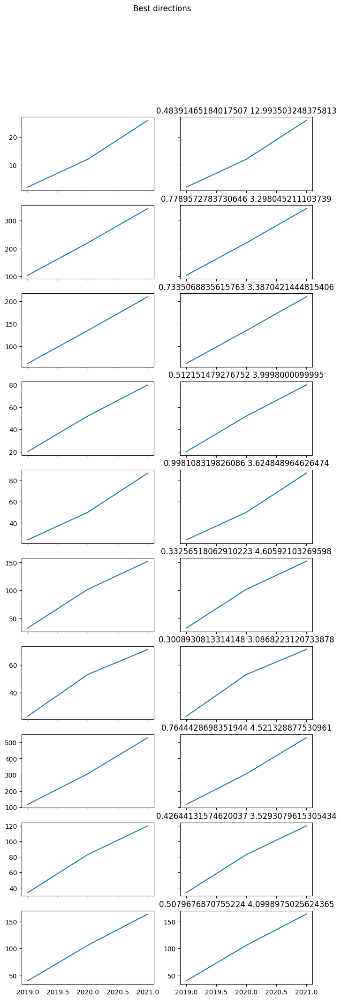

In [20]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

highs = []

for i,t in enumerate(sorted_topics[:10]):
    if t[0] not in progress_stat:    
        progress_stat[t[0]] = {}

    for y in range(2019,2022):
        if y not in progress_stat[t[0]]:
            progress_stat[t[0]][y] = 0

def mu(x, L, x0, k):
    return 4 * np.exp(-k * (x - x0)) / ((1+np.exp(-k * (x - x0)))**2)

fig, axs = plt.subplots(10,2, figsize=(8, 24))
fig.suptitle('Best directions')

def logistic_function(x, L, x0, k):
    return L / (1 + np.exp(-k * (x - x0)))

for i,t in enumerate(sorted_topics[:10]):
    years, vals = zip(*sorted(progress_stat[t[0]].items(),key=lambda x: x[0]))
    cum_vals = []
    last = 0
    for v in vals:
        last = v + last
        cum_vals.append(last)
    axs[i,0].plot(years, cum_vals)

    initial_guess = [max(cum_vals), np.median(years), 1]
    params, covariance = curve_fit(logistic_function, years, cum_vals, p0=initial_guess)
    L_fit, x0_fit, k_fit = params
    

    def func(L,x0,k):
        s = []
        for j in range(2019,2022):
            s.append(logistic_function(j, L, x0, k))
        return s   
    axs[i,1].plot(years, func(L_fit, x0_fit, k_fit))
    axs[i,1].set_title(str( mu(2021,L_fit, x0_fit, k_fit))+" " + str(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+0.001)))
    highs.append(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+1))
    if i < 9:
        axs[i,0].label_outer()
        axs[i,1].label_outer()

# 10 worst

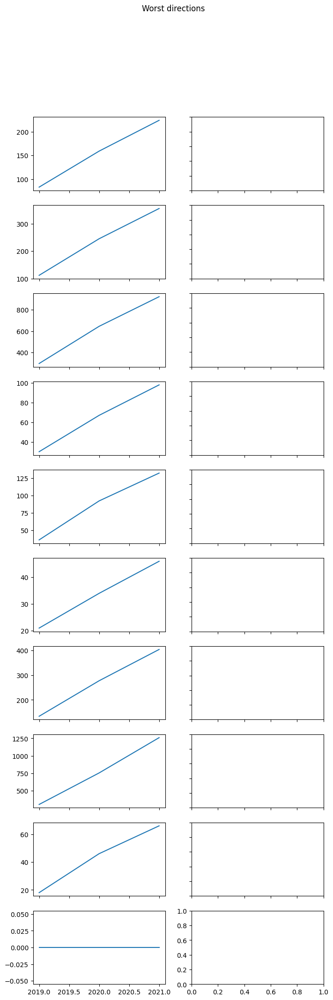

In [21]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(10,2, figsize=(8, 24))
fig.suptitle('Worst directions')

lows = []

def mu(x, L, x0, k):
    return 4 * np.exp(-k * (x - x0)) / ((1+np.exp(-k * (x - x0)))**2)

def logistic_function(x, L, x0, k):
    return L / (1 + np.exp(-k * (x - x0)))

for i,t in enumerate(sorted_topics[-10:]):
    if t[0] not in progress_stat:    
        progress_stat[t[0]] = {}

    for y in range(2019,2022):
        if y not in progress_stat[t[0]]:
            progress_stat[t[0]][y] = 0

for i,t in enumerate(sorted_topics[-10:]):
    years, vals = zip(*sorted(progress_stat[t[0]].items(),key=lambda x: x[0]))
    cum_vals = []
    last = 0
    for v in vals:
        last = v + last
        cum_vals.append(last)
    axs[i,0].plot(years, cum_vals)

    # initial_guess = [max(cum_vals), np.median(years), 1]
    # params, covariance = curve_fit(logistic_function, years, cum_vals, p0=initial_guess)
    # L_fit, x0_fit, k_fit = params
    

    # def func(L,x0,k):
    #     s = []
    #     for j in range(2017,2022):
    #         s.append(logistic_function(j, L, x0, k))
    #     return s   
    # axs[i,1].plot(years, func(L_fit, x0_fit, k_fit))
    # axs[i,1].set_title(str( mu(2021,L_fit, x0_fit, k_fit)) +" " + str(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+0.001)))

    lows.append(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+1)) 

    if i < 9:
        axs[i,0].label_outer()
        axs[i,1].label_outer()

In [22]:
from scipy.stats import mannwhitneyu

mannwhitneyu(highs,lows,method="exact")

MannwhitneyuResult(statistic=80.0, pvalue=0.023230639329710537)

In [23]:
# highs > lows 

In [24]:
mannwhitneyu(highs,lows,method="exact",alternative='greater')

MannwhitneyuResult(statistic=80.0, pvalue=0.011615319664855269)

In [25]:
highs,lows

([8.666666666666666,
  3.2666666666666666,
  3.3333333333333335,
  3.8095238095238093,
  3.48,
  4.470588235294118,
  2.9583333333333335,
  4.483050847457627,
  3.4285714285714284,
  4.0],
 [2.6666666666666665,
  3.1415929203539825,
  3.1077441077441077,
  3.161290322580645,
  3.5675675675675675,
  2.090909090909091,
  2.9851851851851854,
  4.158415841584159,
  3.473684210526316,
  0.0])

# Citation analysis

In [26]:
df = pd.read_excel("2019try.xlsx")

title2cite = {}
for i,row in df.iterrows():
    title = row["title"].lower().strip()
    title2cite[title] = int(row["cite"])

In [27]:
topic2cites = {}
for i,row in rews.iterrows():
    title = row['title'].lower().strip()
    content = row['text']
    _,_,tscore,tn = topic_model.query_topics(content, 1,reduced=True)
    cits = title2cite.get(title, 0) 
    if tn[0] not in topic2cites:
        topic2cites[tn[0]] = []
    topic2cites[tn[0]].append(cits)
    

## 10 best

In [28]:
highs_cite = []

for i,t in enumerate(sorted_topics[:10]):
    top_id = t[0]
    cites = topic2cites[top_id]
    avg_cites = np.asarray(cites).mean()
    highs_cite.append(avg_cites)

## 10 worst

In [29]:
lows_cite = []

for i,t in enumerate(sorted_topics[-10:]):
    top_id = t[0]
    cites = topic2cites[top_id]
    avg_cites = np.asarray(cites).mean()
    lows_cite.append(avg_cites)

In [30]:
highs_cite

[17.076923076923077,
 57.31578947368421,
 10.0,
 20.0,
 8.9,
 14.11111111111111,
 5.5,
 30.0,
 16.5,
 12.0]

In [31]:
lows_cite

[1.2,
 5.888888888888889,
 3.0,
 0.8275862068965517,
 5.25,
 1.6829268292682926,
 1.4,
 4.5,
 67.3529411764706,
 0.0]

In [32]:
mannwhitneyu(highs_cite,lows_cite,method="exact",alternative='greater')

MannwhitneyuResult(statistic=89.0, pvalue=0.0010446210136612613)

# Get topic scores with the classifier

In [33]:
import torch
import evaluate
from transformers import TrainingArguments, Trainer
from sklearn.model_selection import train_test_split
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.preprocessing import LabelEncoder
from datasets import Dataset, DatasetDict
import pandas as pd
from transformers import DataCollatorWithPadding
import numpy as np

#encoder = LabelEncoder()
#encoder.fit(dataset['label'])

In [35]:
scores = [int(row['score'][row['score'].rfind("#")+1:row["score"].rfind(":")]) for _,row in rews.iterrows()]
triple_scores = []
for score in scores:
    if score > 6:
        score = "high"
    else:
        if score > 4:
            score = "medium"
        else:
            score = "low"
    triple_scores.append(score)

In [36]:
encoder = LabelEncoder()
encoder.fit(triple_scores)

LabelEncoder()

In [37]:
list(encoder.inverse_transform([0, 1, 2]))

['high', 'low', 'medium']

In [38]:
%load_ext autoreload
%autoreload 2

import warnings
import torch
import evaluate
from transformers import TrainingArguments, Trainer
from sklearn.model_selection import train_test_split
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.preprocessing import LabelEncoder
from datasets import Dataset, DatasetDict
import pandas as pd
from transformers import DataCollatorWithPadding
import numpy as np


model_name = "roberta-base"

tokenizer = AutoTokenizer.from_pretrained(model_name)
device = "cpu"

def preprocess_function(examples):
    return tokenizer([str(e) for e in examples["text"]], truncation=True, max_length=512)

cls_model = AutoModelForSequenceClassification.from_pretrained("review_clf_model2question" + model_name + "/checkpoint-450",num_labels=3)

data_collator = DataCollatorWithPadding(
        tokenizer=tokenizer,
        padding='longest',
        max_length=512,
        pad_to_multiple_of=8,
        return_tensors='pt',
    )

device = "cpu"


# def compute_metrics(eval_pred):
#     predictions, labels = eval_pred
#     predictions = np.argmax(predictions, -1)
#     return accuracy.compute(predictions=predictions, references=labels)

training_args = TrainingArguments(
    output_dir="review_clf_model_without_NEW" + model_name,
    learning_rate=2e-5,
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    num_train_epochs=10,
    weight_decay=0.01, 
    warmup_ratio=0.15,
    max_grad_norm=1.0,    
    push_to_hub=False,
    no_cuda=True
)

trainer = Trainer(
   model=cls_model,
   args=training_args,
   tokenizer=tokenizer,
   data_collator=data_collator,
)
    

warnings.filterwarnings('ignore') 
    
from top2vec.Top2Vec.top2vec import Top2Vec

df =rews
dat = []
dists = []

top2score = {}
for i, row in df.iterrows():
    _,_,ts,tn = topic_model.query_topics(row["text"], 1,reduced = True)
    txt = row['review']
    qtags = row["review"].count("?")
 
    if qtags > 1:
        txt = "MANY_QUESTIONS" + " " + txt   
    
    tokens = tokenizer(txt, truncation=True)
    predictions = trainer.predict([tokens])
    lbl = np.argmax(predictions.predictions, axis=-1)    
    score = 0
    if lbl == 0:
        score = 2
    if lbl == 2:
        score = 1

    dists.append(ts[0])
    if tn[0] not in top2score:
        top2score[tn[0]] = []
    top2score[tn[0]].append(score)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [39]:
sorted_topics2 = sorted([[t,np.asarray(top2score[t]).mean(),len(top2score[t])] for t in top2score if len(top2score[t]) > 9],key=lambda x: x[1],reverse=True)

In [40]:
sorted_topics2

[[495, 1.5384615384615385, 13],
 [449, 1.5, 12],
 [447, 1.4166666666666667, 12],
 [403, 1.3846153846153846, 13],
 [419, 1.3333333333333333, 12],
 [333, 1.3125, 16],
 [397, 1.2777777777777777, 18],
 [474, 1.2777777777777777, 18],
 [238, 1.25, 12],
 [401, 1.25, 12],
 [353, 1.25, 12],
 [445, 1.25, 12],
 [472, 1.2222222222222223, 27],
 [345, 1.2, 15],
 [487, 1.1904761904761905, 21],
 [476, 1.1666666666666667, 12],
 [394, 1.1666666666666667, 12],
 [486, 1.1666666666666667, 36],
 [463, 1.16, 25],
 [480, 1.125, 16],
 [496, 1.1111111111111112, 18],
 [249, 1.105263157894737, 19],
 [450, 1.1, 30],
 [429, 1.1, 10],
 [427, 1.0952380952380953, 21],
 [343, 1.0833333333333333, 12],
 [231, 1.0833333333333333, 12],
 [421, 1.0833333333333333, 12],
 [459, 1.0833333333333333, 12],
 [433, 1.0833333333333333, 12],
 [355, 1.0810810810810811, 37],
 [299, 1.0666666666666667, 15],
 [432, 1.0666666666666667, 15],
 [411, 1.0666666666666667, 15],
 [225, 1.0666666666666667, 15],
 [342, 1.0588235294117647, 34],
 [44

# 10 best

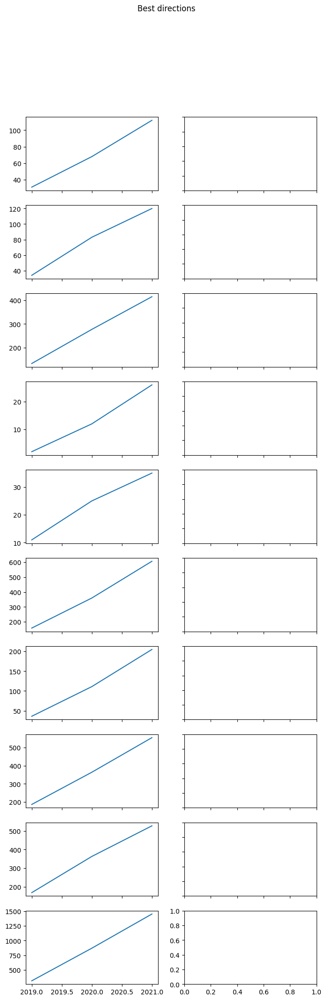

In [45]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

highs = []

for i,t in enumerate(sorted_topics2[:10]):
    if t[0] not in progress_stat:    
        progress_stat[t[0]] = {}

    for y in range(2019,2022):
        if y not in progress_stat[t[0]]:
            progress_stat[t[0]][y] = 0

def mu(x, L, x0, k):
    return 4 * np.exp(-k * (x - x0)) / ((1+np.exp(-k * (x - x0)))**2)

fig, axs = plt.subplots(10,2, figsize=(8, 24))
fig.suptitle('Best directions')

def logistic_function(x, L, x0, k):
    return L / (1 + np.exp(-k * (x - x0)))

for i,t in enumerate(sorted_topics2[:10]):
    years, vals = zip(*sorted(progress_stat[t[0]].items(),key=lambda x: x[0]))
    cum_vals = []
    last = 0
    for v in vals:
        last = v + last
        cum_vals.append(last)
    axs[i,0].plot(years, cum_vals)

    # initial_guess = [max(cum_vals), np.median(years), 1]
    # params, covariance = curve_fit(logistic_function, years, cum_vals, p0=initial_guess)
    # L_fit, x0_fit, k_fit = params
    

    # def func(L,x0,k):
    #     s = []
    #     for j in range(2017,2022):
    #         s.append(logistic_function(j, L, x0, k))
    #     return s   
    # axs[i,1].plot(years, func(L_fit, x0_fit, k_fit))
    # axs[i,1].set_title(str( mu(2021,L_fit, x0_fit, k_fit))+" " + str(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+0.001)))
    highs.append(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+1))
    if i < 9:
        axs[i,0].label_outer()
        axs[i,1].label_outer()

# 10 worst

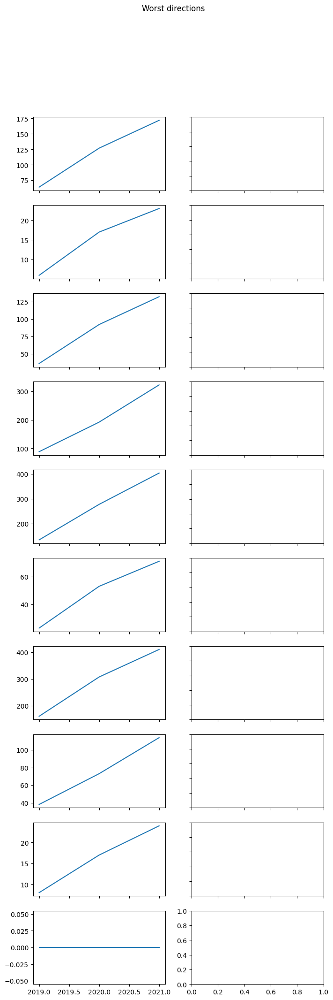

In [46]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(10,2, figsize=(8, 24))
fig.suptitle('Worst directions')

lows = []

def mu(x, L, x0, k):
    return 4 * np.exp(-k * (x - x0)) / ((1+np.exp(-k * (x - x0)))**2)

def logistic_function(x, L, x0, k):
    return L / (1 + np.exp(-k * (x - x0)))

for i,t in enumerate(sorted_topics2[-10:]):
    if t[0] not in progress_stat:    
        progress_stat[t[0]] = {}

    for y in range(2019,2022):
        if y not in progress_stat[t[0]]:
            progress_stat[t[0]][y] = 0

for i,t in enumerate(sorted_topics2[-10:]):
    years, vals = zip(*sorted(progress_stat[t[0]].items(),key=lambda x: x[0]))
    cum_vals = []
    last = 0
    for v in vals:
        last = v + last
        cum_vals.append(last)
    axs[i,0].plot(years, cum_vals)

    # initial_guess = [max(cum_vals), np.median(years), 1]
    # params, covariance = curve_fit(logistic_function, years, cum_vals, p0=initial_guess)
    # L_fit, x0_fit, k_fit = params
    

    # def func(L,x0,k):
    #     s = []
    #     for j in range(2017,2022):
    #         s.append(logistic_function(j, L, x0, k))
    #     return s   
    # axs[i,1].plot(years, func(L_fit, x0_fit, k_fit))
    # axs[i,1].set_title(str( mu(2021,L_fit, x0_fit, k_fit)) +" " + str(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+0.001)))

    lows.append(float(cum_vals[len(cum_vals) - 1])/(cum_vals[0]+1)) 

    if i < 9:
        axs[i,0].label_outer()
        axs[i,1].label_outer()

In [47]:
mannwhitneyu(highs,lows,method="exact",alternative='greater')

MannwhitneyuResult(statistic=79.0, pvalue=0.014402779882656043)

In [44]:
highs,lows

([],
 [2.646153846153846,
  3.2857142857142856,
  3.5675675675675675,
  3.6292134831460676,
  2.9851851851851854,
  2.9583333333333335,
  2.537037037037037,
  2.923076923076923,
  2.6666666666666665,
  0.0])

## citations with cls

In [48]:
highs_cite = []

for i,t in enumerate(sorted_topics2[:10]):
    top_id = t[0]
    cites = topic2cites[top_id]
    avg_cites = np.asarray(cites).mean()
    highs_cite.append(avg_cites)

lows_cite = []

for i,t in enumerate(sorted_topics2[-10:]):
    top_id = t[0]
    cites = topic2cites[top_id]
    avg_cites = np.asarray(cites).mean()
    lows_cite.append(avg_cites)

mannwhitneyu(highs_cite,lows_cite,method="exact",alternative='greater')

MannwhitneyuResult(statistic=75.5, pvalue=0.03150641927731711)